In [1]:
!hostname

gnode014.cluster


In [2]:
!nvidia-smi

Sat Feb  3 14:20:21 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 545.23.08              Driver Version: 545.23.08    CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA H100 PCIe               Off | 00000000:A8:00.0 Off |                    0 |
| N/A   32C    P0              49W / 350W |      4MiB / 81559MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [3]:
import itertools as it
import pickle
import torch
import torch.nn as nn
import torch.optim as optim
import torch.fft
import torch.nn.functional as F
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sdeint
from toolbox import (
    make_loss,
    StatLoss,
    SINN,
    FPU
)
import time

In [4]:
torch.cuda.is_available()

True

In [5]:
device = torch.device('cuda')

In [6]:
print(torch.__version__)
print(torch.version.cuda)

2.0.1+cu118
11.8


In [7]:
seed = 1234
torch.set_default_dtype(torch.float)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
np.random.seed(seed)

200.0
(1000, 400) (1000, 400)
(400, 400) (400, 400) (400, 400)
(400, 400, 2)
CPU times: user 1.88 s, sys: 5.68 ms, total: 1.89 s
Wall time: 1.9 s


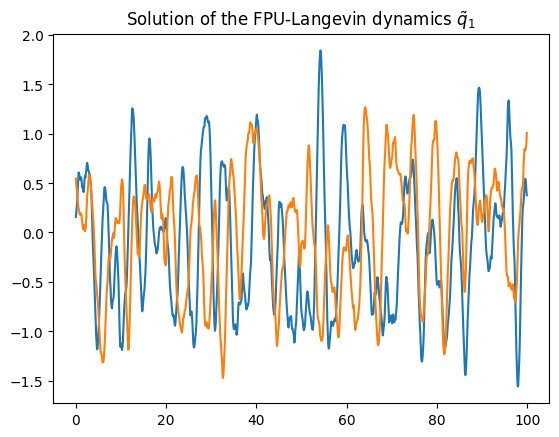

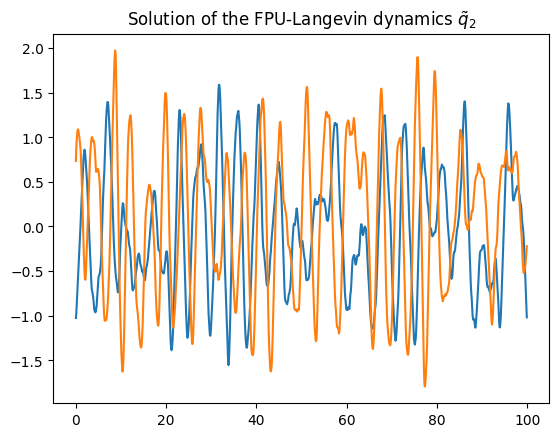

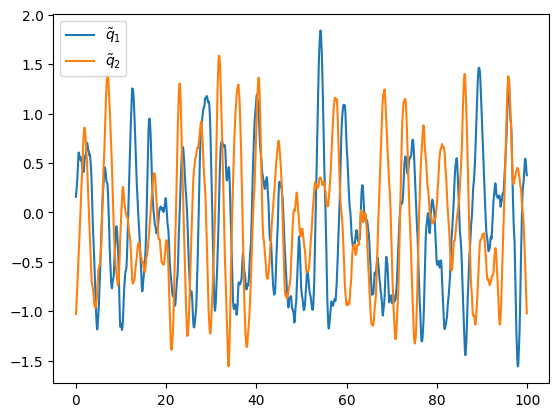

In [8]:
%%time

#### Generating SINN training data by solving SDE (Langevin dynamics)
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from scipy.integrate import quad


def V_FPU(x,U0,x0):
    v=U0/x0**4*x**3+U0/x0**2*x      # FPU potential 
    return v


#### Parameters 
gamma1 = 1                             # coupling constant 
gamma2 = .5                            # coupling constant
beta = 1                               # Inverse temperature, i.e. T=1/beta
dt = 0.01                              # Step-size of the SDE solver 
delta_t = 0.1                          # Step-size of the temporally coarse-grained path
batch = 400                           # Batch size 
sec_length = 400                       # Length of the input sequence 
U0 = 1                                 # FPU parameter, depth of the well 
x0 = 1                                 # FPU parameter, position of the basin 
rho = 0.00                             # Correlation of q1 and q2 

#### SDE solver (EM scheme) 
Time = 5*delta_t*sec_length
print(Time)
length=int(Time/dt)+1
t = np.linspace(0,Time,length) # define time axis
gap=int(delta_t/dt)
t_store=t[0:-1:gap]
q1_store = np.zeros([t_store.size+1,batch])
q2_store = np.zeros([t_store.size+1,batch])
# q_store = np.zeros([t_store.size+1,batch])
p1=np.zeros((2,batch))
p2=np.zeros((2,batch))
q1=np.zeros((2,batch))
q2=np.zeros((2,batch))

# solve SDE
j=1
for i in range(1,length):
     q1[1,:] = q1[0,:] + p1[0,:]*dt
     p1[1,:] = p1[0,:] + (-V_FPU(q1[0,:],U0,x0)-gamma1*p1[0,:])*dt + np.random.randn(1,batch)*np.sqrt(2*dt*gamma1/beta)
     q2[1,:] = q2[0,:] + p2[0,:]*dt
     p2[1,:] = p2[0,:] + (-V_FPU(q2[0,:],U0,x0)-gamma2*p2[0,:])*dt + np.random.randn(1,batch)*np.sqrt(2*dt*gamma2/beta)
     if i % gap ==0:            
            q1_store[j,:]=q1[1,:]
            q2_store[j,:]=rho*q1[1,:]+np.sqrt(1-rho**2)*q2[1,:]
            j=j+1
     p1[0,:]=p1[1,:]
     q1[0,:]=q1[1,:]
     p2[0,:]=p2[1,:]
     q2[0,:]=q2[1,:]

Toss=int(t_store.size/2)         
q1_store=q1_store[Toss:-1,:]         
q2_store=q2_store[Toss:-1,:]    
print(q1_store.shape,q2_store.shape)




plt.figure(0)
for i in range(2):
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,i])
plt.title(r"Solution of the FPU-Langevin dynamics $\tilde{q}_1$")
# plt.savefig("figs/FPU_dt016.pdf", dpi=150)

plt.figure(1)
for i in range(2):
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,i])
plt.title(r"Solution of the FPU-Langevin dynamics $\tilde{q}_2$")

plt.figure(2)
plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0], label=r'$\tilde{q}_1$')
plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0], label=r'$\tilde{q}_2$')
# plt.title("Solution of the FPU-Langevin dynamics")
plt.legend()
# Construct the sample traj for SINN learning 
ini=np.random.randn(sec_length,batch)
Traj_q1=q1_store[0:sec_length,:]
Traj_q2=q2_store[0:sec_length,:]
print(ini.shape, Traj_q1.shape, Traj_q2.shape)

Traj = np.empty((sec_length,batch,2))
Traj[:,:,0] = Traj_q1
Traj[:,:,1] = Traj_q2
T=np.arange(len(Traj_q1[:,1]))*delta_t
x=np.linspace(-5,5,sec_length)
print(Traj.shape)

# 2 input

In [9]:
# Reformulating data into Torch tensors 
# Input of SINN should be of the form (seq_len, batch, input_size)

ini = np.random.randn(2*sec_length,2*batch).astype(np.float32) 
input = torch.from_numpy(ini.reshape(2*sec_length, batch, 2)).to(device)
batch_validation = batch
val_set = torch.normal(0.0, 1.0, (2*sec_length, batch_validation, 2), device=device)


Traj = Traj.astype(np.float32) 
target = torch.from_numpy(Traj.reshape(sec_length, batch, 2)).to(device)
print('The torch input size is', input.size(), input.dtype)
print('The torch validation size is', val_set.size(), val_set.dtype)
print('The torch target size is', target.size(), target.dtype)

The torch input size is torch.Size([800, 400, 2]) torch.float32
The torch validation size is torch.Size([800, 400, 2]) torch.float32
The torch target size is torch.Size([400, 400, 2]) torch.float32


(array([-3., -2., -1.,  0.,  1.,  2.,  3.]),
 [Text(0, -3.0, '−3'),
  Text(0, -2.0, '−2'),
  Text(0, -1.0, '−1'),
  Text(0, 0.0, '0'),
  Text(0, 1.0, '1'),
  Text(0, 2.0, '2'),
  Text(0, 3.0, '3')])

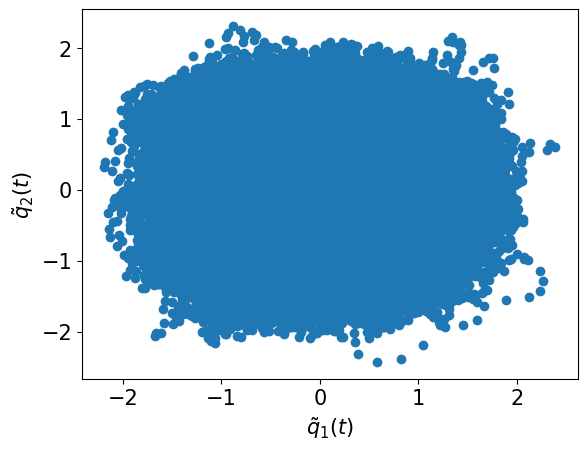

In [10]:
plt.scatter(Traj[:,:,0], Traj[:,:,1])
plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

In [11]:
# Defining Loss functions
LAGS = 400
N = 400
loss_acf_fft = make_loss('acf[fft]', target, lags=LAGS, device=device)
loss_acf_sec_moment = make_loss('acf[fft]', target**2, lags=LAGS, device=device)
loss_acf_bruteforce = make_loss('acf[bruteforce]', target, lags=LAGS, device=device)
loss_acf_randbrute = make_loss('acf[randombrute]', target, lags=LAGS, sample_lags=20, device=device)

loss_ccf_fft = make_loss('ccf[fft]', target, lags=LAGS, device=device)
loss_ccf_sec_moment = make_loss('ccf[fft]', target**2, lags=LAGS, device=device)
loss_ccf_bruteforce = make_loss('ccf[bruteforce]', target, lags=LAGS, device=device)
loss_ccf_randbrute = make_loss('ccf[randombrute]', target, lags=LAGS, sample_lags=20, device=device)

loss_pdf_empirical1 = make_loss('pdf', target, lower=-5, upper=5, n=N, bw=None, device=device)
loss_pdf_empirical2 = make_loss('pdf6', target, lower=-5, upper=5, n=N, bw=None, device=device)
loss_pdf_empirical2D = make_loss('pdf2D', target, lower=-5, upper=5, n=N, bw=None, device=device)

torch.Size([400, 2])


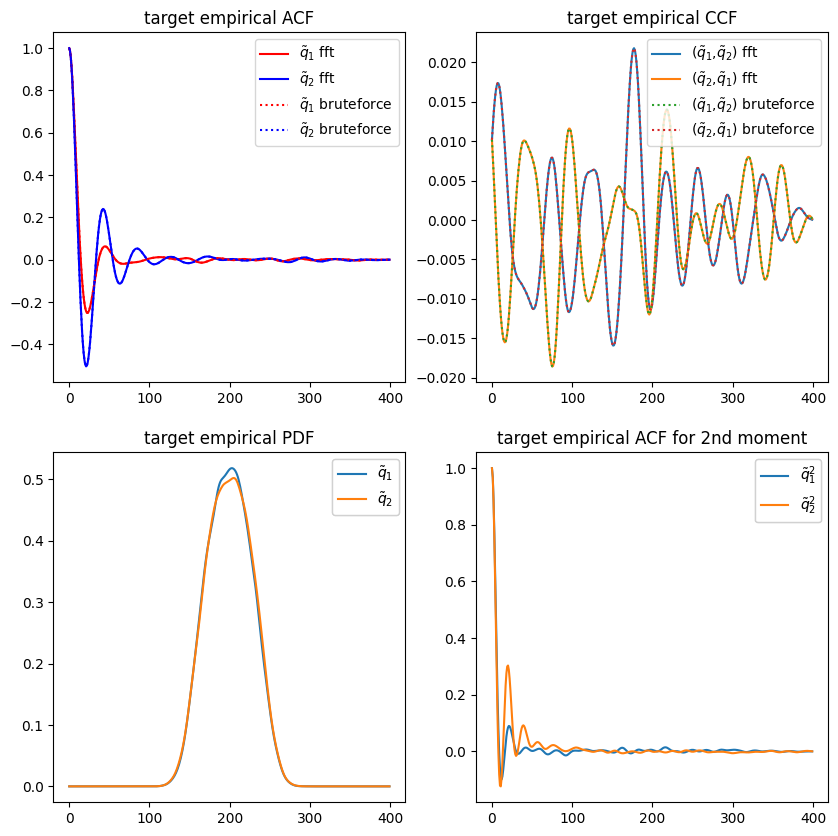

In [12]:
# Plotting target ACFs and PDF
fig, axs = plt.subplots(2, 2, figsize=(10, 10))
axs[0,0].plot(loss_acf_fft._target.cpu()[...,0],'r', label=r'$\tilde{q}_1$ fft')
axs[0,0].plot(loss_acf_fft._target.cpu()[...,-1],'b', label=r'$\tilde{q}_2$ fft')
axs[0,0].plot(loss_acf_bruteforce._target.cpu()[...,0],'r:', label= r'$\tilde{q}_1$ bruteforce')
axs[0,0].plot(loss_acf_bruteforce._target.cpu()[...,1], 'b:', label=r'$\tilde{q}_2$ bruteforce')
axs[0,0].legend()
axs[0,0].set_title('target empirical ACF')

axs[0,1].plot(loss_ccf_fft._target.cpu()[...,0], label=r'($\tilde{q}_1$,$\tilde{q}_2$) fft')
axs[0,1].plot(loss_ccf_fft._target.cpu()[...,1], label=r'($\tilde{q}_2$,$\tilde{q}_1$) fft')
axs[0,1].plot(loss_ccf_bruteforce._target.cpu()[...,0],':',label=r'($\tilde{q}_1$,$\tilde{q}_2$) bruteforce')
axs[0,1].plot(loss_ccf_bruteforce._target.cpu()[...,1],':',label=r'($\tilde{q}_2$,$\tilde{q}_1$) bruteforce')
# legend2 = axs[0,1].legend(iter(bf), ('q bf', 'p bf'), loc=1)
# axs[0,1].add_artist(legend2)
axs[0,1].legend()
axs[0,1].set_title('target empirical CCF')

x_grid=-np.linspace(-5,5,num=sec_length)
pdf = axs[1,0].plot(loss_pdf_empirical1._target.cpu())
legend3 = axs[1,0].legend(iter(pdf), (r'$\tilde{q}_1$', r'$\tilde{q}_2$'), loc=1)
axs[1,0].add_artist(legend3)
axs[1,0].set_title('target empirical PDF')


print(loss_acf_sec_moment._target.cpu().size())
sec_moment = axs[1,1].plot(loss_acf_sec_moment._target.cpu())
legend4 = axs[1,1].legend(iter(sec_moment), (r'$\tilde{q}_1^2$', r'$\tilde{q}_2^2$'),loc=1)
axs[1,1].set_title('target empirical ACF for 2nd moment')
axs[1,1].add_artist(legend4)

plt.show()

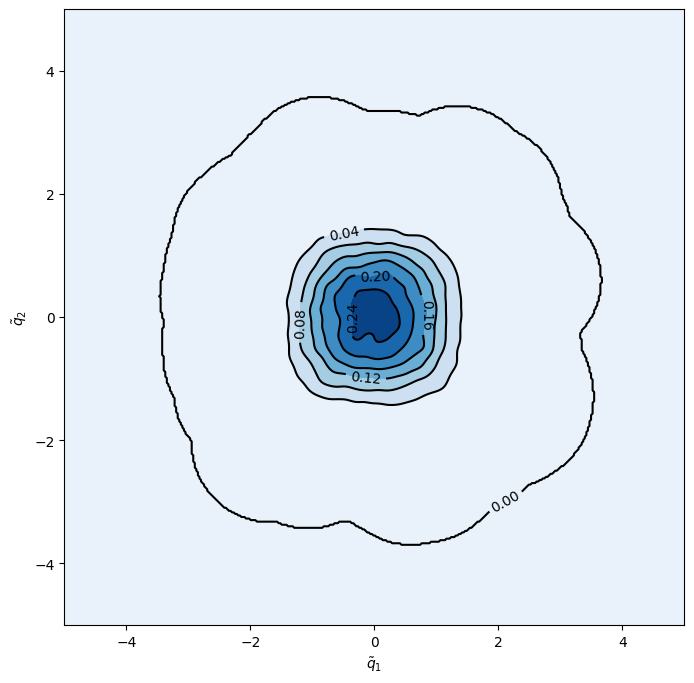

In [13]:
xmin, xmax = -5, 5
ymin, ymax = -5, 5

xx, yy = np.mgrid[xmin:xmax:400j, ymin:ymax:400j]
fig = plt.figure(figsize=(8, 8))
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# Contourf plot
cfset = ax.contourf(xx, yy, loss_pdf_empirical2D._target.cpu(), cmap='Blues')
## Or kernel density estimate plot instead of the contourf plot

# Contour plot
cset = ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), colors='k')
# Label plot
ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel(r'$\tilde{q}_1$')
ax.set_ylabel(r'$\tilde{q}_2$')

plt.show()

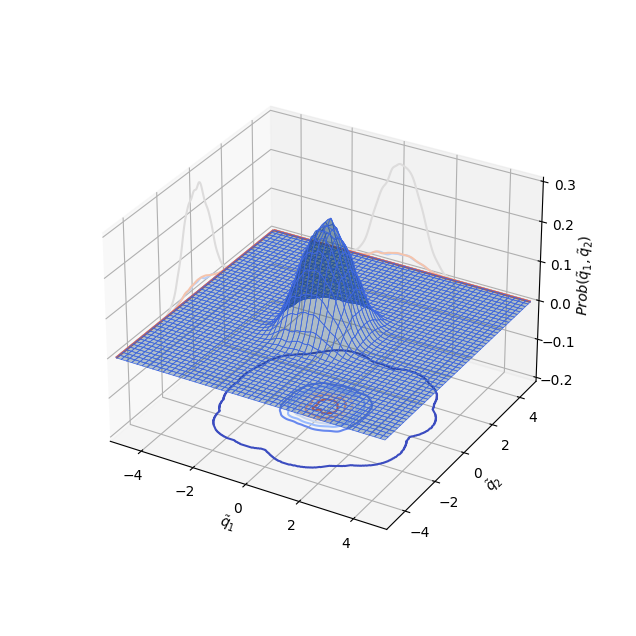

In [14]:
from mpl_toolkits.mplot3d import axes3d

ax = plt.figure(figsize=(8, 8)).add_subplot(projection='3d')
# fig = plt.figure()
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
ax.plot_surface(xx, yy, loss_pdf_empirical2D._target.cpu(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='z', offset=-0.2, cmap='coolwarm')
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='x', offset=-5, cmap='coolwarm')
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='y', offset=5, cmap='coolwarm')

ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'$Prob(\tilde{q}_1,\tilde{q}_2)$')
ax.set_box_aspect(aspect=None, zoom=0.8)
plt.show()

Text(0.5, 1.0, 'target empirical PDF')

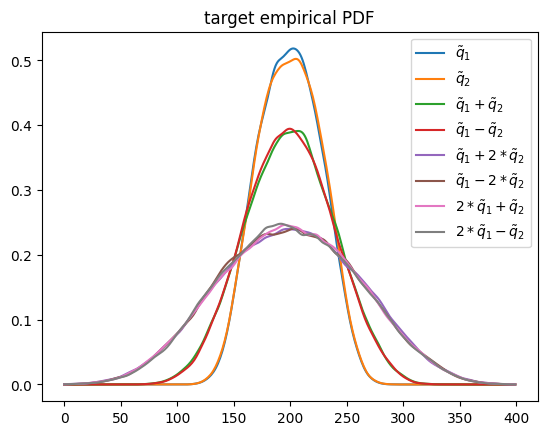

In [15]:
x_grid=-np.linspace(-5,5,num=sec_length)
plt.plot(loss_pdf_empirical1._target.cpu()[...,0],label=r'$\tilde{q}_1$')
plt.plot(loss_pdf_empirical1._target.cpu()[...,1],label=r'$\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,0],label=r'$\tilde{q}_1+\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,1],label=r'$\tilde{q}_1-\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,2],label=r'$\tilde{q}_1+2*\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,3],label=r'$\tilde{q}_1-2*\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,4],label=r'$2*\tilde{q}_1+\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,5],label=r'$2*\tilde{q}_1-\tilde{q}_2$')
plt.legend()
plt.title('target empirical PDF')

## 1.3. Loss function=CCF($\textbf{x}$)+PDF($\textbf{x}$)+ACF($\textbf{x}^2$)

In [16]:
class Model:
    def __init__(self, net):

        self.x_acf_s = None
        self.x_ccf_s = None
        self.x_pdf_s = None
        self.x_pdf2_s = None
        self.x_acf2_s = None
        self.s_collect = []

        self.net = net

        self.T_error=[]
        self.V_error=[]
        self.T_ccf=[]
        self.V_ccf=[]
        self.T_pdf=[]
        self.V_pdf=[]
        self.T_pdf2=[]
        self.V_pdf2=[]
        self.T_acf=[]
        self.V_acf=[]
        self.T_acf2=[]
        self.V_acf2=[]
        self.Step=[]
        self.iter = 0

    def train_U(self, x):
        return self.net(x)

    def predict_U(self, x):
        return self.train_U(x)

    def likelihood_loss(self, loss_acf, loss_ccf, loss_pdf, loss_pdf2, loss_acf2):
        loss = torch.reciprocal(2. * self.x_acf_s ** 2) * loss_acf.detach()      \
               + torch.reciprocal(2. * self.x_ccf_s ** 2) * loss_ccf.detach()    \
               + torch.reciprocal(2. * self.x_pdf_s ** 2) * loss_pdf.detach()    \
               + torch.reciprocal(2. * self.x_pdf2_s ** 2) * loss_pdf2.detach()  \
               + torch.reciprocal(2. * self.x_acf2_s ** 2) * loss_acf2.detach()  \
               + torch.log(self.x_acf_s * self.x_ccf_s * self.x_pdf_s * self.x_pdf2_s * self.x_acf2_s)
        return loss

    def true_loss(self, loss_acf, loss_ccf, loss_pdf, loss_pdf2, loss_acf2):
        return torch.reciprocal(2. * self.x_acf_s.detach() ** 2) * loss_acf + torch.reciprocal(2. * self.x_ccf_s.detach() ** 2) * loss_ccf + torch.reciprocal(2. * self.x_pdf_s.detach() ** 2) * loss_pdf + torch.reciprocal(2. * self.x_pdf2_s.detach() ** 2) * loss_pdf2 + torch.reciprocal(2. * self.x_acf2_s.detach() ** 2) * loss_acf2

    def run_baseline(self):
        optimizer_adam = optim.Adam(self.net.parameters(), lr=1e-3)
        for step in range(20000):
            optimizer_adam.zero_grad()
            ini = np.random.randn(2*sec_length, batch*self.net.lstm.input_size).astype(np.float32) 
            input = torch.from_numpy(ini.reshape(2*sec_length, batch, self.net.lstm.input_size)).to(device)
            prediction, _ = self.train_U(input)
            prediction = prediction[-LAGS:,:,:]
            loss = loss_acf_fft(prediction)+ loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
            loss.backward()
            optimizer_adam.step()
            self.iter += 1
            if step % 50 == 0: 
                with torch.no_grad():
                    loss = loss_acf_fft(prediction)+loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
                    pred_val, _ = self.predict_U(val_set)
                    pred_val = pred_val[-LAGS:,:,:]
                    loss_val = loss_acf_bruteforce(pred_val)+loss_ccf_bruteforce(pred_val)+ loss_pdf_empirical1(pred_val)+ loss_pdf_empirical2(pred_val) + loss_acf_sec_moment(pred_val**2)
                    acf = loss_acf_bruteforce(pred_val)
                    ccf = loss_ccf_bruteforce(pred_val)
                    pdf = loss_pdf_empirical1(pred_val)
                    pdf2 = loss_pdf_empirical2(pred_val)
                    acf_sec_moment = loss_acf_sec_moment(pred_val**2)
                    print('[%d]-th step loss: %.4f, %.4f, acf: %.5f, ccf: %.5f, pdf: %.5f, pdf2: %.5f, acf2: %.5f' % (step, loss, loss_val, acf, ccf, pdf, pdf2, acf_sec_moment))
                    self.T_acf.append(loss_acf_fft(prediction).detach().cpu().numpy())
                    self.V_acf.append(loss_acf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_ccf.append(loss_ccf_fft(prediction).detach().cpu().numpy())
                    self.V_ccf.append(loss_ccf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_pdf.append(loss_pdf_empirical1(prediction).detach().cpu().numpy())
                    self.V_pdf.append(loss_pdf_empirical1(pred_val).detach().cpu().numpy())
                    self.T_pdf2.append(loss_pdf_empirical2(prediction).detach().cpu().numpy())
                    self.V_pdf2.append(loss_pdf_empirical2(pred_val).detach().cpu().numpy())
                    self.T_acf2.append(loss_acf_sec_moment(prediction**2).detach().cpu().numpy())
                    self.V_acf2.append(loss_acf_sec_moment(pred_val**2).detach().cpu().numpy())
                    self.T_error.append(loss.detach().cpu().numpy())
                    self.V_error.append(loss_val.detach().cpu().numpy())
                    self.Step.append(step)
            if loss <=0.0003 and loss_val <=0.0003:
                break

        if loss > 0.0003 and loss_val > 0.0003:
            print ('Training failed')
        print('Training finished')



    def run_AW(self):
        self.x_acf_s = nn.Parameter(self.x_acf_s, requires_grad=True)
        self.x_ccf_s = nn.Parameter(self.x_ccf_s, requires_grad=True)
        self.x_pdf_s = nn.Parameter(self.x_pdf_s, requires_grad=True)
        self.x_pdf2_s = nn.Parameter(self.x_pdf2_s, requires_grad=True)
        self.x_acf2_s = nn.Parameter(self.x_acf2_s, requires_grad=True)


        optimizer_adam = optim.Adam(self.net.parameters(), lr=1e-3)
        optimizer_adam_weight = optim.Adam([self.x_acf_s] + [self.x_ccf_s] + [self.x_pdf_s] + [self.x_pdf2_s] + [self.x_acf2_s],
                                                     lr=1e-3)

        for step in range(20000):
            self.s_collect.append([self.iter, self.x_acf_s.item(), self.x_ccf_s.item(), self.x_pdf_s.item(), self.x_pdf2_s.item(), self.x_acf2_s.item()])

            optimizer_adam.zero_grad()
            ini = np.random.randn(2*sec_length, batch*self.net.lstm.input_size).astype(np.float32) 
            input = torch.from_numpy(ini.reshape(2*sec_length, batch, self.net.lstm.input_size)).to(device)
            prediction, _ = self.train_U(input)
            prediction = prediction[-LAGS:,:,:]
            loss = self.true_loss(loss_acf_fft(prediction), loss_ccf_fft(prediction),loss_pdf_empirical1(prediction),loss_pdf_empirical2(prediction),loss_acf_sec_moment(prediction**2))
            loss.backward()
            optimizer_adam.step()
            self.iter += 1
            if step % 50 == 0: 
                with torch.no_grad():
                    loss = loss_acf_fft(prediction)+loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
                    pred_val, _ = self.predict_U(val_set)
                    pred_val = pred_val[-LAGS:,:,:]
                    loss_val = loss_acf_bruteforce(pred_val)+loss_ccf_bruteforce(pred_val)+ loss_pdf_empirical1(pred_val) + loss_pdf_empirical2(pred_val) + loss_acf_sec_moment(pred_val**2)
                    acf = loss_acf_bruteforce(pred_val)
                    ccf = loss_ccf_bruteforce(pred_val)
                    pdf = loss_pdf_empirical1(pred_val)
                    pdf2 = loss_pdf_empirical2(pred_val)
                    acf_sec_moment = loss_acf_sec_moment(pred_val**2)
                    print('[%d]-th step loss: %.4f, %.4f, acf: %.5f, ccf: %.5f, pdf: %.5f, pdf2: %.5f, acf2: %.5f' % (step, loss, loss_val, acf, ccf, pdf, pdf2, acf_sec_moment))
                    self.T_acf.append(loss_acf_fft(prediction).detach().cpu().numpy())
                    self.V_acf.append(loss_acf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_ccf.append(loss_ccf_fft(prediction).detach().cpu().numpy())
                    self.V_ccf.append(loss_ccf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_pdf.append(loss_pdf_empirical1(prediction).detach().cpu().numpy())
                    self.V_pdf.append(loss_pdf_empirical1(pred_val).detach().cpu().numpy())
                    self.T_pdf2.append(loss_pdf_empirical2(prediction).detach().cpu().numpy())
                    self.V_pdf2.append(loss_pdf_empirical2(pred_val).detach().cpu().numpy())
                    self.T_acf2.append(loss_acf_sec_moment(prediction**2).detach().cpu().numpy())
                    self.V_acf2.append(loss_acf_sec_moment(pred_val**2).detach().cpu().numpy())
                    self.T_error.append(loss.detach().cpu().numpy())
                    self.V_error.append(loss_val.detach().cpu().numpy())
                    self.Step.append(step)
            if loss <=0.0003 and loss_val <=0.0003:
                break
            optimizer_adam_weight.zero_grad()
            loss = self.likelihood_loss(loss_acf_fft(prediction), loss_ccf_fft(prediction),loss_pdf_empirical1(prediction),loss_pdf_empirical2(prediction),loss_acf_sec_moment(prediction**2))
            loss.backward()
            optimizer_adam_weight.step()
            
        if loss > 0.0003 and loss_val > 0.0003:
            print ('Training failed')
        print('Training finished')


    def train(self):
        self.x_acf_s = torch.tensor(2.).float()
        self.x_ccf_s = torch.tensor(2.).float()
        self.x_pdf_s = torch.tensor(2.).float()
        self.x_pdf2_s = torch.tensor(2.).float()
        self.x_acf2_s = torch.tensor(2.).float()
        start_time = time.time()
        if model_type == 0:
            self.run_baseline()
        elif model_type == 1:
            self.run_AW()
        elapsed = time.time() - start_time
        print('Training time: %.2f' % elapsed)
        avg_time = elapsed/self.iter
        print('Training time per iteration: %.2f' % avg_time)
        print('Number of Iterations:%d' %self.iter)

In [17]:
def draw_loss(model):
    ### Plotting the training and the generalization error
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Error plot",fontsize=15) 
    plt.yscale('log')
    plt.plot(model.Step, model.T_error,'r',label='Training error')
    plt.plot(model.Step, model.V_error,'b--',label='Validation error')
#     plt.loglog(model.Step, model.T_error,'r',label='Training error')
#     plt.loglog(model.Step, model.V_error,'b--',label='Validation error')
    plt.xlabel(r'Training times $n$',fontsize=15)
    plt.ylabel(r'$l_1+l_2$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)

In [18]:
def draw_errors(model):
    ### Plotting the training and the generalization error
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Error plot for loss functions w/o coeff",fontsize=15)
    plt.yscale('log')
    plt.plot(model.Step, model.T_error,'k',label='Training error')
    plt.plot(model.Step, model.V_error,'k--')
    plt.plot(model.Step, model.T_acf,'r',label='acf error')
    plt.plot(model.Step, model.V_acf,'r--')
    plt.plot(model.Step, model.T_ccf,'b',label='ccf error')
    plt.plot(model.Step, model.V_ccf,'b--')
    plt.plot(model.Step, model.T_pdf,'y',label='pdf error')
    plt.plot(model.Step, model.V_pdf,'y--')
    plt.plot(model.Step, model.T_pdf2,'m',label=r'$pdf_{combo}$ error')
    plt.plot(model.Step, model.V_pdf2,'m--')
    plt.plot(model.Step, model.T_acf2,'g',label=r'$acf(\tilde{q}^2)$ error')
    plt.plot(model.Step, model.V_acf2,'g--')
    
#     plt.loglog(model.Step, model.T_error,'k',label='Training error')
#     plt.loglog(model.Step, model.V_error,'k--')
#     plt.loglog(model.Step, model.T_acf,'r',label='acf error')
#     plt.loglog(model.Step, model.V_acf,'r--')
#     plt.loglog(model.Step, model.T_ccf,'b',label='ccf error')
#     plt.loglog(model.Step, model.V_ccf,'b--')
#     plt.loglog(model.Step, model.T_pdf,'y',label='pdf error')
#     plt.loglog(model.Step, model.V_pdf,'y--')
#     plt.loglog(model.Step, model.T_pdf2,'m',label='pdf2 error')
#     plt.loglog(model.Step, model.V_pdf2,'m--')
#     plt.loglog(model.Step, model.T_acf2,'g',label='acf2 error')
#     plt.loglog(model.Step, model.V_acf2,'g--')
    plt.xlabel(r'Training times $n$',fontsize=15)
    plt.ylabel(r'$l_1+l_2$',fontsize=15)
    plt.legend(frameon=False,fontsize=15, bbox_to_anchor=(1.1, 1.05))

In [19]:
def draw_adaptive_w(model):
    s_collect = np.array(model.s_collect)
    np.savetxt('s_RAM-AW.npy', s_collect)
    plt.plot(s_collect[:, 0], s_collect[:, 1], 'r-', label=r'$\epsilon_{acf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 2], 'b-', label='$\epsilon_{ccf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 3], 'y-', label='$\epsilon_{pdf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 4], 'g-', label='$\epsilon_{acf2}$')
    plt.plot(s_collect[:, 0], s_collect[:, 5], 'c-', label='$\epsilon_{ccf2}$')
    plt.xlabel('$Iters$')
    plt.ylabel('$s$')
    plt.legend()
    plt.show()

In [20]:
def draw_epoch_w(model):
    s_collect = np.array(model.s_collect)
    np.savetxt('s_RAM-AW.npy', s_collect)
    plt.yscale('log')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 1]**2), 'r-', label=r'$\frac{1}{2\epsilon_{acf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 2]**2), 'b-', label=r'$\frac{1}{2\epsilon_{ccf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 3]**2), 'y-', label=r'$\frac{1}{2\epsilon_{pdf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 4]**2), 'g-', label=r'$\frac{1}{2\epsilon_{acf2}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 5]**2), 'c-', label=r'$\frac{1}{2\epsilon_{ccf2}^2}$')
    plt.xlabel('$Iters$')
    plt.ylabel('$\omega$')
    plt.legend()
#     plt.savefig('2dpossion_S_RAM-AW.pdf')
    plt.show()

In [21]:
def test1(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    # Test 1: plot the sample path generated by SINN and the exact sample path 
    skip = 0

    fig = plt.figure(0)
    plt.title("MD trajectories",fontsize=15) 
    plt.plot(T[skip:]-T[skip], Traj[skip:, 0])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$ and $\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15) 


    fig = plt.figure(1)
    plt.title("SINN trajectories",fontsize=15)    
    plt.plot(T[skip:]-T[skip], prediction[skip:, 0])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$q_1(t)$ and $q_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [22]:
def test2(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    
    # Test 2: plot the CCF of the sample path generated by the SINN and the exact CCF  
    acf_p=StatLoss.acf(Pred[-sec_length:,:,:])
    acf_t=StatLoss.acf(target)
    corr_p1=acf_p.detach().cpu().numpy()
    corr_t1=acf_t.detach().cpu().numpy()
    ccf_p=StatLoss.ccf(Pred[-sec_length:,:,:])
    ccf_t=StatLoss.ccf(target)
    corr_p2=ccf_p.detach().cpu().numpy()
    corr_t2=ccf_t.detach().cpu().numpy()
    
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_1$',fontsize=15)    
    plt.plot(T, corr_t1[...,0],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, corr_p1[...,0], 'b--',label='SINN')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_2$',fontsize=15)          
    plt.plot(T, corr_t1[...,-1],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, corr_p1[...,-1], 'b--',label='SINN')     # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized CCF',fontsize=15)    
    plt.plot(T, corr_t2[:,:],'r')        # correlation function of the target 
    plt.plot(T, corr_p2[:,:], 'b--')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.ylim(-0.05,0.05)

In [23]:
def test3(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    
    # Test 3: plot the PDF of the sample path generated by SINN and the exact PDF  
    rho_data =  StatLoss.gauss_kde(target, -5, 5, 400, None).cpu()
    rho_input = StatLoss.gauss_kde(ran_input, -5, 5, 400, None).cpu()
    rho_prediction = StatLoss.gauss_kde(Pred[-sec_length:,:,:].detach(), -5, 5, 400,None).cpu()
    
    rho_data2 =  StatLoss.gauss_kde6(target, -5, 5, 400, None).cpu()
    rho_prediction2 = StatLoss.gauss_kde6(Pred[-sec_length:,:,:].detach(), -5, 5, 400,None).cpu()


    x=np.linspace(-5, 5, 400)
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function",fontsize=15)    
    plt.plot(x, rho_data.numpy()[...,0],label=r'Exact PDF of $\tilde{q}_1$')    # target PDF
    plt.plot(x, rho_data.numpy()[...,1],label=r'Exact PDF of $\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction.numpy()[...,0], ':',label=r'PDF of the output $\tilde{q}_1$')  # PDF after the training 
    plt.plot(x, rho_prediction.numpy()[...,1], ':',label=r'PDF of the output $\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,0],label=r'Exact PDF of $\tilde{q}_1+\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,1],label=r'Exact PDF of $\tilde{q}_2-\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,0], ':',label=r'PDF of the output $\tilde{q}_1+\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,1], ':',label=r'PDF of the output $\tilde{q}_1-\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,2],label=r'Exact PDF of $\tilde{q}_1+2\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,3],label=r'Exact PDF of $\tilde{q}_2-2\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,2], ':',label=r'PDF of the output $\tilde{q}_1+2\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,3], ':',label=r'PDF of the output $\tilde{q}_1-2\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    fig = plt.figure(3)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,4],label=r'Exact PDF of $2\tilde{q}_1+\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,5],label=r'Exact PDF of $2\tilde{q}_2-\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,4], ':',label=r'PDF of the output $2\tilde{q}_1+\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,5], ':',label=r'PDF of the output $2\tilde{q}_1-\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [24]:
def test4(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    # Test 4: Comparing the higher-order ACF
    acf2=StatLoss.acf(target**2)
    pred_norm=torch.from_numpy((prediction).reshape(sec_length, batch,2))
    acf2_app=StatLoss.acf(pred_norm**2)

    
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_1^2$',fontsize=15)    
    plt.plot(T, acf2.detach().cpu().numpy()[...,0],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, acf2_app.detach().cpu().numpy()[...,0], 'b--',label='SINN')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_2^2$',fontsize=15)          
    plt.plot(T, acf2.detach().cpu().numpy()[...,1],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, acf2_app.detach().cpu().numpy()[...,1], 'b--',label='SINN')     # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()    

In [25]:
def test5(model):
    # Test 5: plot the expolation result, i.e. Prediction of the FPU-Langevin dynamics for longer time 
    [a,b,c]=input.size()
    skip=20
    scale=10
    burnin=3
    fold=800
    batch_new=50
    ran_input=torch.randn(((scale-burnin)*a,batch_new,c),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred_L, _= model.predict_U(ran_input)
    prediction_ext=Pred_L.detach().cpu().numpy().reshape((scale-burnin)*a, batch_new,2)
    ccf_p=StatLoss.ccf(Pred_L,method='bruteforce')

    LT=np.linspace(0,(scale-burnin)*a*delta_t,num=(scale-burnin)*a+1)
    LT=LT[0:-1]


    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Short-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 0],'--',label='SINN simulation')
    plt.xlim([0,80])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)



    fig = plt.figure(figsize=(16, 4))
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Long-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 0],'--',label='SINN simulation')
    plt.xlim([0,500])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)

    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Short-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 1],'--',label='SINN simulation')
    plt.xlim([0,80])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)



    fig = plt.figure(figsize=(16, 4))
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Long-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 1],'--',label='SINN simulation')
    plt.xlim([0,500])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)

In [26]:
def test6(model):
    # Test 6: scatter plot of SINN
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    fig = plt.figure(0)
    plt.title("MD trajectories",fontsize=15) 
    plt.scatter(Traj[:,:,0], Traj[:,:,1])
    plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15) 


    fig = plt.figure(1)
    plt.title("SINN trajectories",fontsize=15)    
    plt.scatter(prediction[:,:,0],prediction[:,:,1])
    plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [27]:
def test7(model):
    # Test 5: scatter plot of SINN
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    rho_data =  StatLoss.gauss_kde2D(target, -5, 5, 400, None).cpu()
    rho_prediction = StatLoss.gauss_kde2D(Pred[-sec_length:,:,:].detach(), -5, 5, 400, None).cpu()
    
    fig = plt.figure(0, figsize=(5, 5))
    plt.title("PDF Contours",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

    xx, yy = np.mgrid[xmin:xmax:400j, ymin:ymax:400j]
    axs[0]  = fig.gca()
    plt.xlim(xmin, xmax)
    plt.ylim(ymin, ymax)
    
    plt.contour(xx,yy,rho_data.numpy(),colors='r')
    plt.contour(xx,yy,rho_prediction.numpy(),colors='b',linestyles='dashed')

    plt.xlabel(r'$\tilde{q}_1$')
    plt.ylabel(r'$\tilde{q}_2$')

    
    
    fig = plt.figure(1,figsize=(5, 5))
    plt.title("MD trajectories",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

    ax  = fig.gca()
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    cfset = ax.contourf(xx, yy, rho_data.numpy(), cmap='Blues')
    cset = ax.contour(xx, yy, rho_data.numpy(), colors='k')

    ax.clabel(cset, inline=1, fontsize=10)
    ax.set_xlabel(r'$\tilde{q}_1$')
    ax.set_ylabel(r'$\tilde{q}_2$')
    
    fig = plt.figure(2,figsize=(5, 5))
    plt.title("SINN output",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

#     xx, yy = np.mgrid[xmin:xmax:20j, ymin:ymax:20j]
    ax  = fig.gca()
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    cfset = ax.contourf(xx, yy, rho_prediction.numpy(), cmap='Blues')
    cset = ax.contour(xx, yy, rho_prediction.numpy(), colors='k')

    ax.clabel(cset, inline=1, fontsize=10)
    ax.set_xlabel(r'$\tilde{q}_1$')
    ax.set_ylabel(r'$\tilde{q}_2$')

    
    
    fig = plt.figure(3,figsize=(5, 5))
    ax = plt.figure().add_subplot(projection='3d')
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
    ax.plot_surface(xx, yy, rho_data.numpy(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
    ax.contour(xx, yy, rho_data.numpy(), zdir='z', offset=-0.2, cmap='coolwarm')
    ax.contour(xx, yy, rho_data.numpy(), zdir='x', offset=-5, cmap='coolwarm')
    ax.contour(xx, yy, rho_data.numpy(), zdir='y', offset=5, cmap='coolwarm')

    ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'Prob($\tilde{q}_1$,$\tilde{q}_2$)')
    ax.set_box_aspect(aspect=None, zoom=0.8)

    
    
    
    

    
    
    
    fig = plt.figure(4,figsize=(5, 5))
    ax = plt.figure().add_subplot(projection='3d')
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
    ax.plot_surface(xx, yy, rho_prediction.numpy(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='z', offset=-0.2, cmap='coolwarm')
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='x', offset=-5, cmap='coolwarm')
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='y', offset=5, cmap='coolwarm')

    ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'Prob($\tilde{q}_1$,$\tilde{q}_2$)')
    ax.set_box_aspect(aspect=None, zoom=0.8)

# baseline SINN

In [28]:
model_type = 0

In [29]:
### Defining SINN model
net = SINN(2, 10, 2, 2).to(device)

In [30]:
model = Model(net=net)

In [31]:
model.train()

[0]-th step loss: 0.5358, 0.5337, acf: 0.01268, ccf: 0.00143, pdf: 0.24706, pdf2: 0.26935, acf2: 0.00313
[50]-th step loss: 0.2293, 0.2220, acf: 0.00773, ccf: 0.00019, pdf: 0.15013, pdf2: 0.06223, acf2: 0.00169
[100]-th step loss: 0.0819, 0.0802, acf: 0.01138, ccf: 0.00023, pdf: 0.04586, pdf2: 0.01917, acf2: 0.00354
[150]-th step loss: 0.0320, 0.0330, acf: 0.00871, ccf: 0.00147, pdf: 0.00904, pdf2: 0.01175, acf2: 0.00204
[200]-th step loss: 0.0155, 0.0157, acf: 0.00402, ccf: 0.00277, pdf: 0.00285, pdf2: 0.00495, acf2: 0.00110
[250]-th step loss: 0.0100, 0.0100, acf: 0.00298, ccf: 0.00149, pdf: 0.00150, pdf2: 0.00285, acf2: 0.00113
[300]-th step loss: 0.0069, 0.0067, acf: 0.00203, ccf: 0.00044, pdf: 0.00087, pdf2: 0.00203, acf2: 0.00137
[350]-th step loss: 0.0052, 0.0052, acf: 0.00140, ccf: 0.00042, pdf: 0.00057, pdf2: 0.00151, acf2: 0.00125
[400]-th step loss: 0.0043, 0.0043, acf: 0.00116, ccf: 0.00048, pdf: 0.00046, pdf2: 0.00113, acf2: 0.00105
[450]-th step loss: 0.0036, 0.0036, acf:

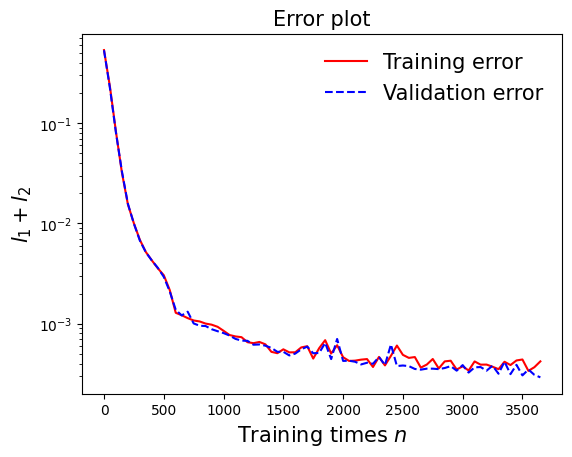

In [32]:
draw_loss(model)

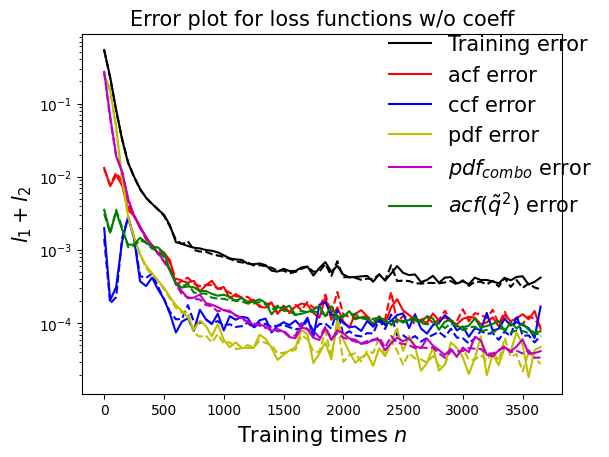

In [33]:
draw_errors(model)

## Test 1: plot the sample path generated by SINN and the exact sample path 

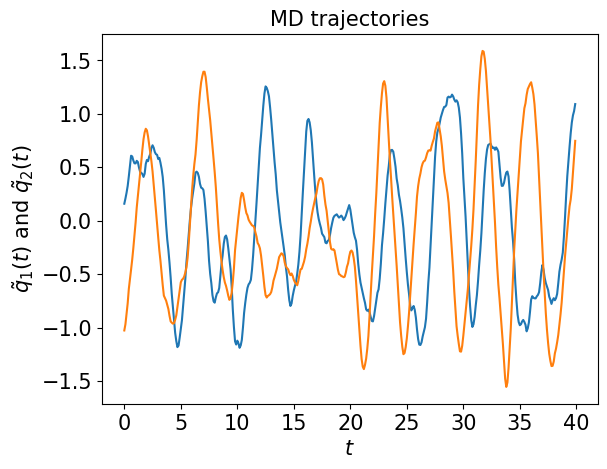

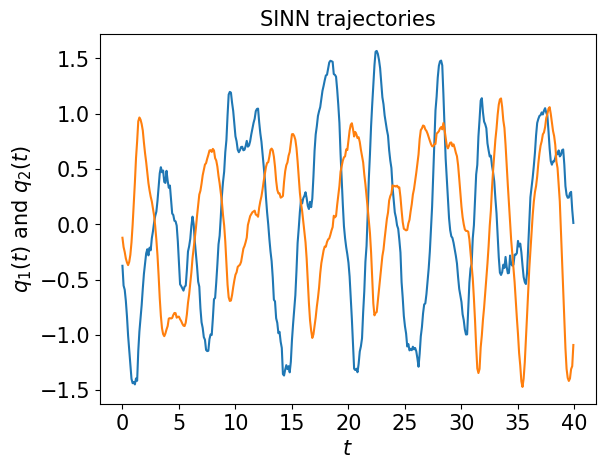

In [34]:
test1(model)

## Test 2: plot the CCF of the sample path generated by the SINN and the exact CCF

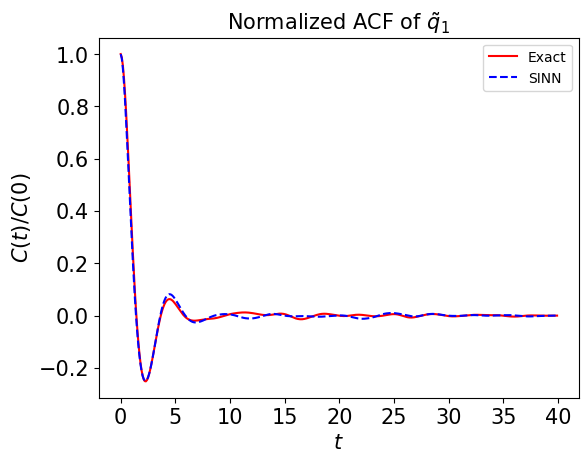

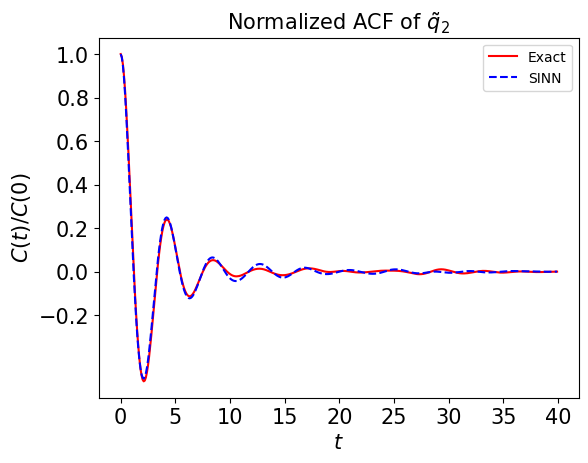

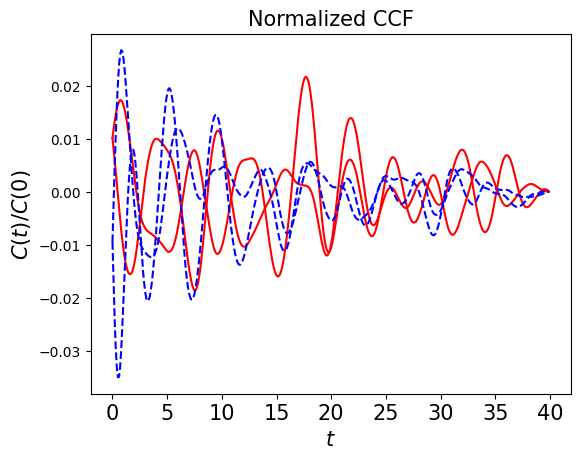

In [35]:
test2(model)

## Test 3: plot the PDF of the sample path generated by SINN and the exact PDF  

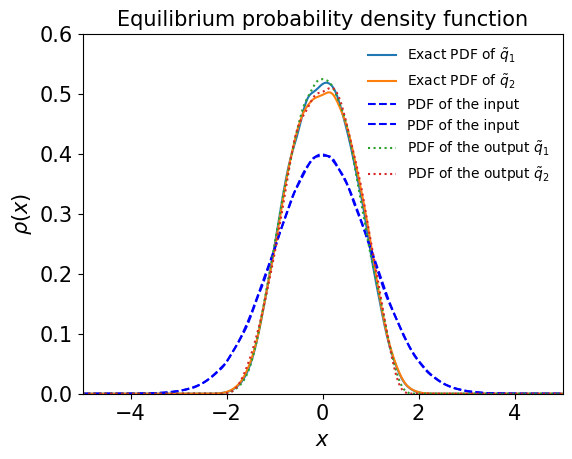

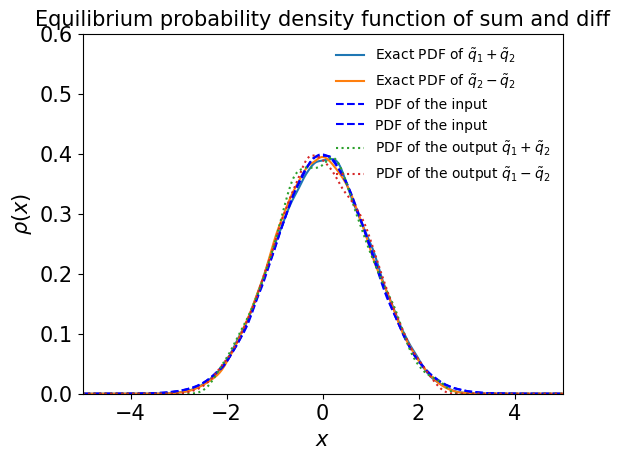

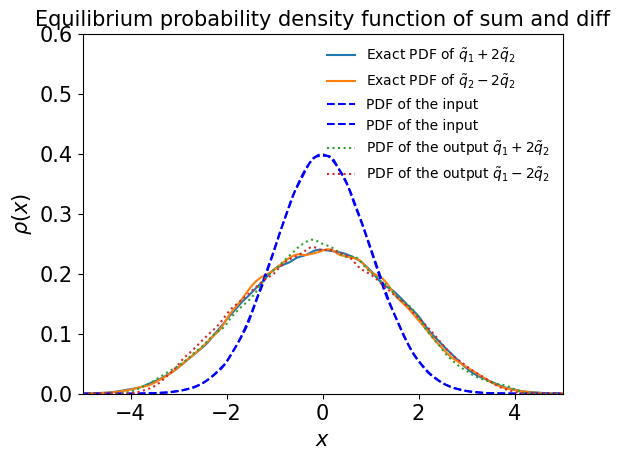

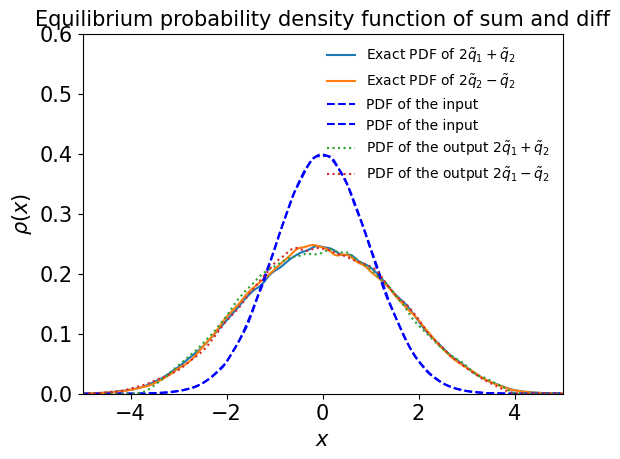

In [36]:
test3(model)

## Test 4: Comparing the higher-order ACF

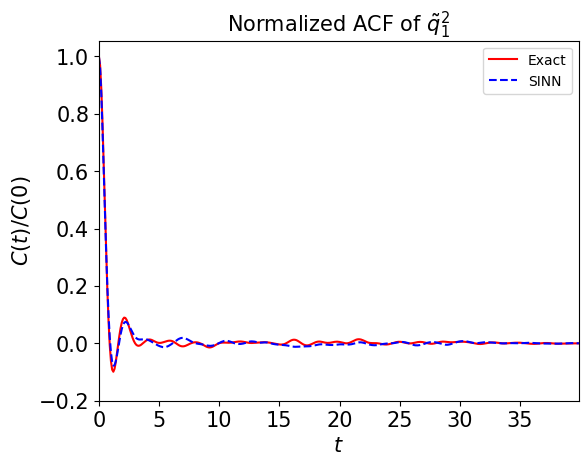

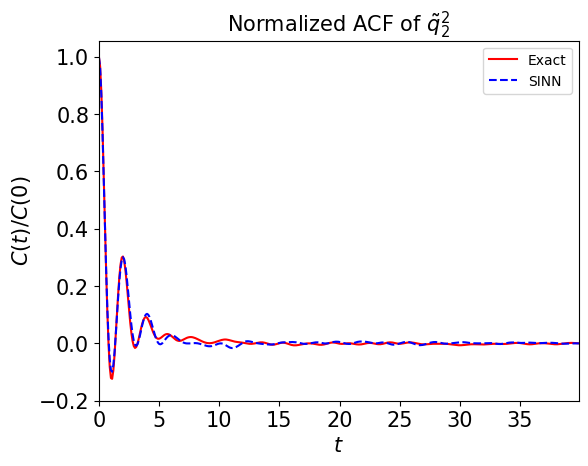

In [37]:
test4(model)

## Test 5: plot the expolation result, i.e. Prediction of the FPU-Langevin dynamics for longer time 

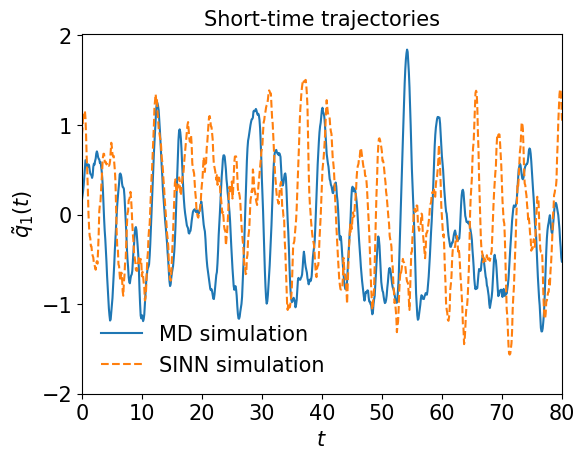

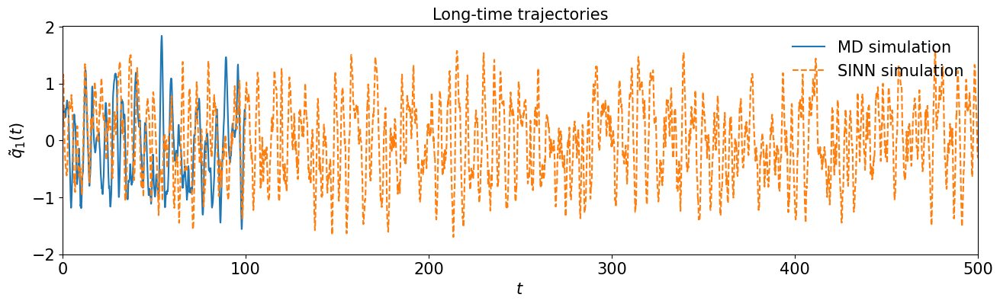

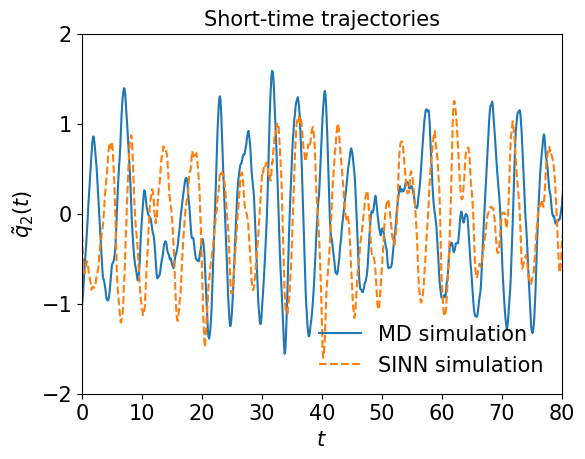

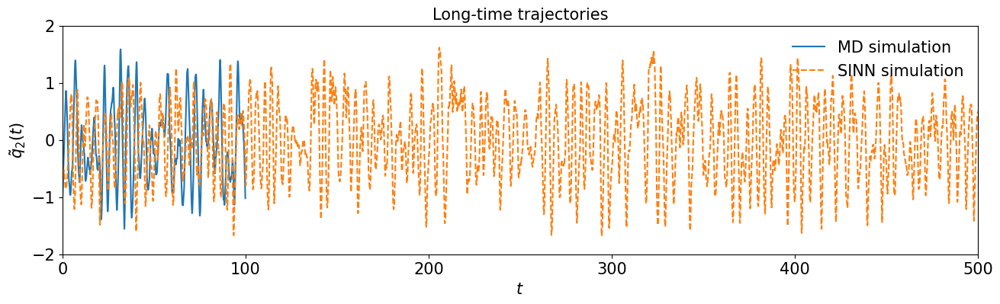

In [38]:
test5(model)

# Test 6: comparing scatter plots

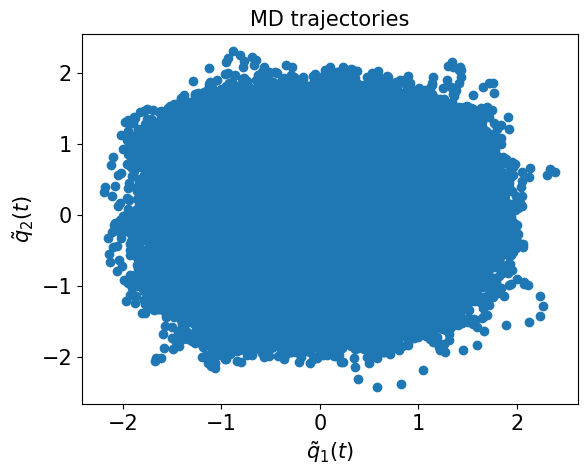

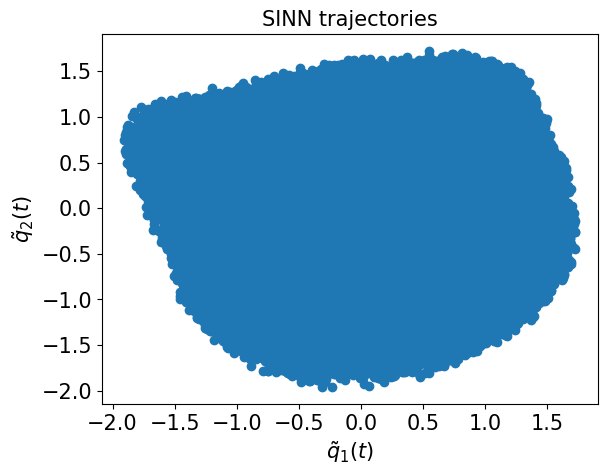

In [39]:
test6(model)

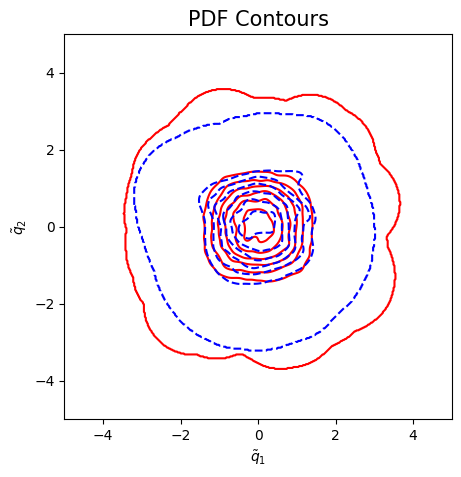

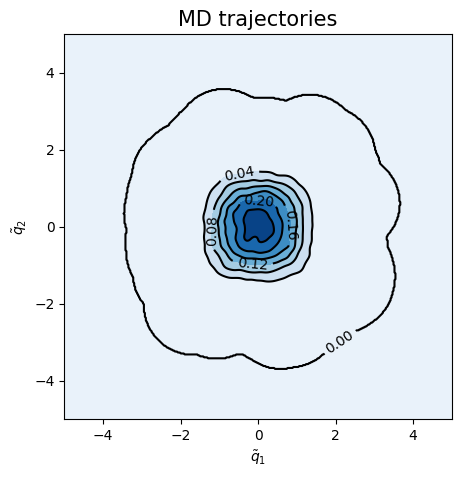

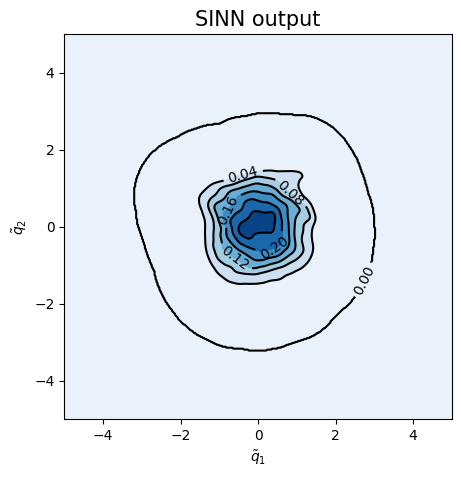

<Figure size 500x500 with 0 Axes>

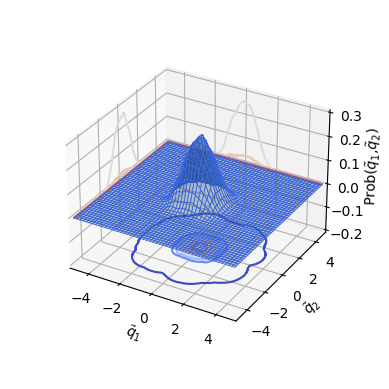

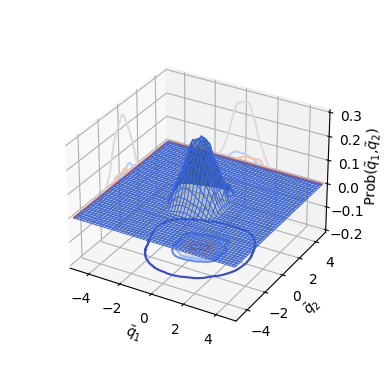

In [40]:
test7(model)

In [41]:
### Defining SINN model
net1 = SINN(2, 10, 2, 2).to(device)

In [42]:
model1 = Model(net=net1)

In [43]:
model1.train()

[0]-th step loss: 0.5305, 0.5291, acf: 0.00928, ccf: 0.00566, pdf: 0.24639, pdf2: 0.26622, acf2: 0.00157
[50]-th step loss: 0.2042, 0.1954, acf: 0.00662, ccf: 0.01189, pdf: 0.08345, pdf2: 0.09200, acf2: 0.00145
[100]-th step loss: 0.0674, 0.0664, acf: 0.00837, ccf: 0.01668, pdf: 0.00919, pdf2: 0.03074, acf2: 0.00145
[150]-th step loss: 0.0501, 0.0497, acf: 0.00620, ccf: 0.01343, pdf: 0.00456, pdf2: 0.02424, acf2: 0.00126
[200]-th step loss: 0.0377, 0.0379, acf: 0.00549, ccf: 0.01117, pdf: 0.00307, pdf2: 0.01684, acf2: 0.00136
[250]-th step loss: 0.0221, 0.0220, acf: 0.00372, ccf: 0.00956, pdf: 0.00229, pdf2: 0.00522, acf2: 0.00124
[300]-th step loss: 0.0153, 0.0152, acf: 0.00314, ccf: 0.00789, pdf: 0.00111, pdf2: 0.00193, acf2: 0.00112
[350]-th step loss: 0.0128, 0.0128, acf: 0.00317, ccf: 0.00689, pdf: 0.00069, pdf2: 0.00094, acf2: 0.00117
[400]-th step loss: 0.0110, 0.0110, acf: 0.00324, ccf: 0.00515, pdf: 0.00066, pdf2: 0.00063, acf2: 0.00133
[450]-th step loss: 0.0089, 0.0091, acf:

[3850]-th step loss: 0.0003, 0.0003, acf: 0.00008, ccf: 0.00015, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00006
[3900]-th step loss: 0.0004, 0.0003, acf: 0.00008, ccf: 0.00015, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00006
[3950]-th step loss: 0.0003, 0.0003, acf: 0.00007, ccf: 0.00014, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00006
[4000]-th step loss: 0.0003, 0.0004, acf: 0.00009, ccf: 0.00016, pdf: 0.00003, pdf2: 0.00004, acf2: 0.00007
[4050]-th step loss: 0.0003, 0.0004, acf: 0.00009, ccf: 0.00015, pdf: 0.00004, pdf2: 0.00004, acf2: 0.00007
[4100]-th step loss: 0.0004, 0.0003, acf: 0.00007, ccf: 0.00015, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00005
[4150]-th step loss: 0.0003, 0.0004, acf: 0.00008, ccf: 0.00015, pdf: 0.00004, pdf2: 0.00004, acf2: 0.00006
[4200]-th step loss: 0.0002, 0.0003, acf: 0.00007, ccf: 0.00014, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00005
[4250]-th step loss: 0.0003, 0.0003, acf: 0.00007, ccf: 0.00013, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00005
Training finished
Training t

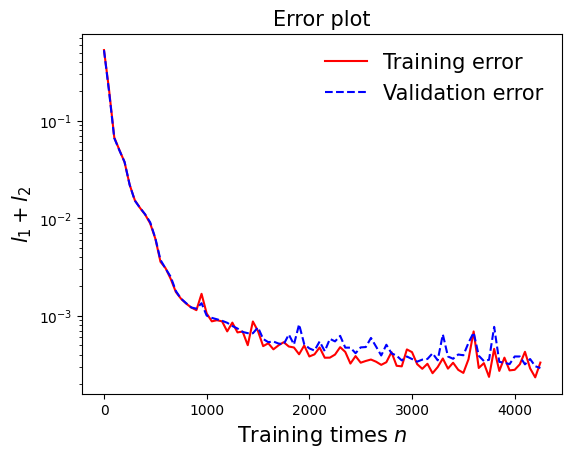

In [44]:
draw_loss(model1)

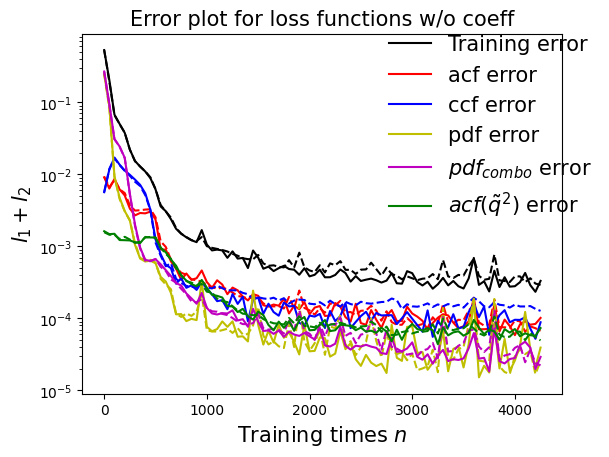

In [45]:
draw_errors(model1)

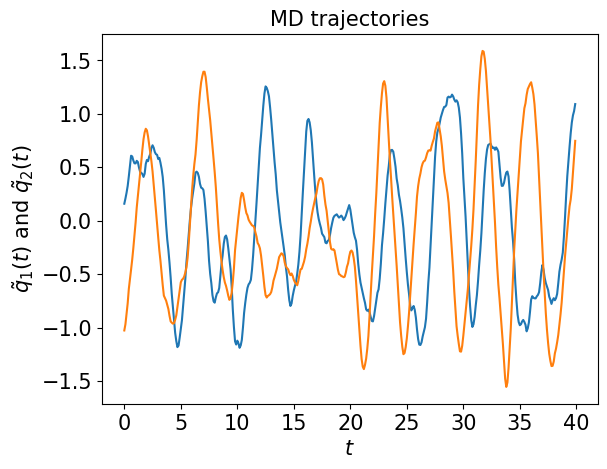

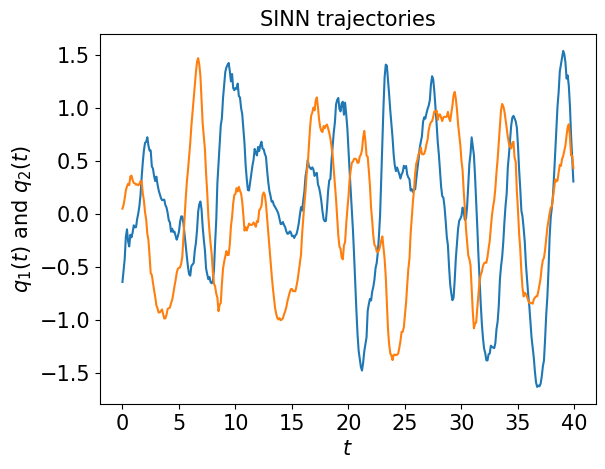

In [46]:
test1(model1)

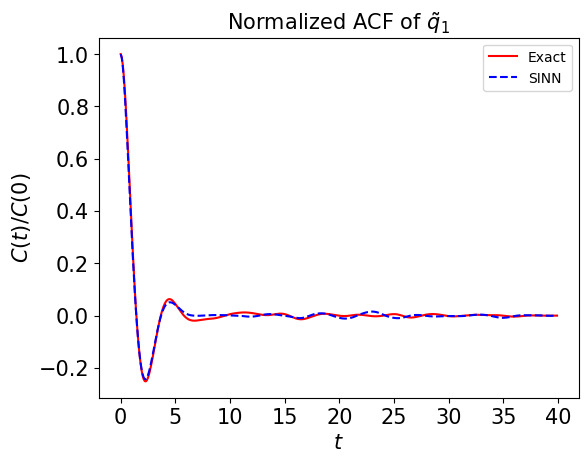

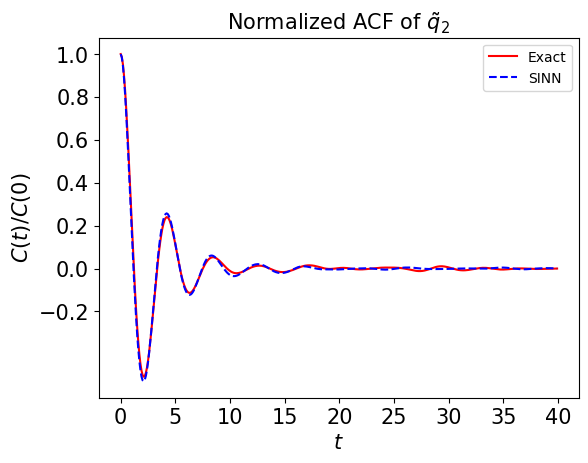

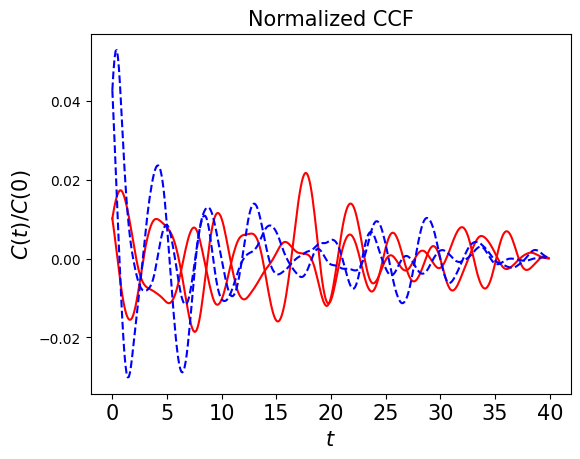

In [47]:
test2(model1)

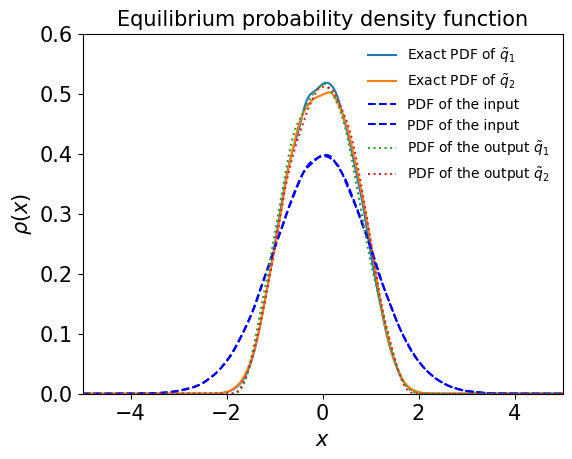

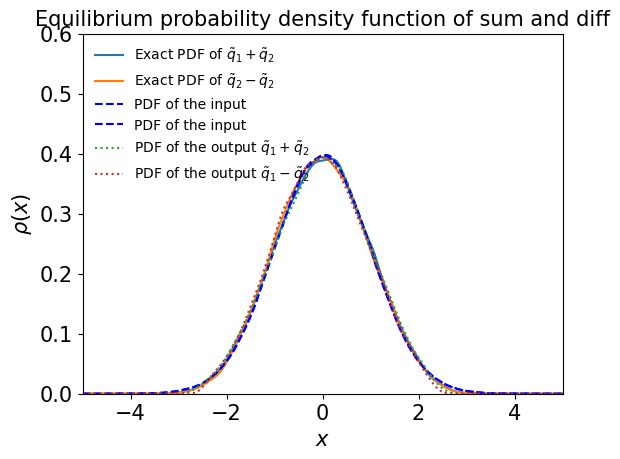

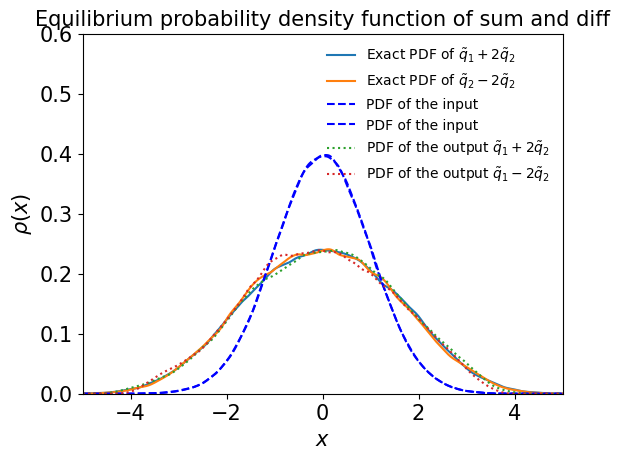

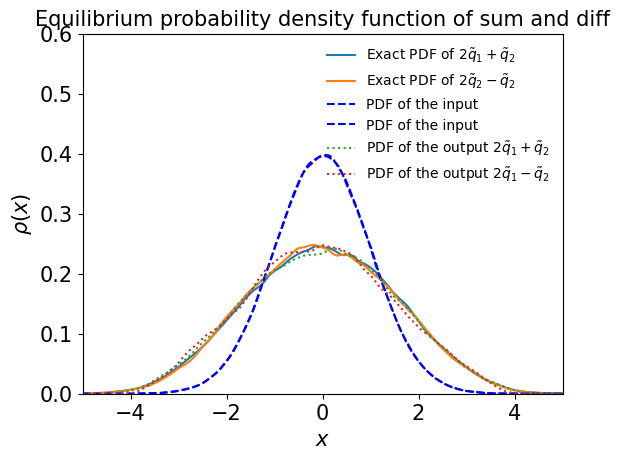

In [48]:
test3(model1)

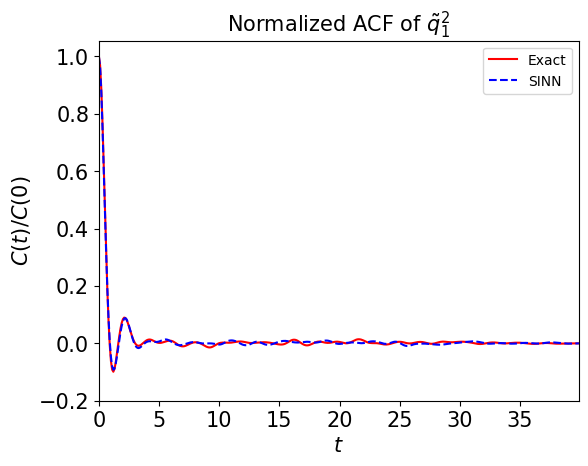

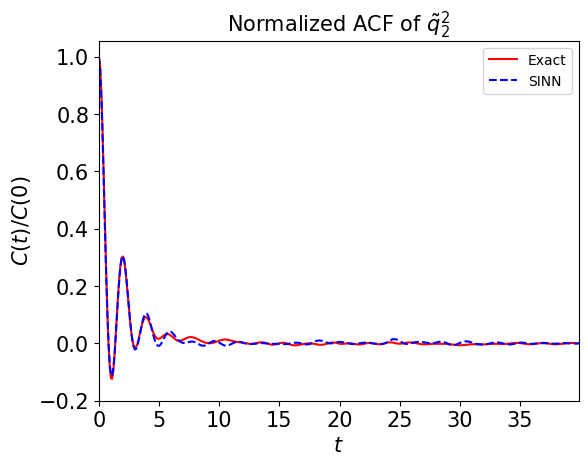

In [49]:
test4(model1)

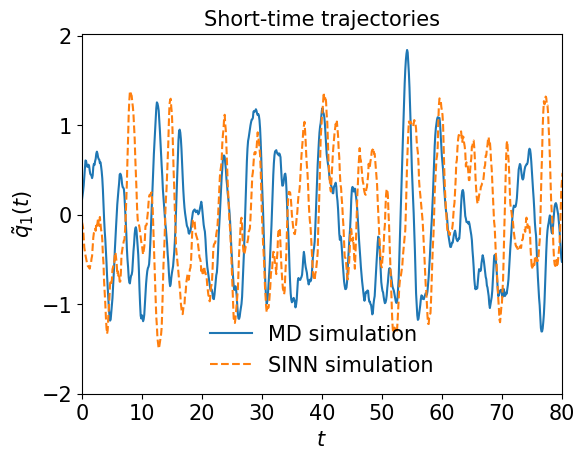

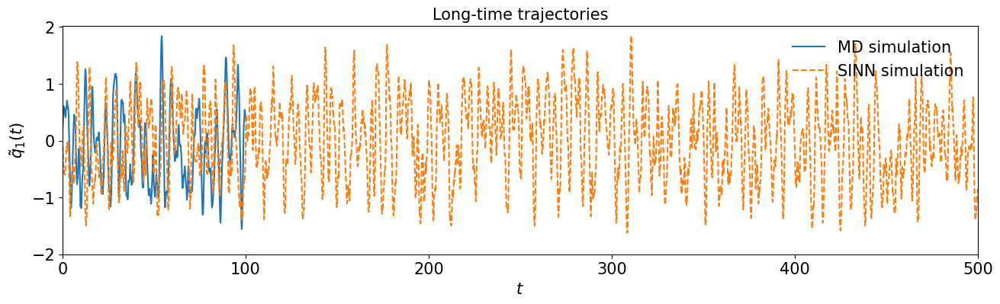

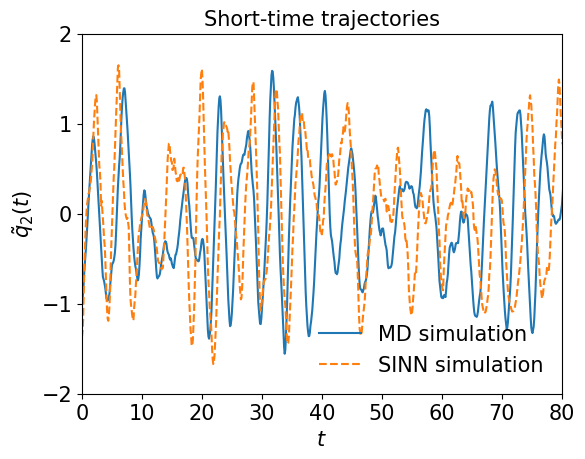

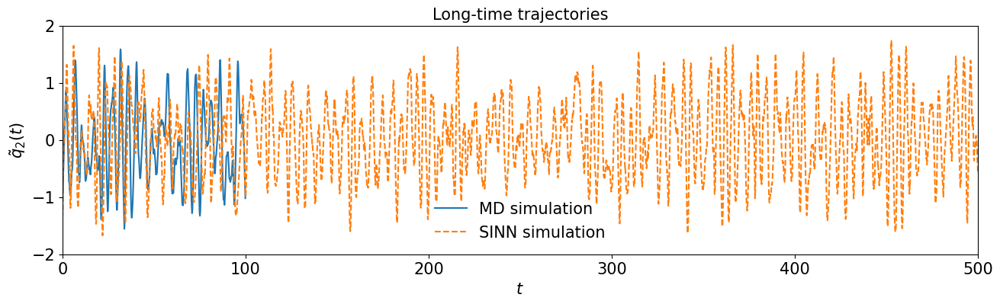

In [50]:
test5(model1)

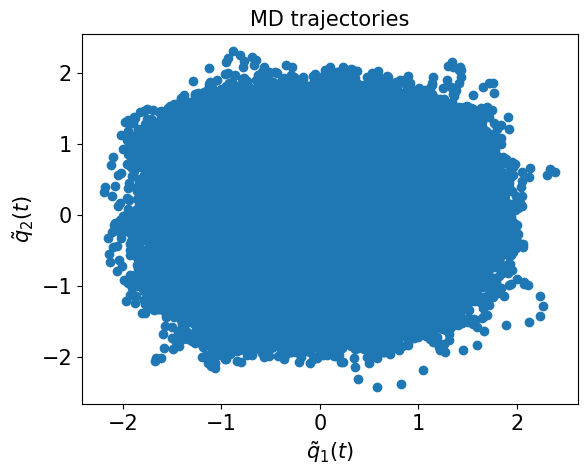

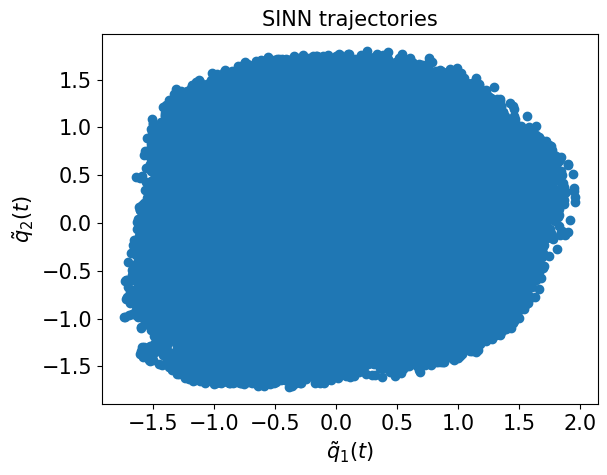

In [51]:
test6(model1)

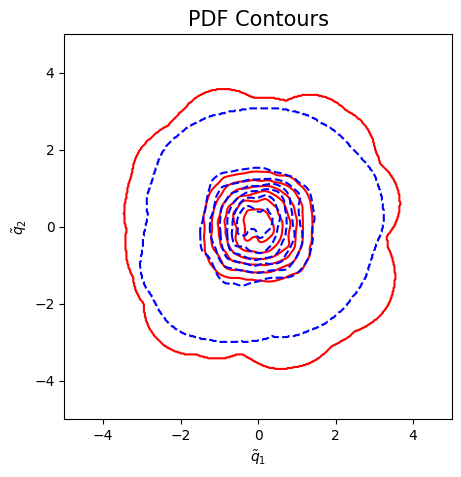

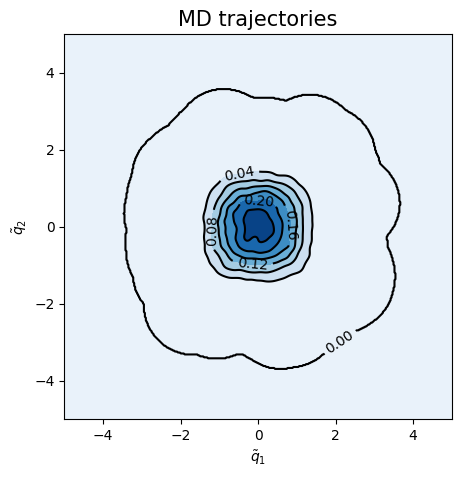

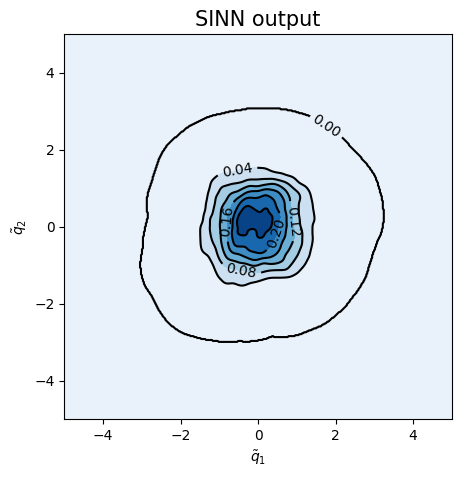

<Figure size 500x500 with 0 Axes>

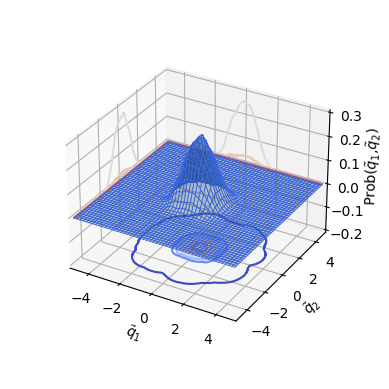

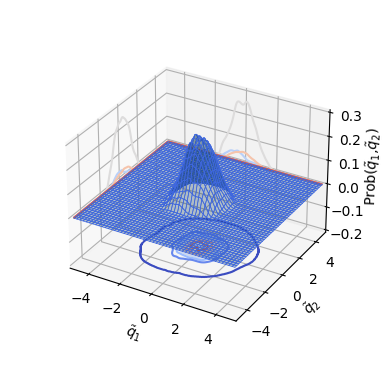

In [52]:
test7(model1)

In [53]:
### Defining SINN model
net2 = SINN(2, 10, 2, 2).to(device)

In [54]:
model2 = Model(net=net2)

In [55]:
model2.train()

[0]-th step loss: 0.5346, 0.5341, acf: 0.01160, ccf: 0.00380, pdf: 0.24692, pdf2: 0.26908, acf2: 0.00274
[50]-th step loss: 0.2496, 0.2370, acf: 0.00682, ccf: 0.01258, pdf: 0.11106, pdf2: 0.10412, acf2: 0.00242
[100]-th step loss: 0.0636, 0.0638, acf: 0.00692, ccf: 0.01379, pdf: 0.01548, pdf2: 0.02536, acf2: 0.00227
[150]-th step loss: 0.0331, 0.0332, acf: 0.00728, ccf: 0.00842, pdf: 0.00806, pdf2: 0.00779, acf2: 0.00165
[200]-th step loss: 0.0222, 0.0225, acf: 0.00801, ccf: 0.00653, pdf: 0.00322, pdf2: 0.00296, acf2: 0.00179
[250]-th step loss: 0.0185, 0.0186, acf: 0.00698, ccf: 0.00650, pdf: 0.00170, pdf2: 0.00204, acf2: 0.00142
[300]-th step loss: 0.0159, 0.0159, acf: 0.00568, ccf: 0.00618, pdf: 0.00116, pdf2: 0.00144, acf2: 0.00147
[350]-th step loss: 0.0132, 0.0132, acf: 0.00432, ccf: 0.00496, pdf: 0.00112, pdf2: 0.00106, acf2: 0.00169
[400]-th step loss: 0.0081, 0.0102, acf: 0.00166, ccf: 0.00131, pdf: 0.00341, pdf2: 0.00195, acf2: 0.00185
[450]-th step loss: 0.0041, 0.0043, acf:

[3850]-th step loss: 0.0061, 0.0063, acf: 0.00462, ccf: 0.00015, pdf: 0.00011, pdf2: 0.00027, acf2: 0.00118
[3900]-th step loss: 0.0061, 0.0062, acf: 0.00453, ccf: 0.00014, pdf: 0.00010, pdf2: 0.00027, acf2: 0.00116
[3950]-th step loss: 0.0059, 0.0061, acf: 0.00443, ccf: 0.00014, pdf: 0.00010, pdf2: 0.00026, acf2: 0.00115
[4000]-th step loss: 0.0056, 0.0059, acf: 0.00431, ccf: 0.00015, pdf: 0.00010, pdf2: 0.00026, acf2: 0.00113
[4050]-th step loss: 0.0056, 0.0058, acf: 0.00417, ccf: 0.00015, pdf: 0.00010, pdf2: 0.00026, acf2: 0.00111
[4100]-th step loss: 0.0055, 0.0056, acf: 0.00401, ccf: 0.00014, pdf: 0.00009, pdf2: 0.00027, acf2: 0.00108
[4150]-th step loss: 0.0052, 0.0054, acf: 0.00383, ccf: 0.00016, pdf: 0.00009, pdf2: 0.00027, acf2: 0.00106
[4200]-th step loss: 0.0052, 0.0052, acf: 0.00365, ccf: 0.00018, pdf: 0.00008, pdf2: 0.00028, acf2: 0.00103
[4250]-th step loss: 0.0047, 0.0050, acf: 0.00345, ccf: 0.00020, pdf: 0.00007, pdf2: 0.00028, acf2: 0.00099
[4300]-th step loss: 0.0046,

[7650]-th step loss: 0.0005, 0.0006, acf: 0.00011, ccf: 0.00018, pdf: 0.00010, pdf2: 0.00010, acf2: 0.00013
[7700]-th step loss: 0.0004, 0.0005, acf: 0.00012, ccf: 0.00013, pdf: 0.00005, pdf2: 0.00003, acf2: 0.00012
[7750]-th step loss: 0.0004, 0.0004, acf: 0.00011, ccf: 0.00014, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00012
[7800]-th step loss: 0.0004, 0.0006, acf: 0.00010, ccf: 0.00017, pdf: 0.00008, pdf2: 0.00007, acf2: 0.00013
[7850]-th step loss: 0.0005, 0.0004, acf: 0.00012, ccf: 0.00013, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00012
[7900]-th step loss: 0.0005, 0.0004, acf: 0.00012, ccf: 0.00013, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00012
[7950]-th step loss: 0.0004, 0.0004, acf: 0.00011, ccf: 0.00014, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00011
[8000]-th step loss: 0.0004, 0.0004, acf: 0.00010, ccf: 0.00014, pdf: 0.00003, pdf2: 0.00004, acf2: 0.00012
[8050]-th step loss: 0.0004, 0.0004, acf: 0.00011, ccf: 0.00013, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00011
[8100]-th step loss: 0.0004,

[11450]-th step loss: 0.0003, 0.0004, acf: 0.00010, ccf: 0.00015, pdf: 0.00003, pdf2: 0.00004, acf2: 0.00009
[11500]-th step loss: 0.0005, 0.0004, acf: 0.00011, ccf: 0.00013, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00009
[11550]-th step loss: 0.0004, 0.0004, acf: 0.00011, ccf: 0.00014, pdf: 0.00004, pdf2: 0.00003, acf2: 0.00008
[11600]-th step loss: 0.0003, 0.0005, acf: 0.00015, ccf: 0.00014, pdf: 0.00007, pdf2: 0.00004, acf2: 0.00009
[11650]-th step loss: 0.0002, 0.0004, acf: 0.00009, ccf: 0.00014, pdf: 0.00001, pdf2: 0.00003, acf2: 0.00009
[11700]-th step loss: 0.0003, 0.0005, acf: 0.00011, ccf: 0.00018, pdf: 0.00003, pdf2: 0.00005, acf2: 0.00009
[11750]-th step loss: 0.0004, 0.0004, acf: 0.00011, ccf: 0.00015, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00008
[11800]-th step loss: 0.0003, 0.0004, acf: 0.00011, ccf: 0.00015, pdf: 0.00001, pdf2: 0.00002, acf2: 0.00008
[11850]-th step loss: 0.0003, 0.0004, acf: 0.00010, ccf: 0.00014, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00009
[11900]-th step los

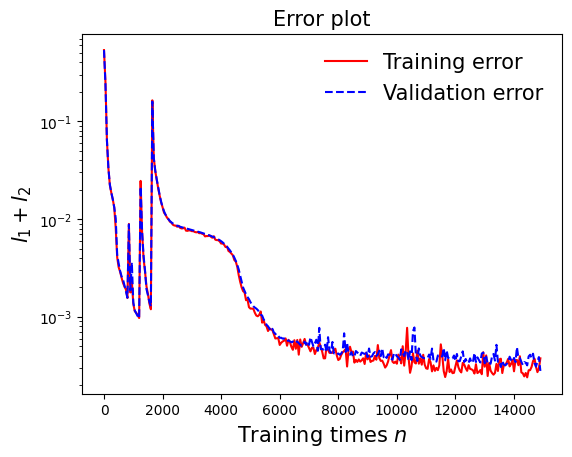

In [56]:
draw_loss(model2)

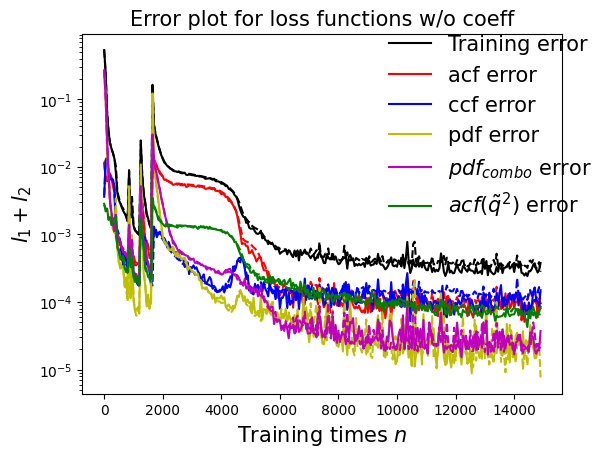

In [57]:
draw_errors(model2)

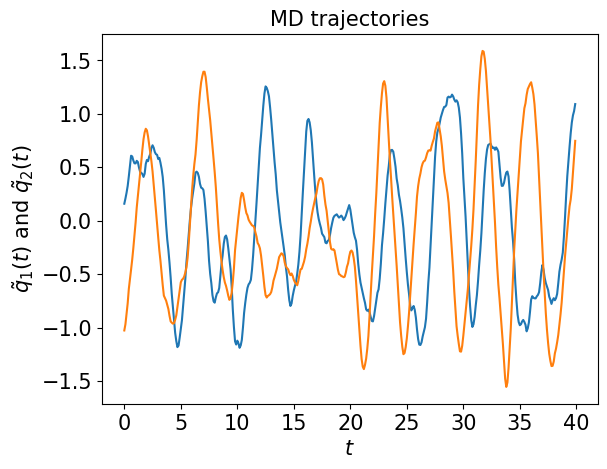

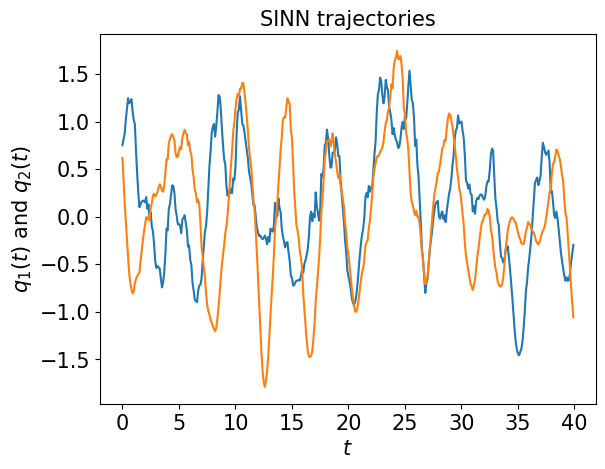

In [58]:
test1(model2)

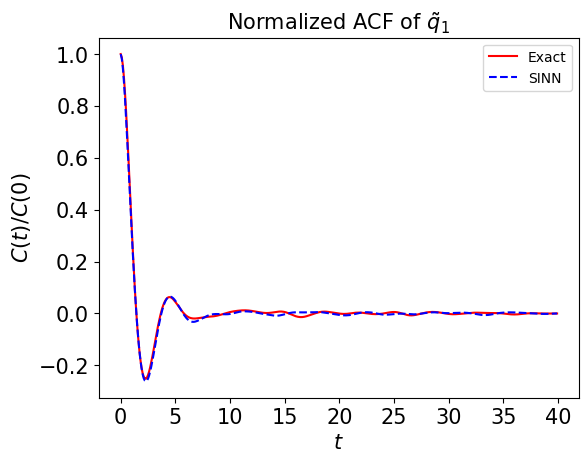

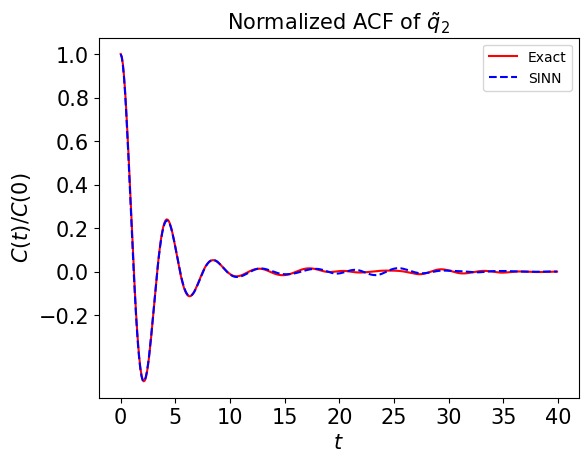

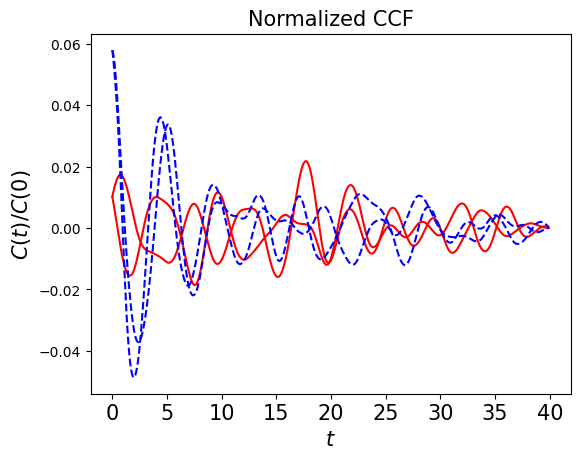

In [59]:
test2(model2)

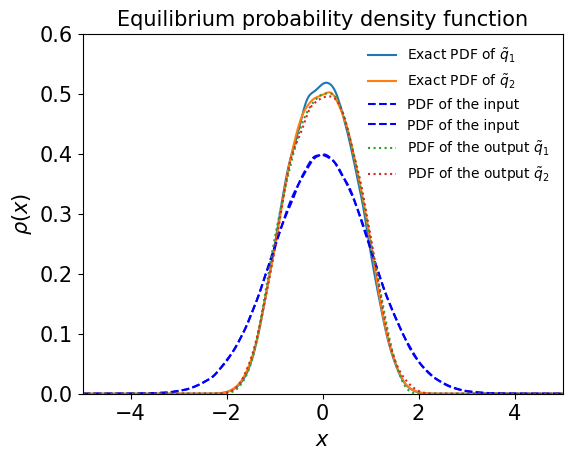

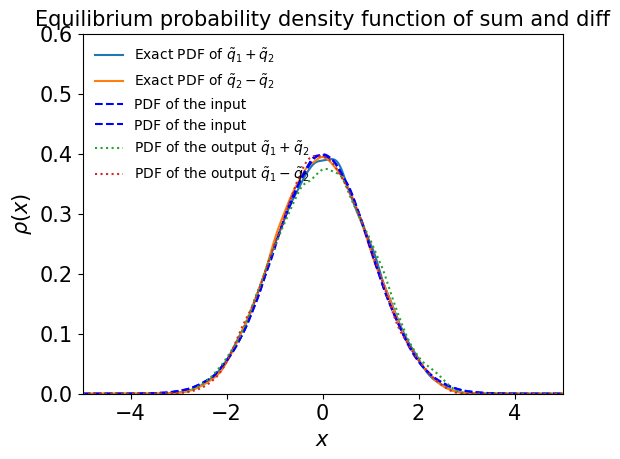

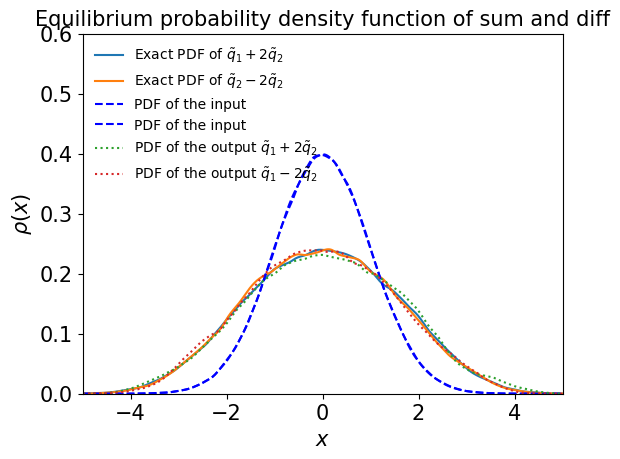

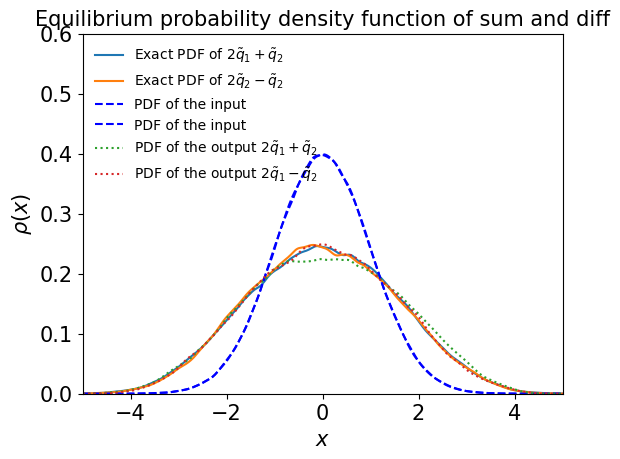

In [60]:
test3(model2)

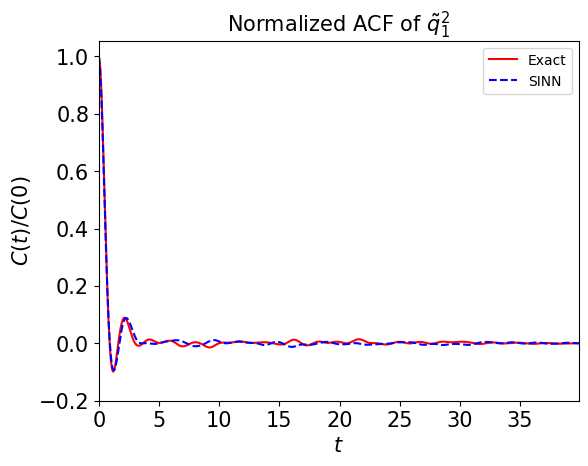

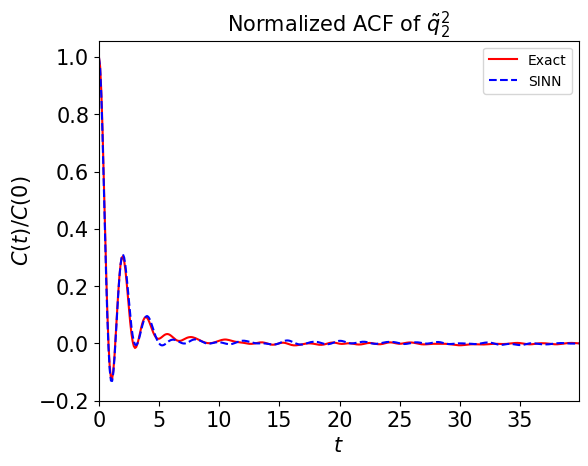

In [61]:
test4(model2)

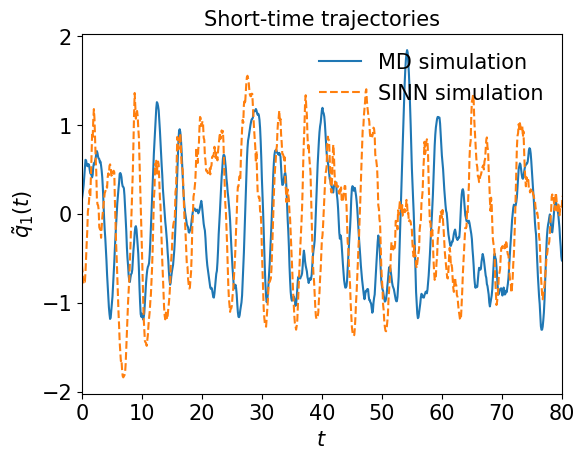

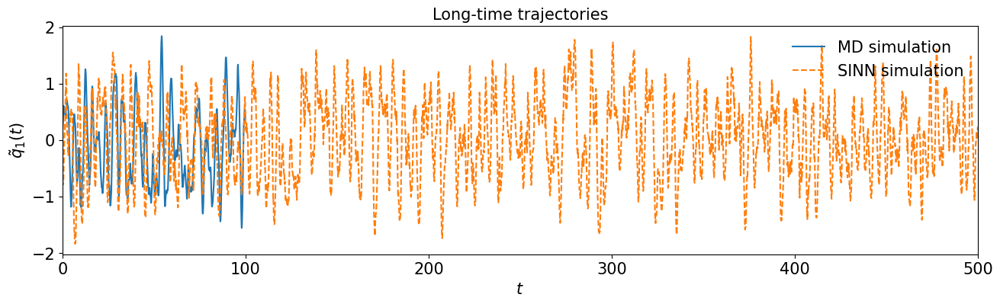

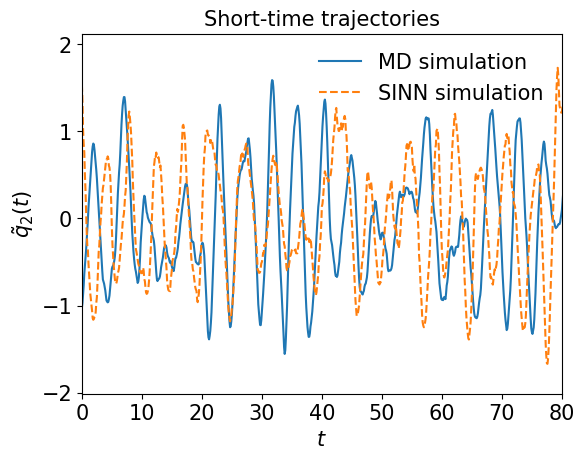

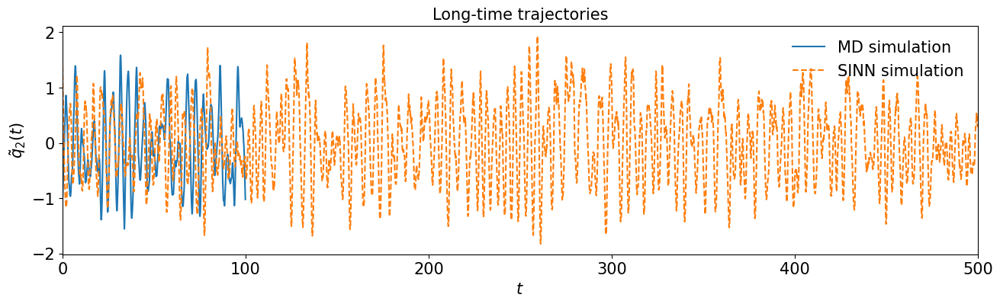

In [62]:
test5(model2)

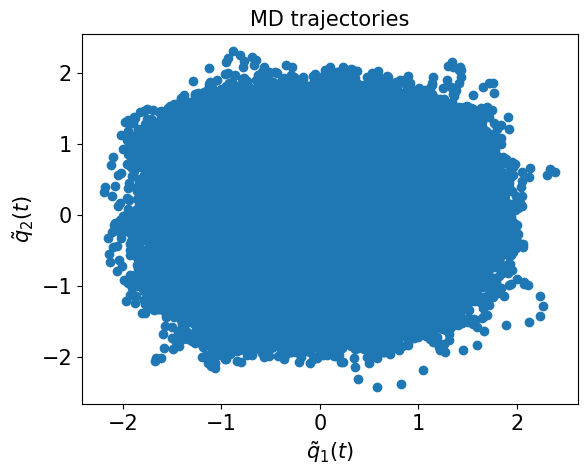

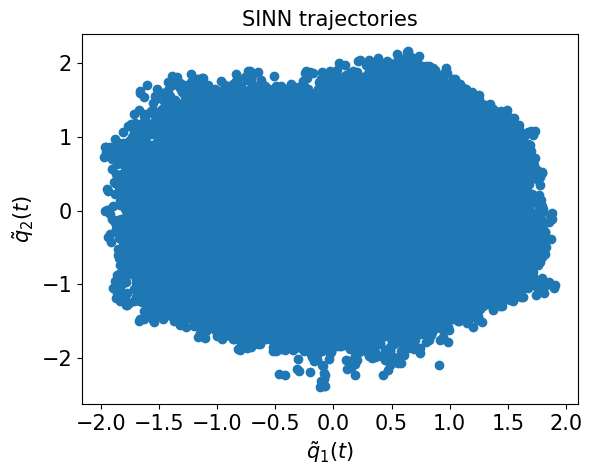

In [63]:
test6(model2)

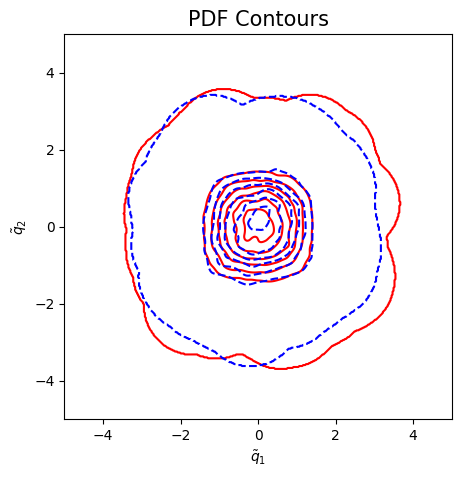

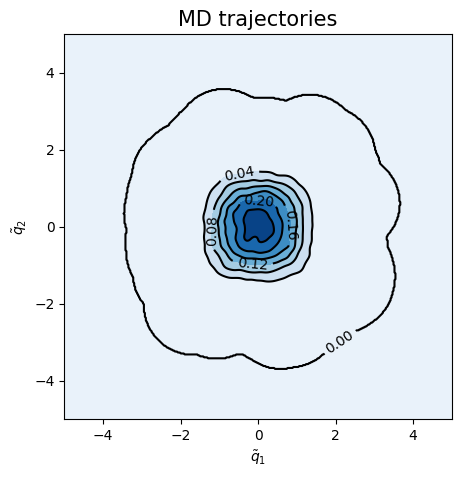

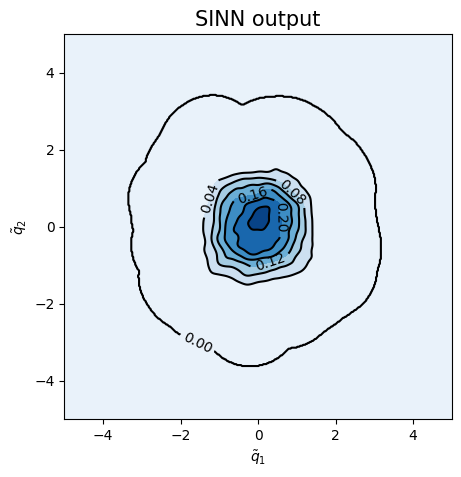

<Figure size 500x500 with 0 Axes>

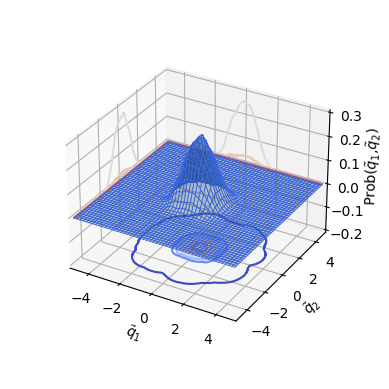

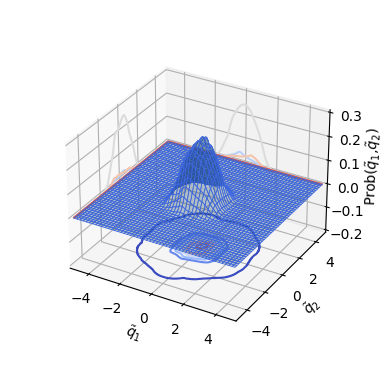

In [64]:
test7(model2)

In [65]:
### Defining SINN model
net3 = SINN(2, 10, 2, 2).to(device)

In [66]:
model3 = Model(net=net3)

In [67]:
model3.train()

[0]-th step loss: 0.5325, 0.5314, acf: 0.01208, ccf: 0.00186, pdf: 0.24685, pdf2: 0.26771, acf2: 0.00292
[50]-th step loss: 0.2454, 0.2360, acf: 0.00889, ccf: 0.00235, pdf: 0.14432, pdf2: 0.07817, acf2: 0.00223
[100]-th step loss: 0.0580, 0.0574, acf: 0.00805, ccf: 0.01416, pdf: 0.01894, pdf2: 0.01442, acf2: 0.00179
[150]-th step loss: 0.0291, 0.0289, acf: 0.00608, ccf: 0.00940, pdf: 0.00550, pdf2: 0.00573, acf2: 0.00217
[200]-th step loss: 0.0187, 0.0184, acf: 0.00516, ccf: 0.00724, pdf: 0.00201, pdf2: 0.00211, acf2: 0.00190
[250]-th step loss: 0.0134, 0.0135, acf: 0.00597, ccf: 0.00359, pdf: 0.00117, pdf2: 0.00152, acf2: 0.00123
[300]-th step loss: 0.0111, 0.0111, acf: 0.00624, ccf: 0.00183, pdf: 0.00064, pdf2: 0.00126, acf2: 0.00118
[350]-th step loss: 0.0085, 0.0087, acf: 0.00528, ccf: 0.00071, pdf: 0.00039, pdf2: 0.00110, acf2: 0.00122
[400]-th step loss: 0.0054, 0.0053, acf: 0.00299, ccf: 0.00029, pdf: 0.00023, pdf2: 0.00091, acf2: 0.00093
[450]-th step loss: 0.0024, 0.0025, acf:

Training finished
Training time: 228.09
Training time per iteration: 0.06
Number of Iterations:3807


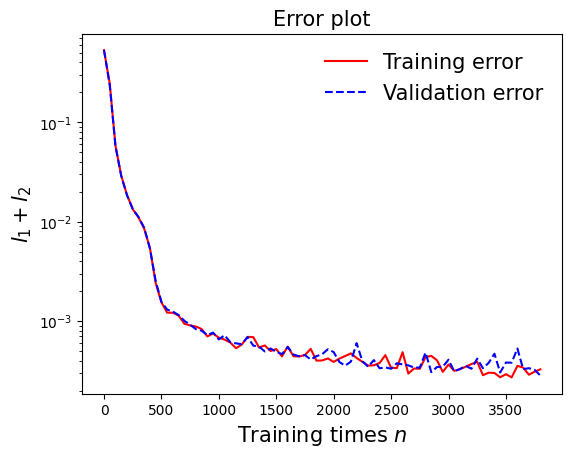

In [68]:
draw_loss(model3)

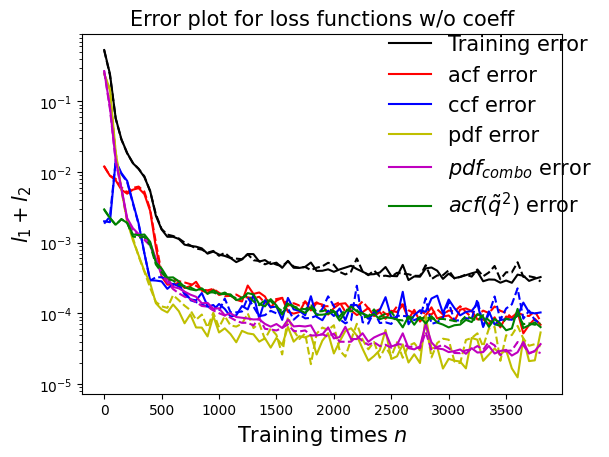

In [69]:
draw_errors(model3)

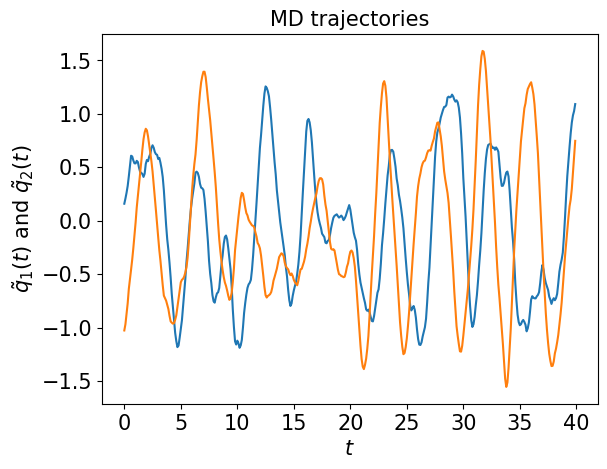

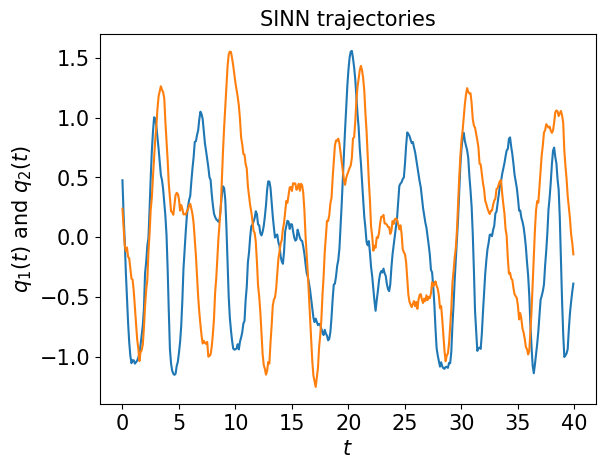

In [70]:
test1(model3)

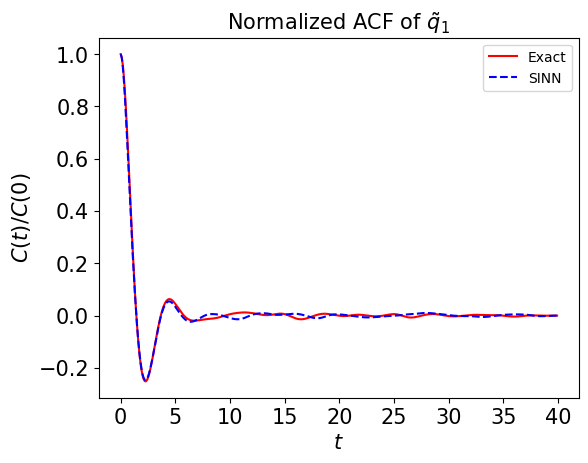

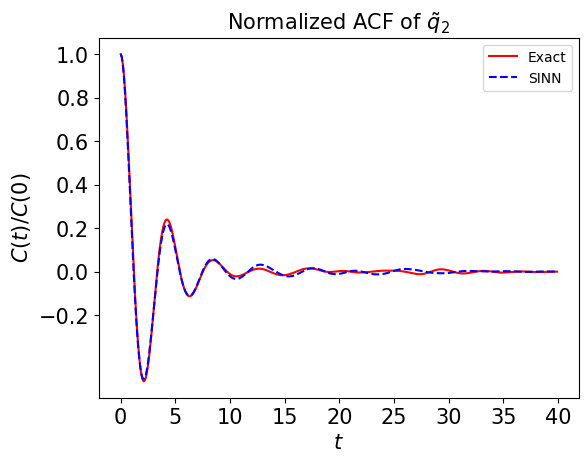

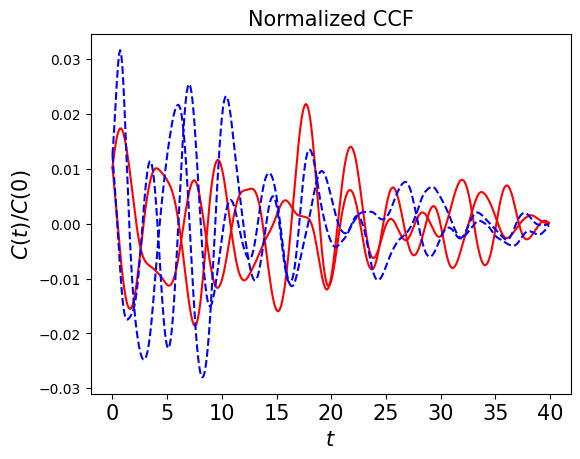

In [71]:
test2(model3)

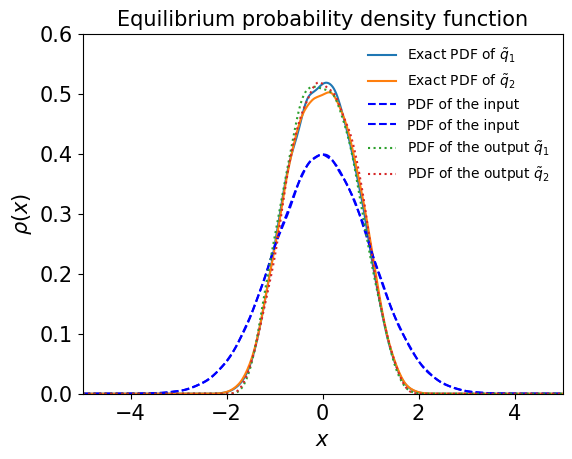

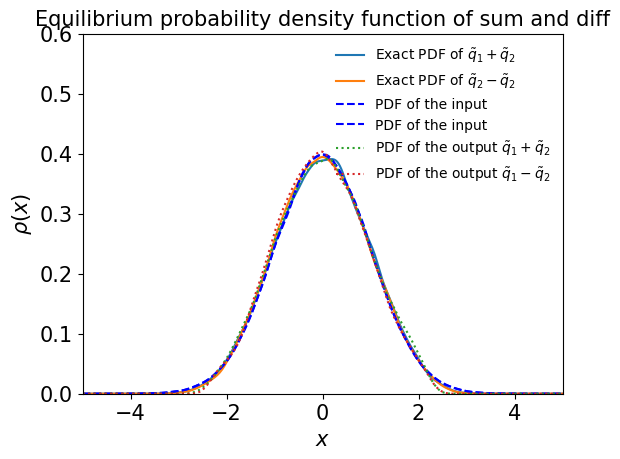

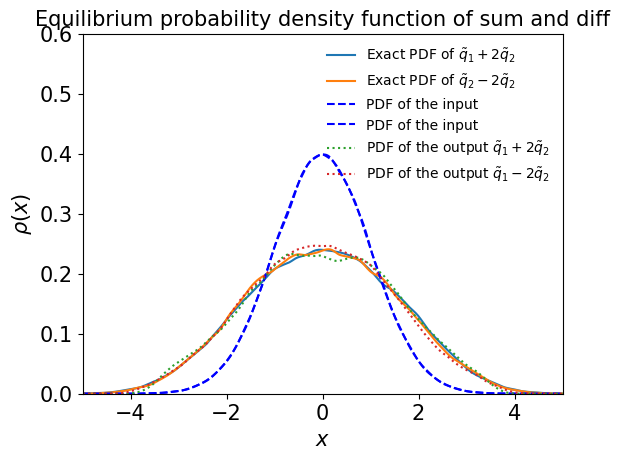

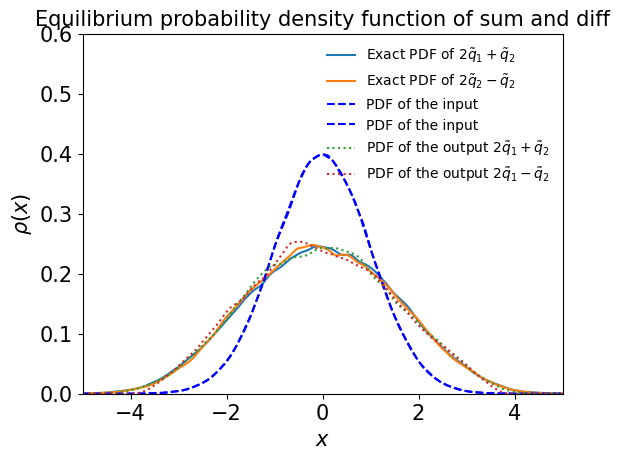

In [72]:
test3(model3)

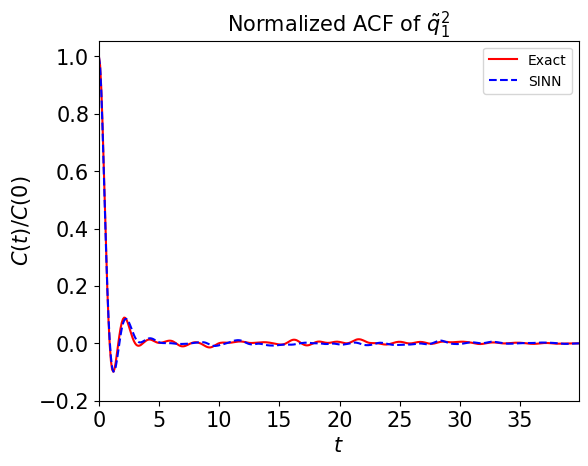

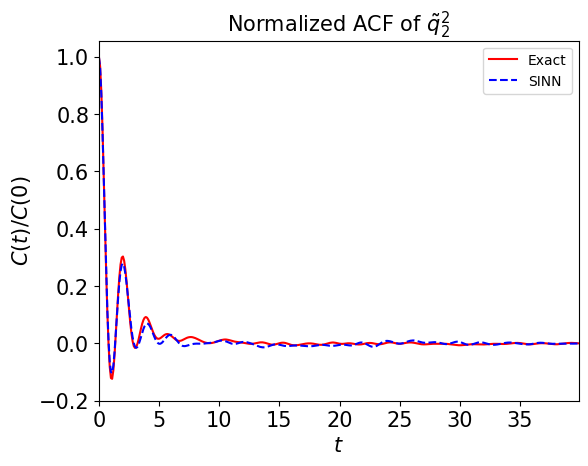

In [73]:
test4(model3)

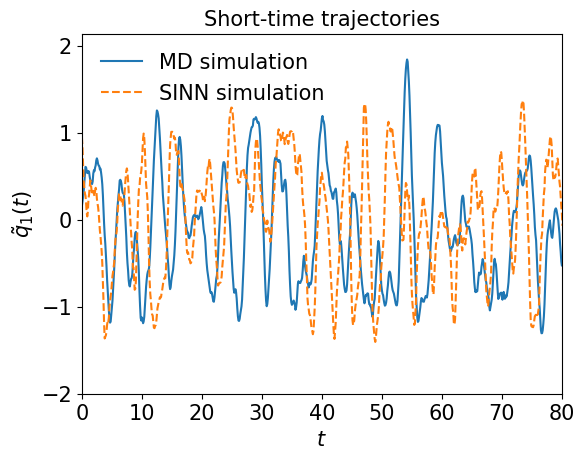

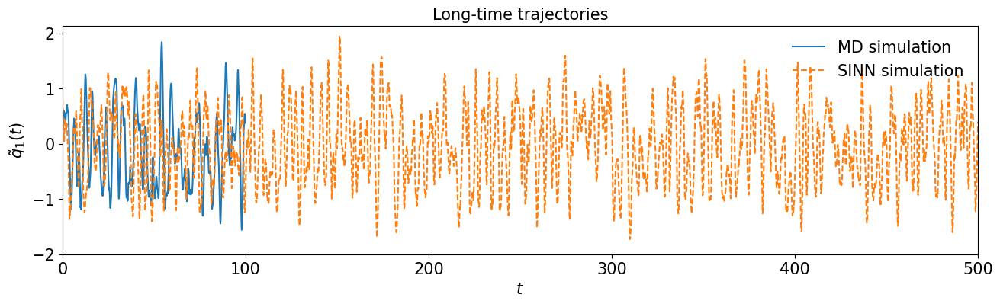

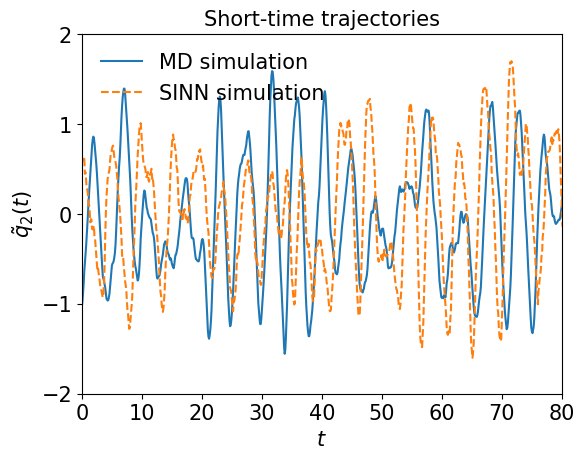

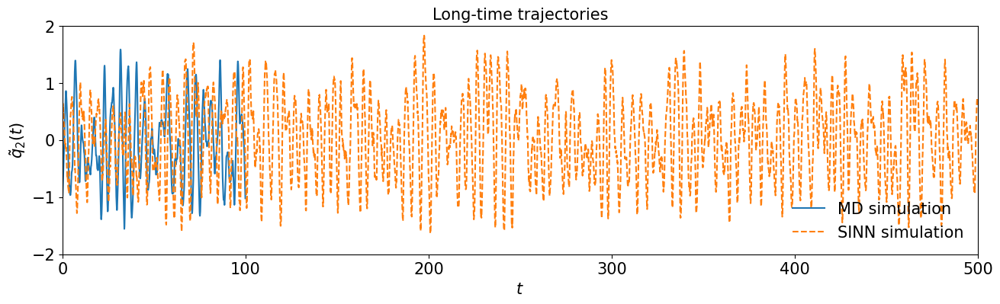

In [74]:
test5(model3)

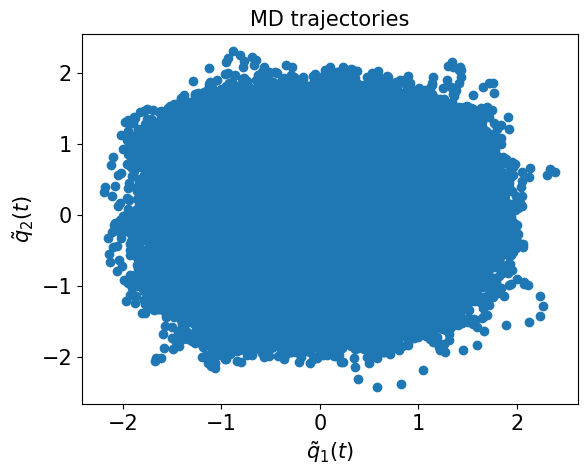

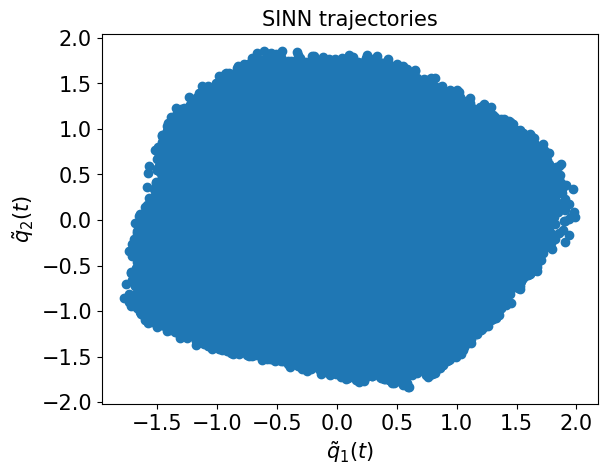

In [75]:
test6(model3)

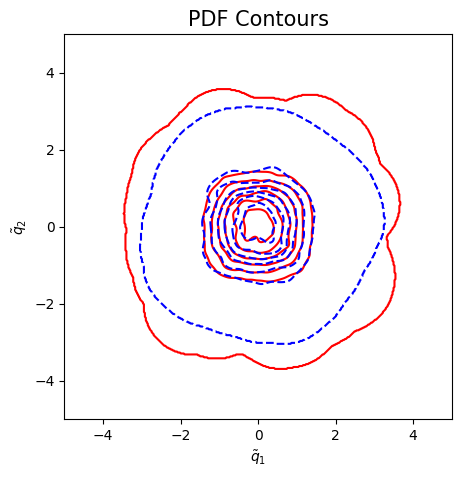

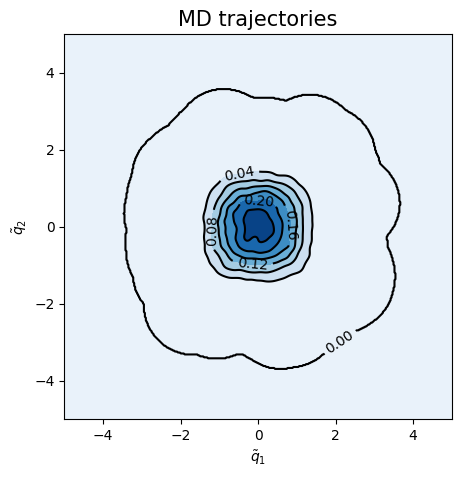

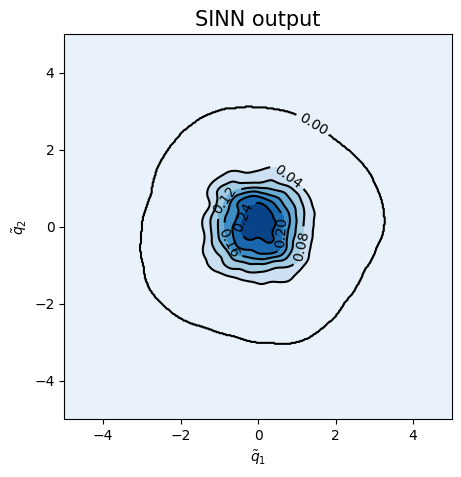

<Figure size 500x500 with 0 Axes>

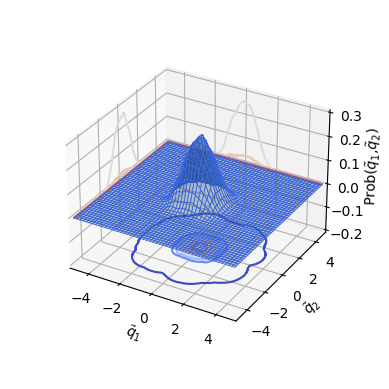

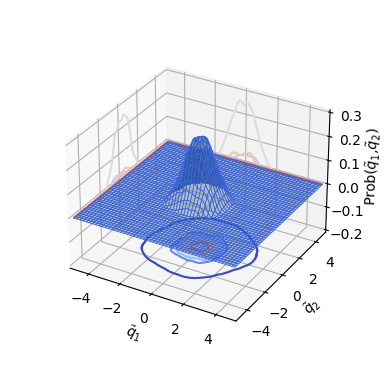

In [76]:
test7(model3)

In [77]:
### Defining SINN model
net4 = SINN(2, 10, 2, 2).to(device)

In [78]:
model4 = Model(net=net4)

In [79]:
model4.train()

[0]-th step loss: 0.5313, 0.5306, acf: 0.01079, ccf: 0.00362, pdf: 0.24596, pdf2: 0.26791, acf2: 0.00235
[50]-th step loss: 0.3110, 0.3004, acf: 0.00680, ccf: 0.00025, pdf: 0.17348, pdf2: 0.11819, acf2: 0.00168
[100]-th step loss: 0.0311, 0.0309, acf: 0.00611, ccf: 0.00384, pdf: 0.01159, pdf2: 0.00662, acf2: 0.00272
[150]-th step loss: 0.0167, 0.0168, acf: 0.00524, ccf: 0.00285, pdf: 0.00408, pdf2: 0.00325, acf2: 0.00141
[200]-th step loss: 0.0131, 0.0132, acf: 0.00575, ccf: 0.00163, pdf: 0.00233, pdf2: 0.00233, acf2: 0.00114
[250]-th step loss: 0.0107, 0.0110, acf: 0.00543, ccf: 0.00105, pdf: 0.00159, pdf2: 0.00179, acf2: 0.00111
[300]-th step loss: 0.0091, 0.0091, acf: 0.00494, ccf: 0.00062, pdf: 0.00111, pdf2: 0.00131, acf2: 0.00114
[350]-th step loss: 0.0074, 0.0078, acf: 0.00467, ccf: 0.00028, pdf: 0.00078, pdf2: 0.00088, acf2: 0.00120
[400]-th step loss: 0.0071, 0.0070, acf: 0.00448, ccf: 0.00014, pdf: 0.00056, pdf2: 0.00064, acf2: 0.00122
[450]-th step loss: 0.0062, 0.0066, acf:

[3850]-th step loss: 0.0004, 0.0004, acf: 0.00012, ccf: 0.00010, pdf: 0.00002, pdf2: 0.00005, acf2: 0.00011
[3900]-th step loss: 0.0004, 0.0004, acf: 0.00009, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00005, acf2: 0.00011
[3950]-th step loss: 0.0003, 0.0003, acf: 0.00009, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00004, acf2: 0.00010
[4000]-th step loss: 0.0003, 0.0004, acf: 0.00009, ccf: 0.00010, pdf: 0.00003, pdf2: 0.00004, acf2: 0.00011
[4050]-th step loss: 0.0004, 0.0004, acf: 0.00009, ccf: 0.00010, pdf: 0.00002, pdf2: 0.00004, acf2: 0.00011
[4100]-th step loss: 0.0003, 0.0004, acf: 0.00009, ccf: 0.00010, pdf: 0.00003, pdf2: 0.00004, acf2: 0.00011
[4150]-th step loss: 0.0004, 0.0004, acf: 0.00008, ccf: 0.00011, pdf: 0.00005, pdf2: 0.00005, acf2: 0.00010
[4200]-th step loss: 0.0003, 0.0004, acf: 0.00009, ccf: 0.00011, pdf: 0.00003, pdf2: 0.00004, acf2: 0.00010
[4250]-th step loss: 0.0004, 0.0003, acf: 0.00011, ccf: 0.00010, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00009
[4300]-th step loss: 0.0003,

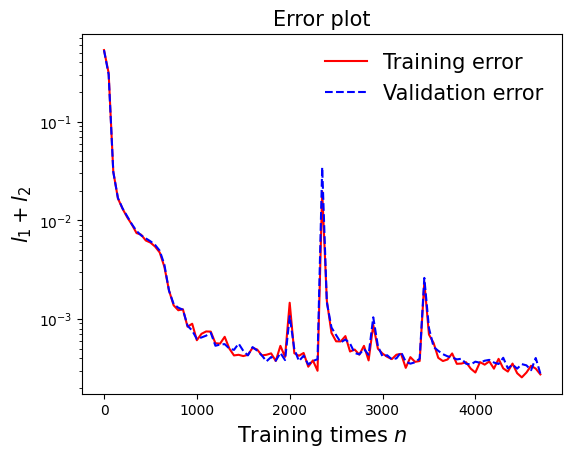

In [80]:
draw_loss(model4)

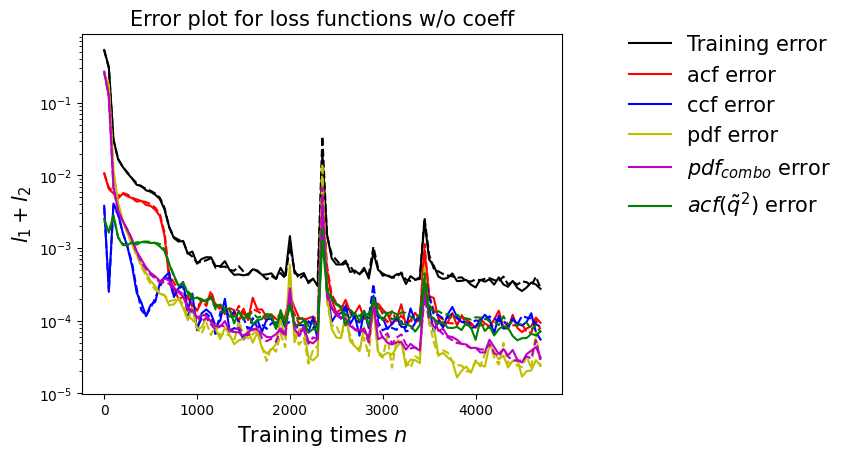

In [81]:
draw_errors(model4)

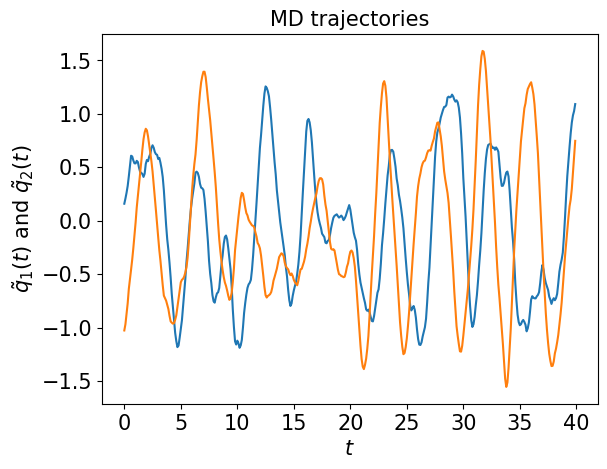

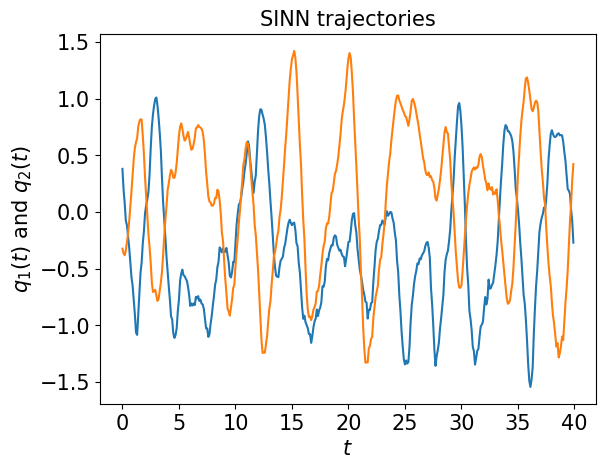

In [82]:
test1(model4)

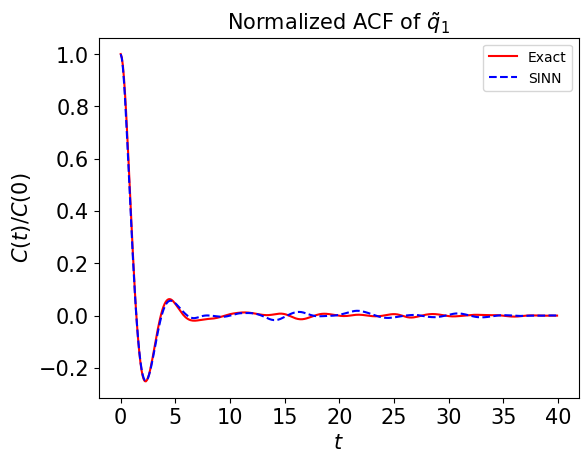

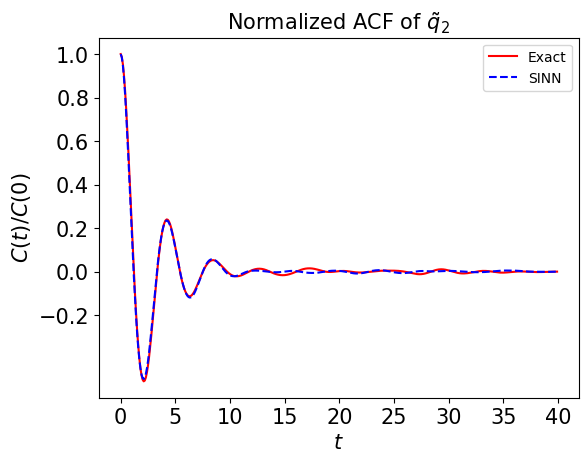

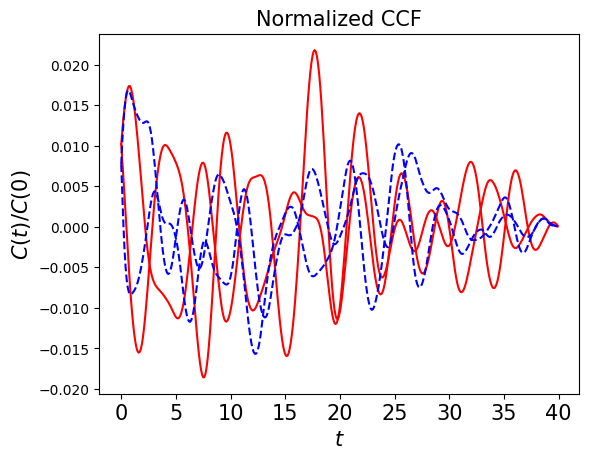

In [83]:
test2(model4)

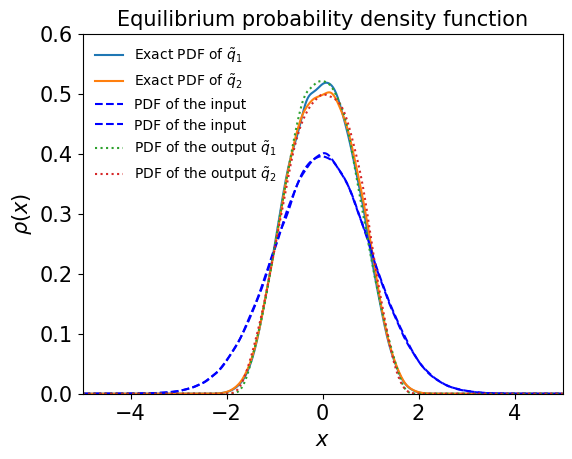

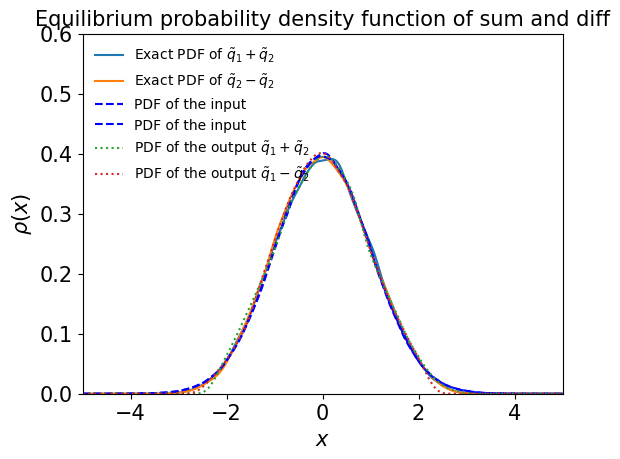

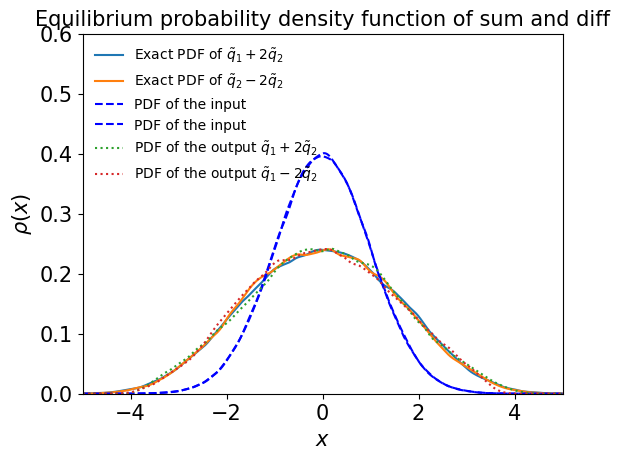

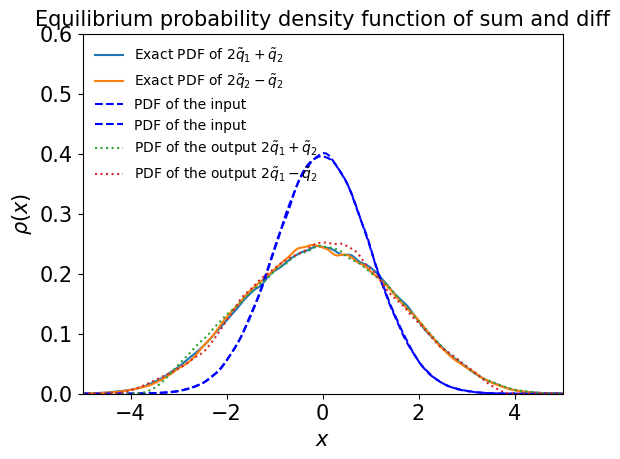

In [84]:
test3(model4)

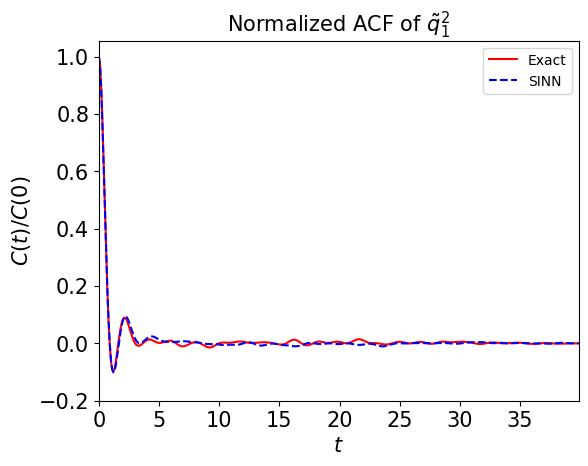

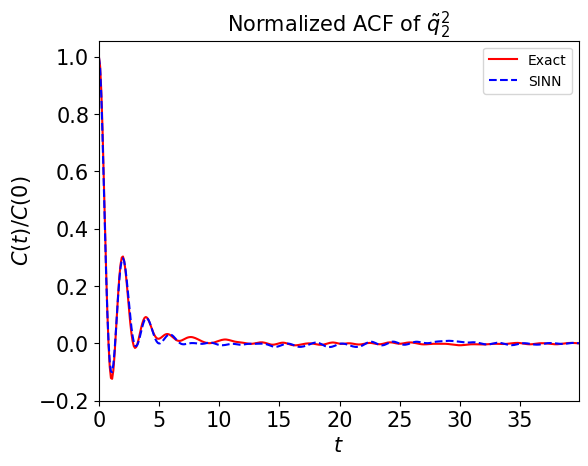

In [85]:
test4(model4)

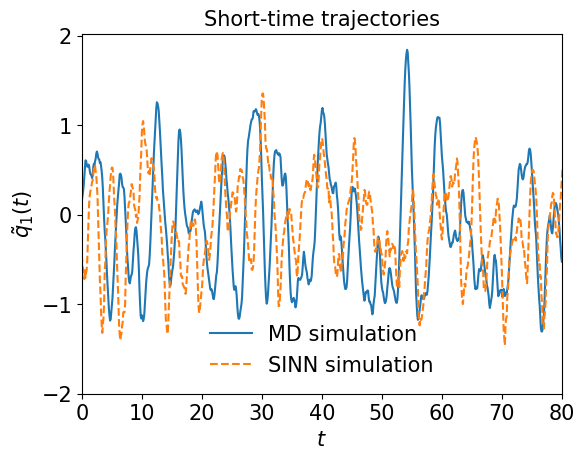

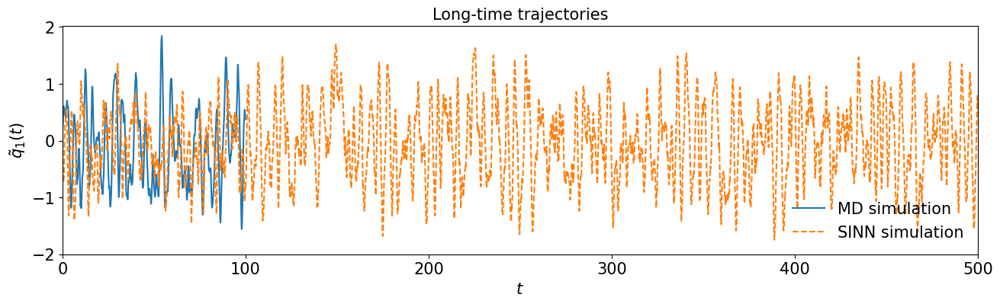

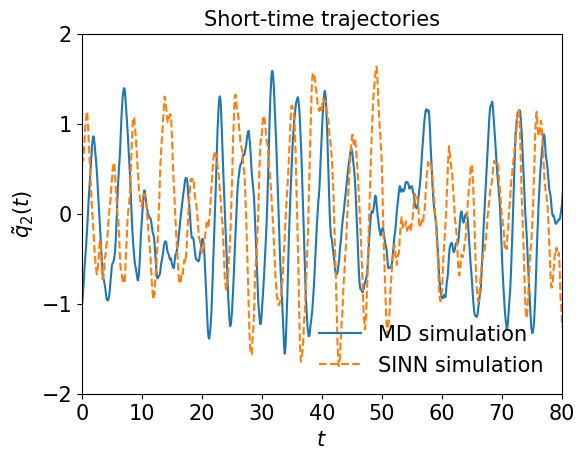

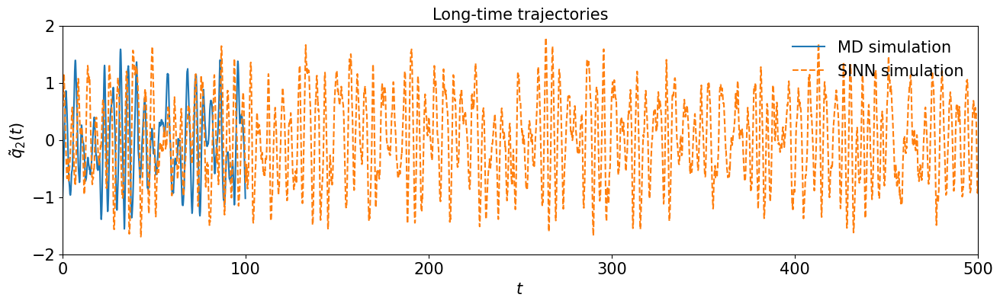

In [86]:
test5(model4)

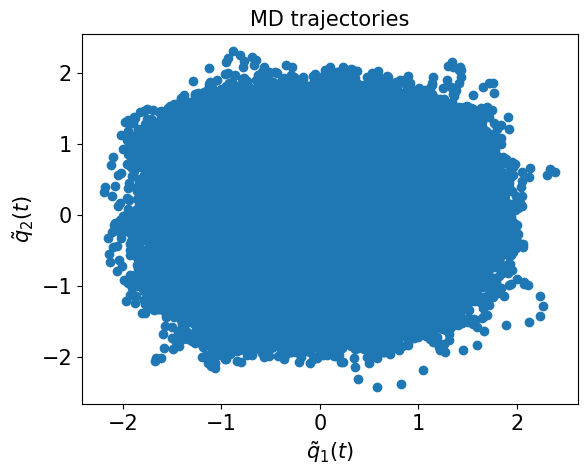

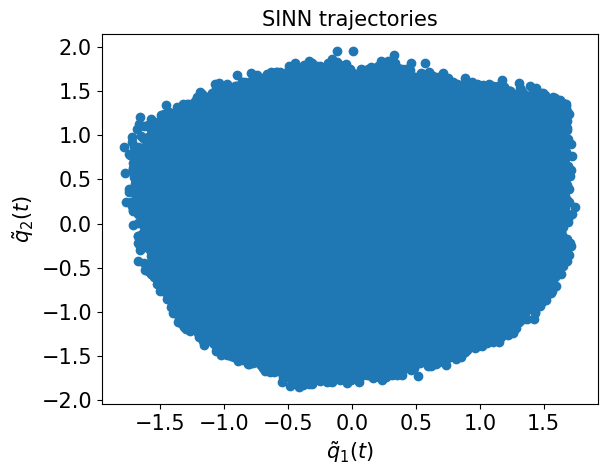

In [87]:
test6(model4)

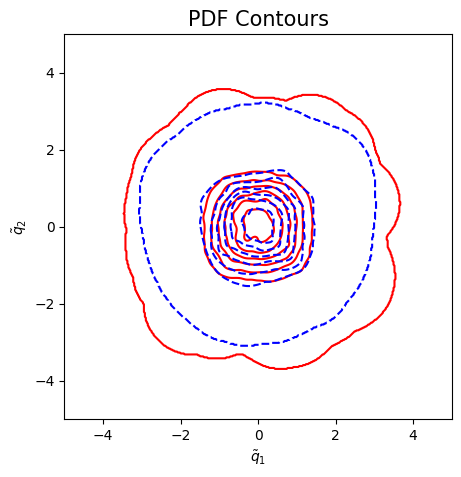

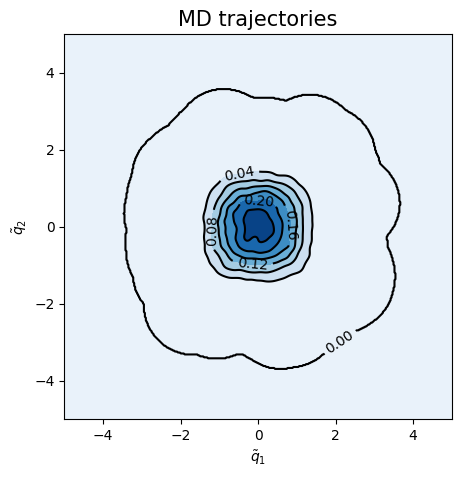

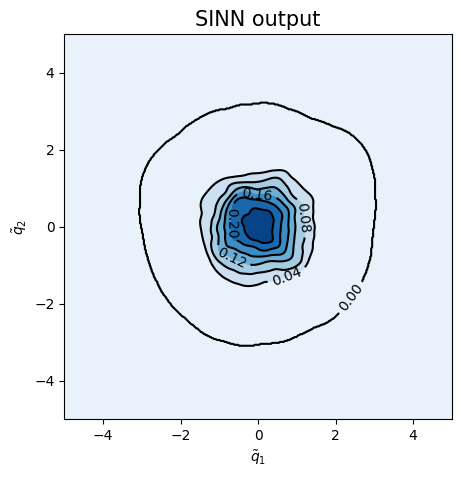

<Figure size 500x500 with 0 Axes>

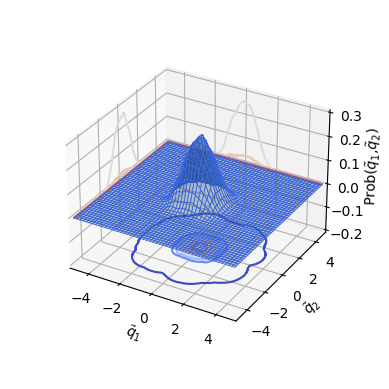

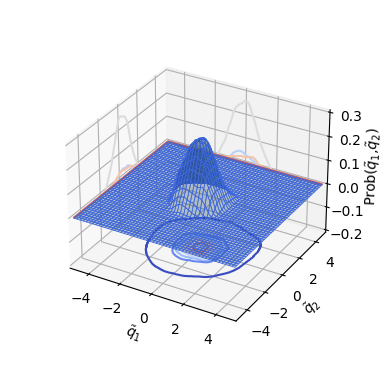

In [88]:
test7(model4)

In [89]:
### Defining SINN model
net5 = SINN(2, 10, 2, 2).to(device)

In [90]:
model5 = Model(net=net5)

In [91]:
model5.train()

[0]-th step loss: 0.5414, 0.5398, acf: 0.01361, ccf: 0.00171, pdf: 0.24788, pdf2: 0.27250, acf2: 0.00409
[50]-th step loss: 0.3922, 0.3845, acf: 0.00897, ccf: 0.00049, pdf: 0.20686, pdf2: 0.16601, acf2: 0.00219
[100]-th step loss: 0.1448, 0.1449, acf: 0.01133, ccf: 0.00036, pdf: 0.11974, pdf2: 0.01123, acf2: 0.00221
[150]-th step loss: 0.0226, 0.0224, acf: 0.00730, ccf: 0.00093, pdf: 0.00766, pdf2: 0.00406, acf2: 0.00250
[200]-th step loss: 0.0117, 0.0121, acf: 0.00528, ccf: 0.00197, pdf: 0.00185, pdf2: 0.00164, acf2: 0.00132
[250]-th step loss: 0.0099, 0.0101, acf: 0.00522, ccf: 0.00122, pdf: 0.00123, pdf2: 0.00121, acf2: 0.00126
[300]-th step loss: 0.0084, 0.0087, acf: 0.00499, ccf: 0.00068, pdf: 0.00087, pdf2: 0.00090, acf2: 0.00122
[350]-th step loss: 0.0070, 0.0072, acf: 0.00434, ccf: 0.00041, pdf: 0.00059, pdf2: 0.00067, acf2: 0.00120
[400]-th step loss: 0.0052, 0.0054, acf: 0.00299, ccf: 0.00037, pdf: 0.00037, pdf2: 0.00053, acf2: 0.00116
[450]-th step loss: 0.0026, 0.0026, acf:

[3850]-th step loss: 0.0003, 0.0003, acf: 0.00011, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00008
[3900]-th step loss: 0.0003, 0.0004, acf: 0.00011, ccf: 0.00010, pdf: 0.00004, pdf2: 0.00004, acf2: 0.00008
[3950]-th step loss: 0.0004, 0.0003, acf: 0.00009, ccf: 0.00010, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00010
[4000]-th step loss: 0.0004, 0.0003, acf: 0.00009, ccf: 0.00010, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00009
[4050]-th step loss: 0.0005, 0.0005, acf: 0.00012, ccf: 0.00019, pdf: 0.00004, pdf2: 0.00004, acf2: 0.00011
[4100]-th step loss: 0.0004, 0.0003, acf: 0.00009, ccf: 0.00010, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00008
[4150]-th step loss: 0.0004, 0.0003, acf: 0.00011, ccf: 0.00013, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00007
[4200]-th step loss: 0.0004, 0.0004, acf: 0.00012, ccf: 0.00015, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00007
[4250]-th step loss: 0.0004, 0.0003, acf: 0.00009, ccf: 0.00011, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00008
[4300]-th step loss: 0.0003,

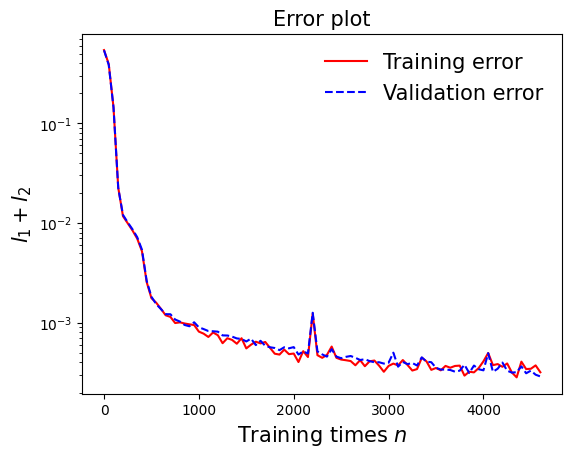

In [92]:
draw_loss(model5)

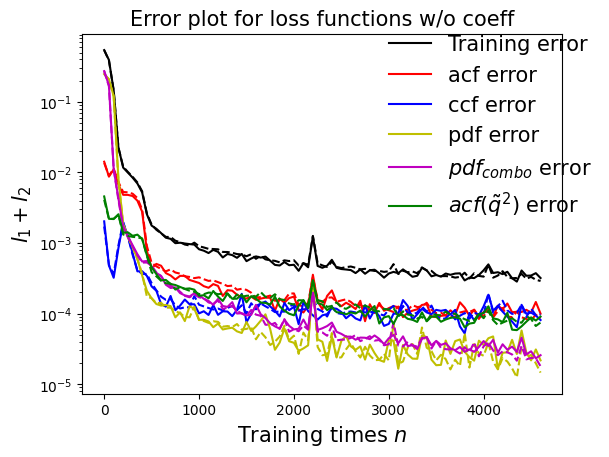

In [93]:
draw_errors(model5)

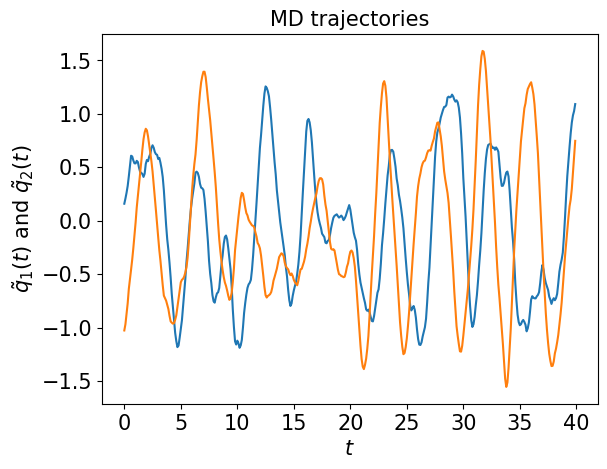

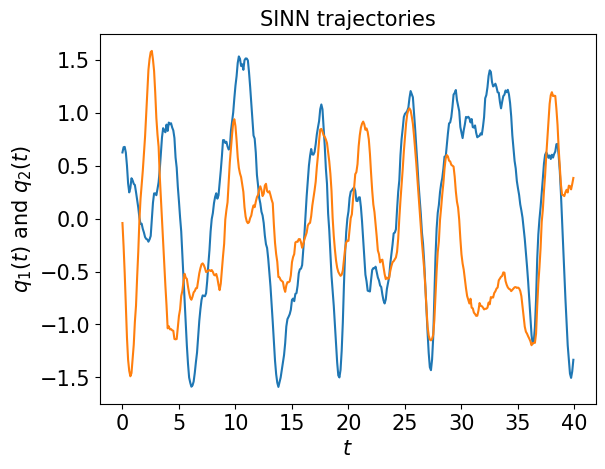

In [94]:
test1(model5)

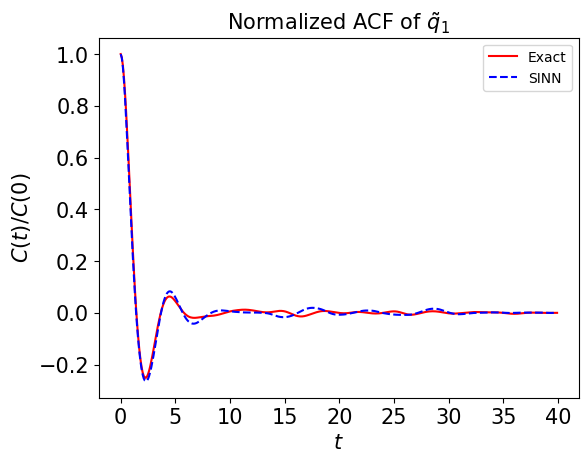

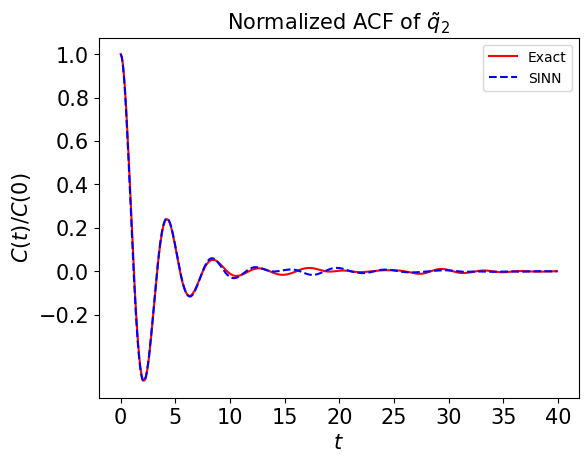

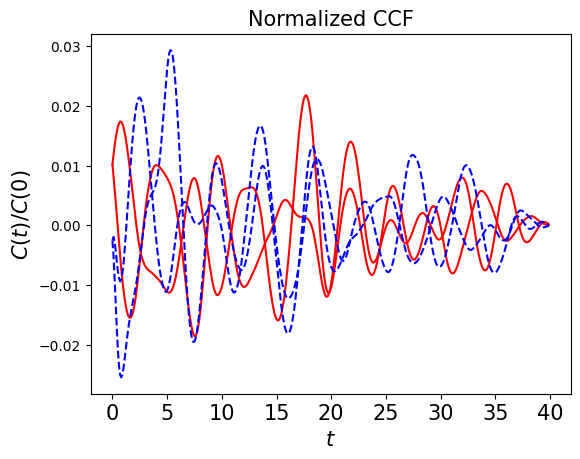

In [95]:
test2(model5)

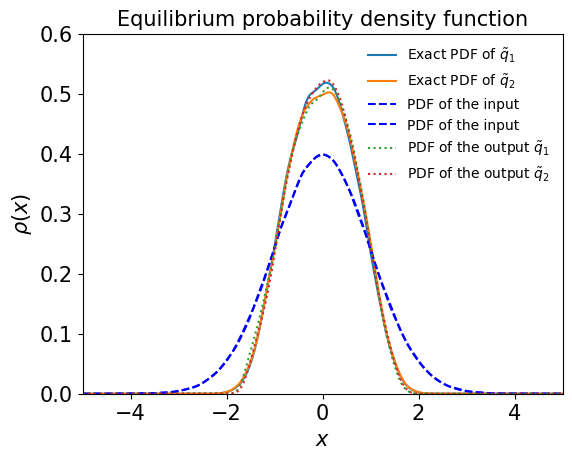

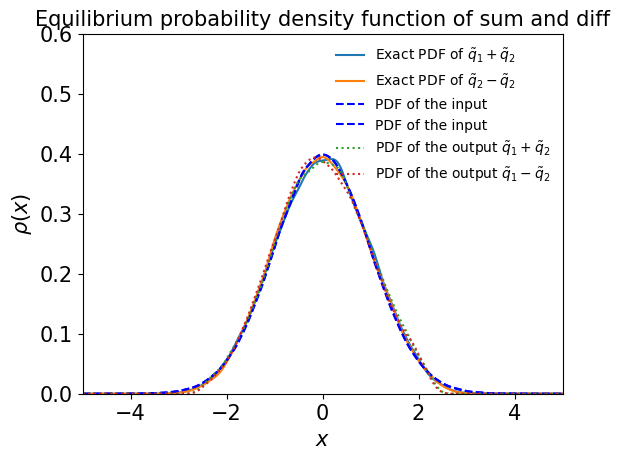

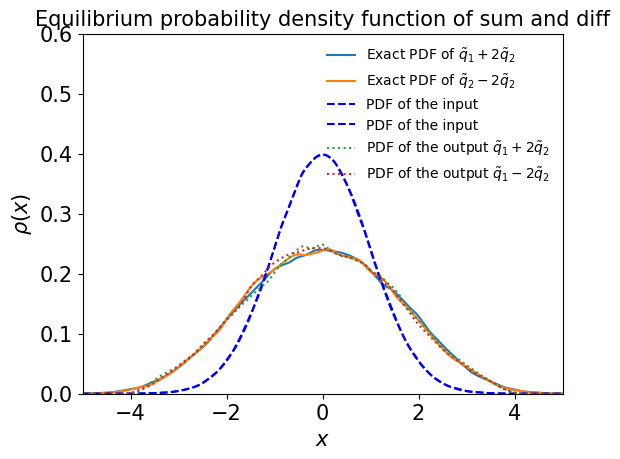

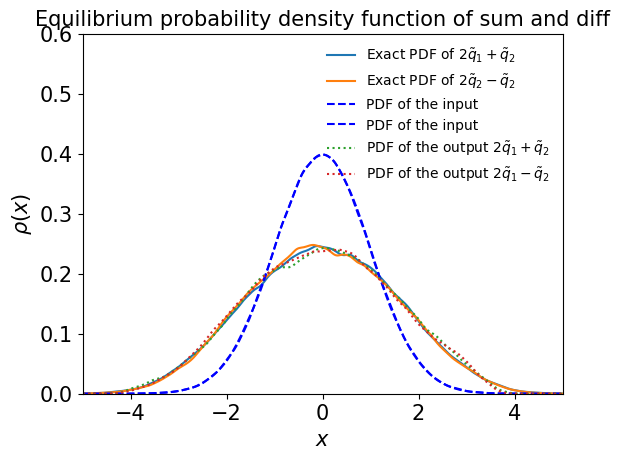

In [96]:
test3(model5)

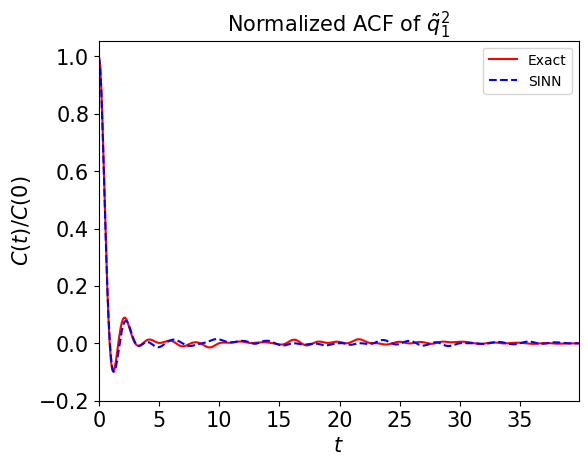

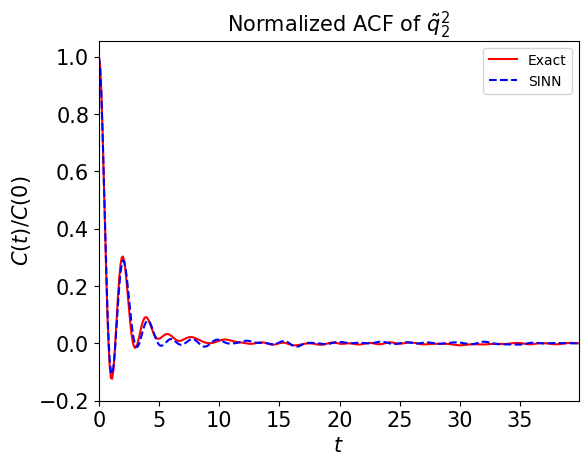

In [97]:
test4(model5)

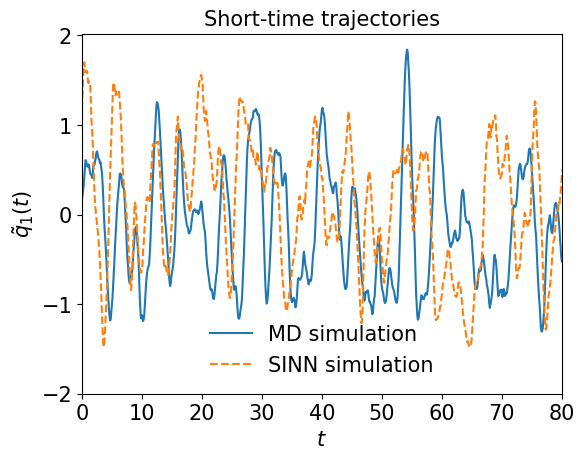

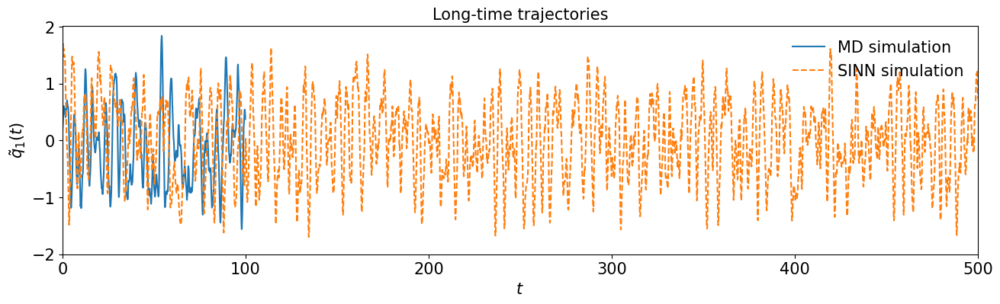

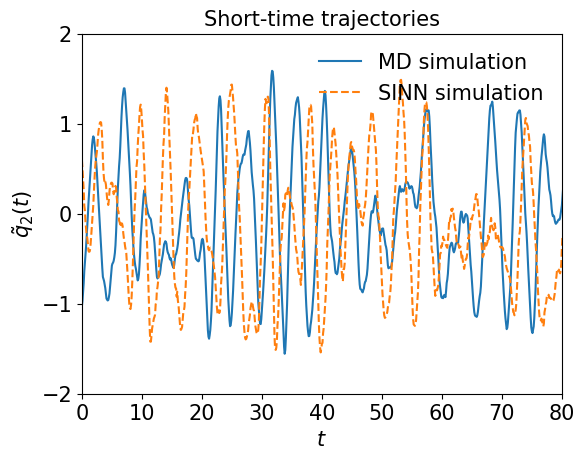

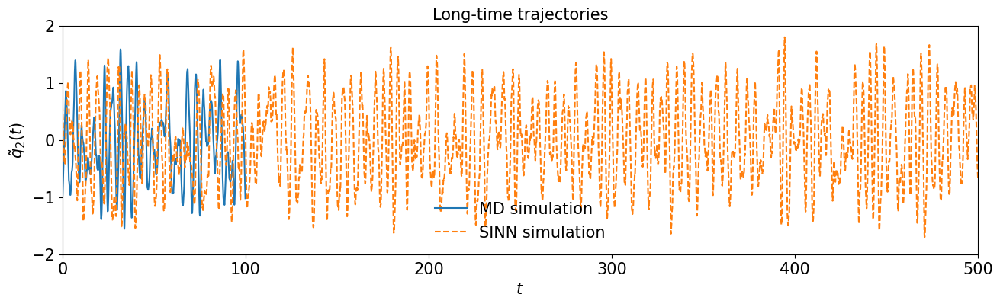

In [98]:
test5(model5)

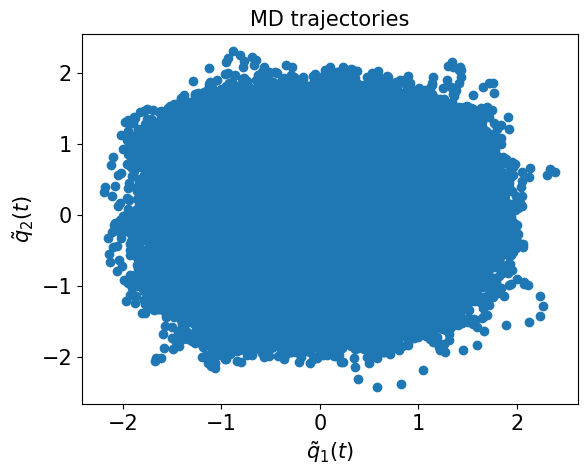

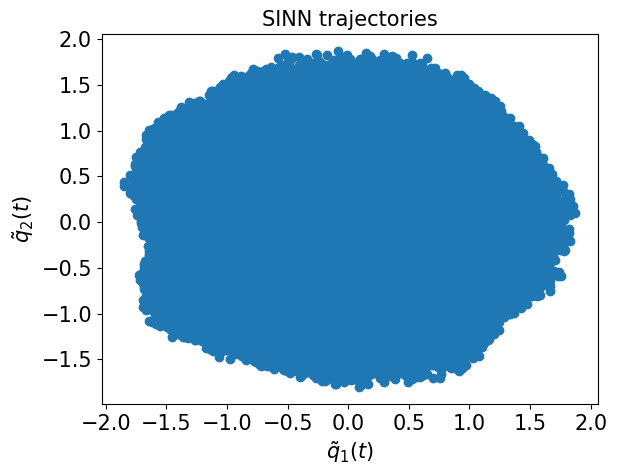

In [99]:
test6(model5)

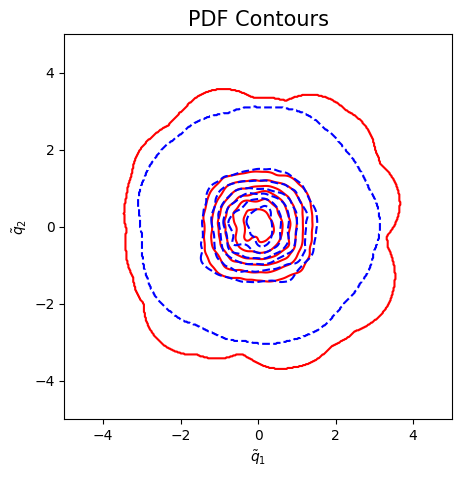

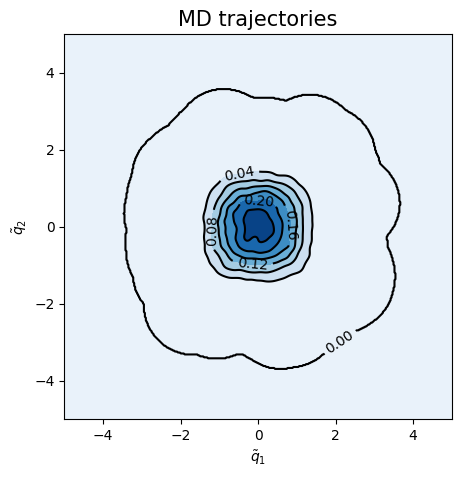

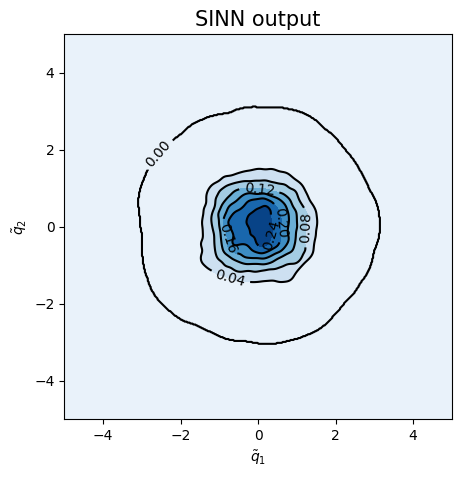

<Figure size 500x500 with 0 Axes>

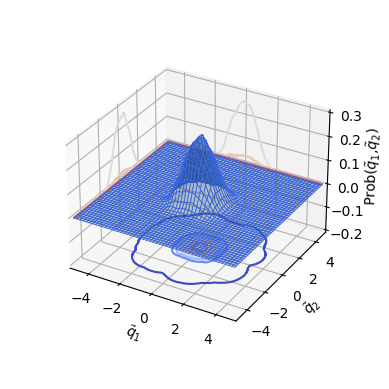

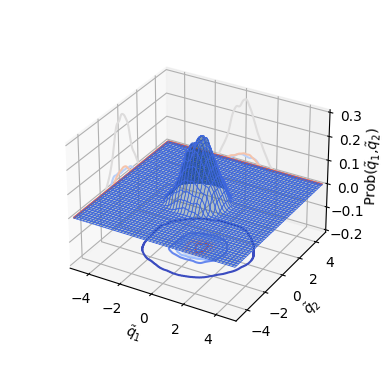

In [100]:
test7(model5)

In [101]:
### Defining SINN model
net6 = SINN(2, 10, 2, 2).to(device)

In [102]:
model6 = Model(net=net6)

In [103]:
model6.train()

[0]-th step loss: 0.5350, 0.5342, acf: 0.01026, ccf: 0.00463, pdf: 0.24770, pdf2: 0.26944, acf2: 0.00216
[50]-th step loss: 0.2850, 0.2749, acf: 0.00664, ccf: 0.00931, pdf: 0.14147, pdf2: 0.11544, acf2: 0.00203
[100]-th step loss: 0.0564, 0.0553, acf: 0.00569, ccf: 0.01110, pdf: 0.01843, pdf2: 0.01771, acf2: 0.00235
[150]-th step loss: 0.0197, 0.0196, acf: 0.00340, ccf: 0.00762, pdf: 0.00252, pdf2: 0.00420, acf2: 0.00183
[200]-th step loss: 0.0151, 0.0151, acf: 0.00452, ccf: 0.00498, pdf: 0.00145, pdf2: 0.00275, acf2: 0.00141
[250]-th step loss: 0.0123, 0.0127, acf: 0.00507, ccf: 0.00344, pdf: 0.00095, pdf2: 0.00194, acf2: 0.00126
[300]-th step loss: 0.0107, 0.0109, acf: 0.00536, ccf: 0.00225, pdf: 0.00064, pdf2: 0.00145, acf2: 0.00119
[350]-th step loss: 0.0093, 0.0094, acf: 0.00545, ccf: 0.00128, pdf: 0.00044, pdf2: 0.00110, acf2: 0.00116
[400]-th step loss: 0.0077, 0.0081, acf: 0.00512, ccf: 0.00066, pdf: 0.00031, pdf2: 0.00085, acf2: 0.00113
[450]-th step loss: 0.0061, 0.0063, acf:

[3850]-th step loss: 0.0005, 0.0006, acf: 0.00021, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00009, acf2: 0.00014
[3900]-th step loss: 0.0005, 0.0006, acf: 0.00021, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00008, acf2: 0.00014
[3950]-th step loss: 0.0005, 0.0006, acf: 0.00022, ccf: 0.00012, pdf: 0.00005, pdf2: 0.00008, acf2: 0.00013
[4000]-th step loss: 0.0005, 0.0006, acf: 0.00020, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00008, acf2: 0.00013
[4050]-th step loss: 0.0005, 0.0006, acf: 0.00020, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00008, acf2: 0.00013
[4100]-th step loss: 0.0005, 0.0005, acf: 0.00019, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00007, acf2: 0.00013
[4150]-th step loss: 0.0005, 0.0005, acf: 0.00019, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00007, acf2: 0.00013
[4200]-th step loss: 0.0005, 0.0005, acf: 0.00018, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00007, acf2: 0.00013
[4250]-th step loss: 0.0005, 0.0005, acf: 0.00018, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00007, acf2: 0.00012
[4300]-th step loss: 0.0005,

[7650]-th step loss: 0.0003, 0.0004, acf: 0.00011, ccf: 0.00015, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00006
[7700]-th step loss: 0.0003, 0.0003, acf: 0.00011, ccf: 0.00012, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00005
[7750]-th step loss: 0.0003, 0.0003, acf: 0.00009, ccf: 0.00012, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00005
[7800]-th step loss: 0.0003, 0.0011, acf: 0.00037, ccf: 0.00048, pdf: 0.00006, pdf2: 0.00010, acf2: 0.00012
[7850]-th step loss: 0.0003, 0.0003, acf: 0.00009, ccf: 0.00012, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00005
[7900]-th step loss: 0.0003, 0.0003, acf: 0.00009, ccf: 0.00011, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00005
[7950]-th step loss: 0.0002, 0.0003, acf: 0.00009, ccf: 0.00011, pdf: 0.00001, pdf2: 0.00002, acf2: 0.00005
Training finished
Training time: 476.24
Training time per iteration: 0.06
Number of Iterations:7951


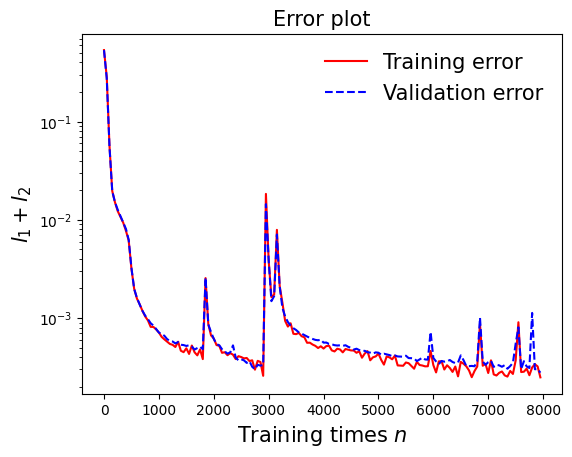

In [104]:
draw_loss(model6)

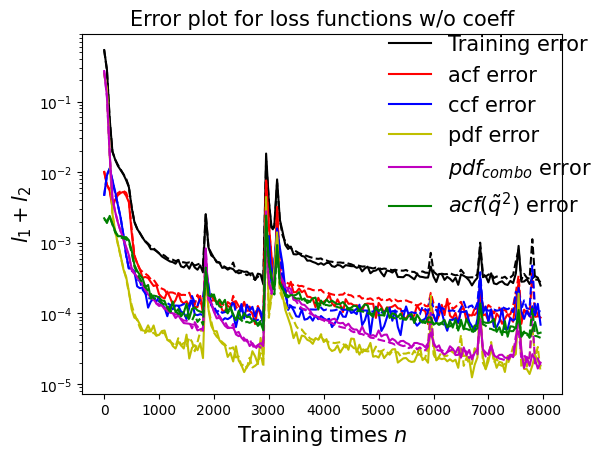

In [105]:
draw_errors(model6)

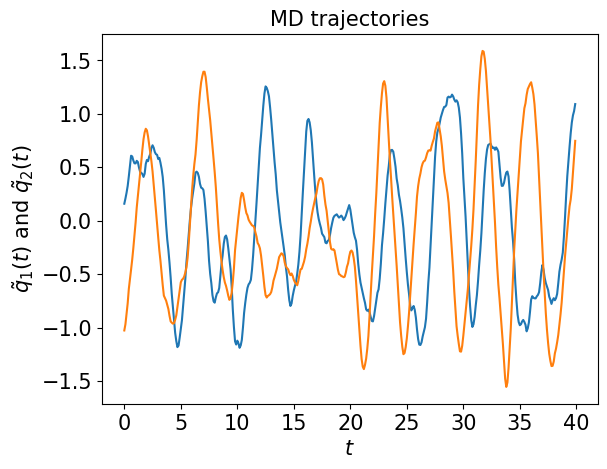

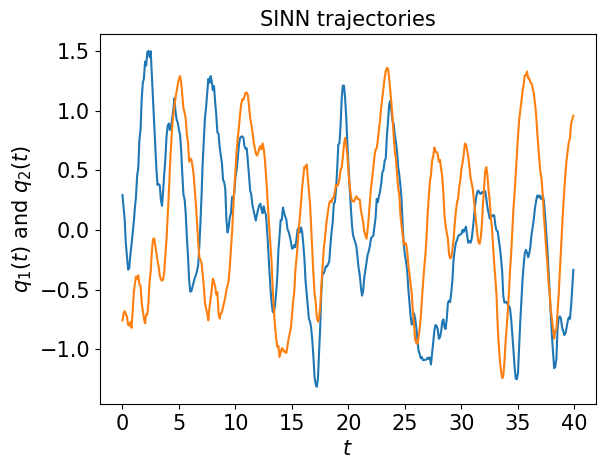

In [106]:
test1(model6)

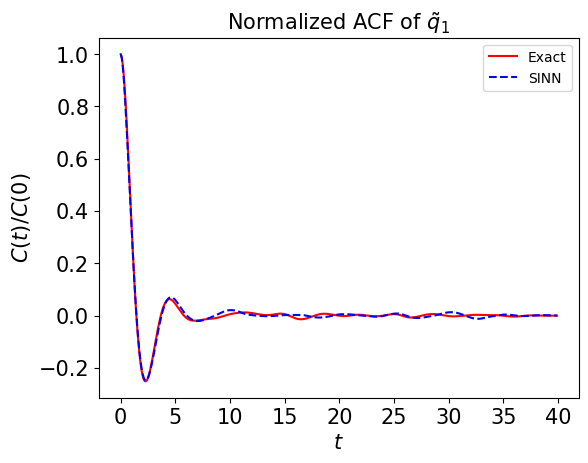

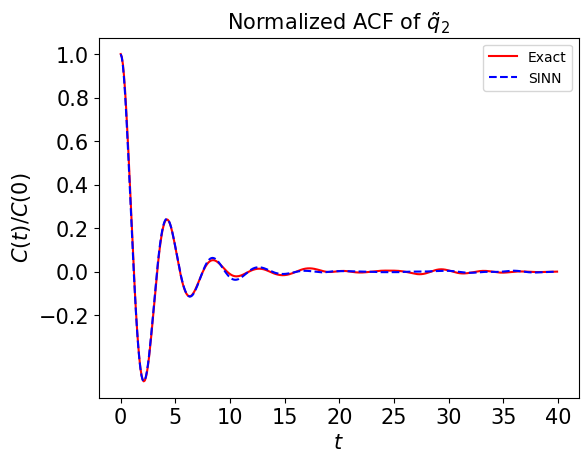

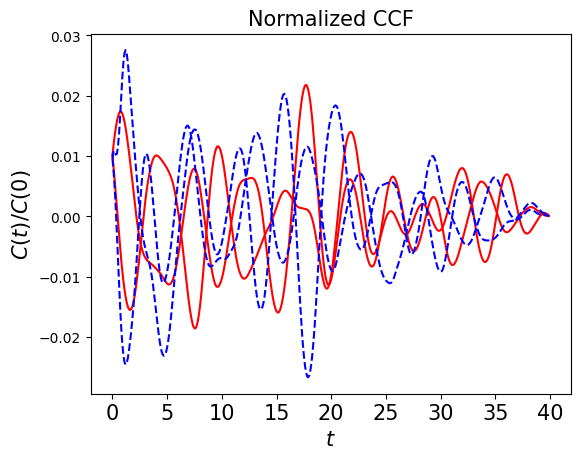

In [107]:
test2(model6)

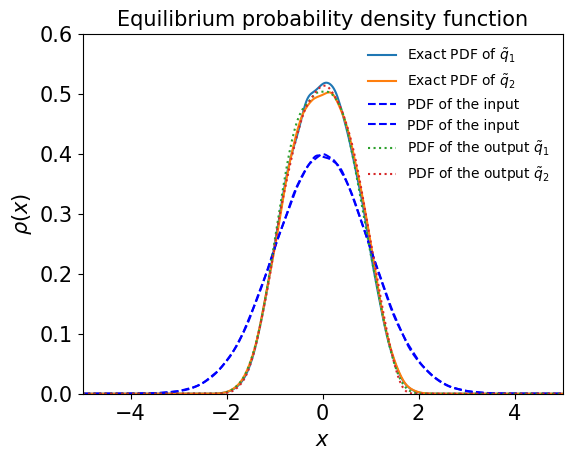

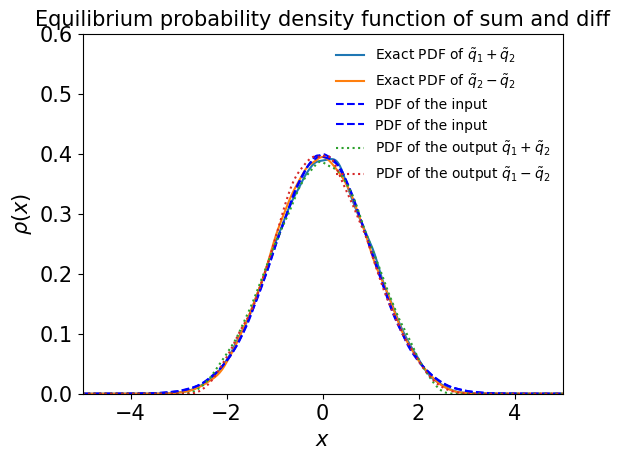

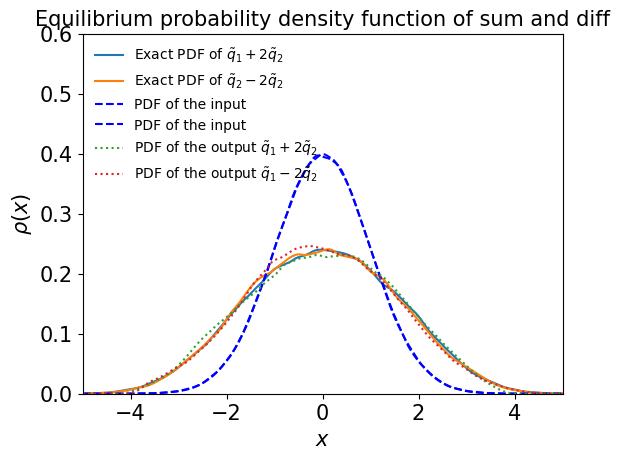

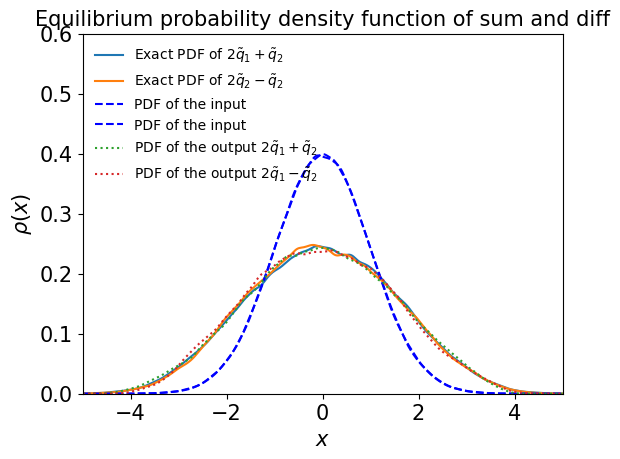

In [108]:
test3(model6)

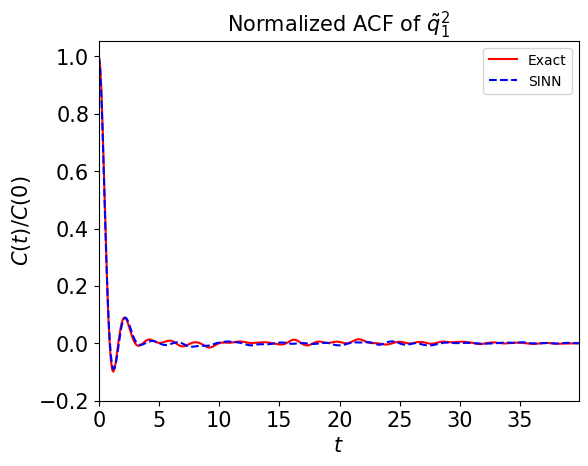

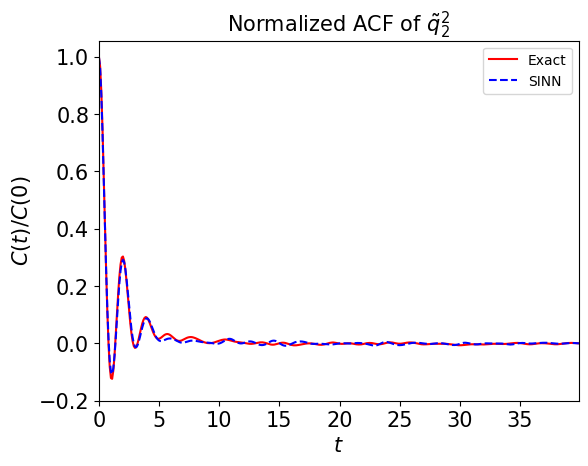

In [109]:
test4(model6)

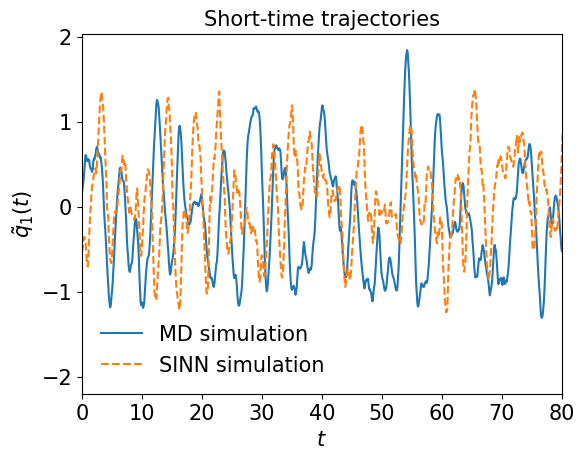

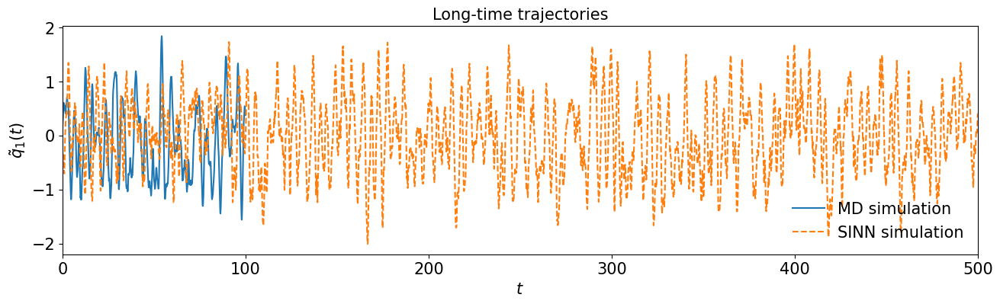

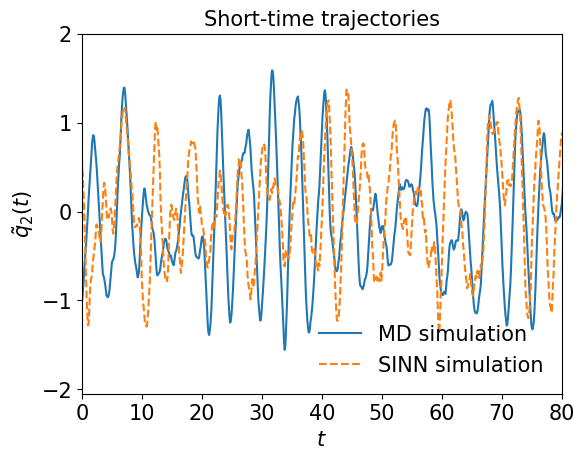

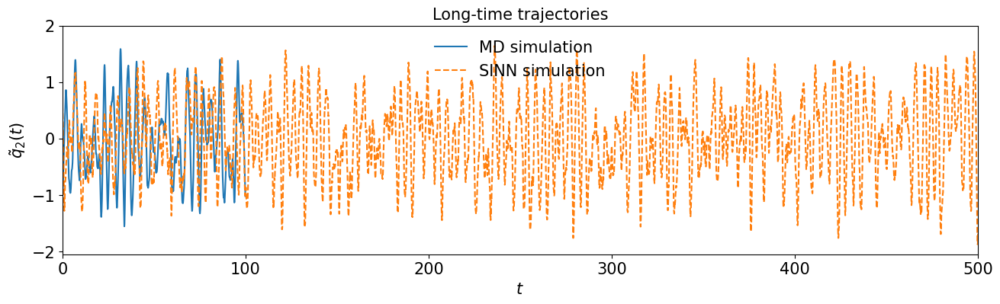

In [110]:
test5(model6)

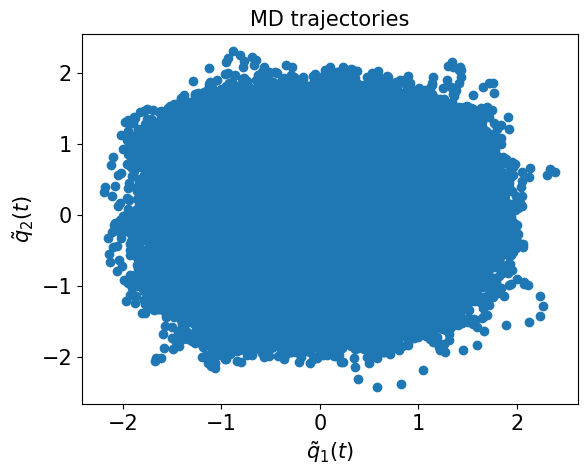

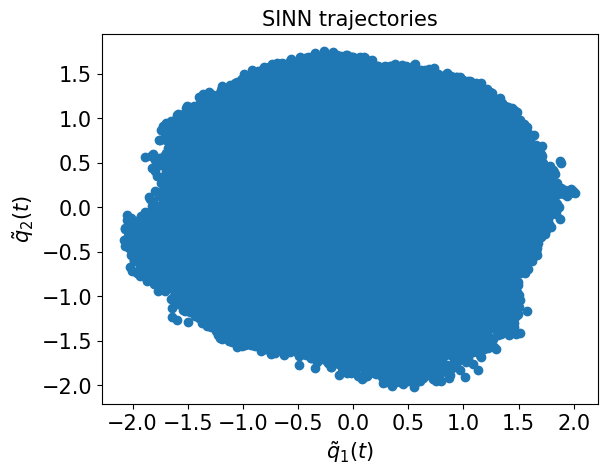

In [111]:
test6(model6)

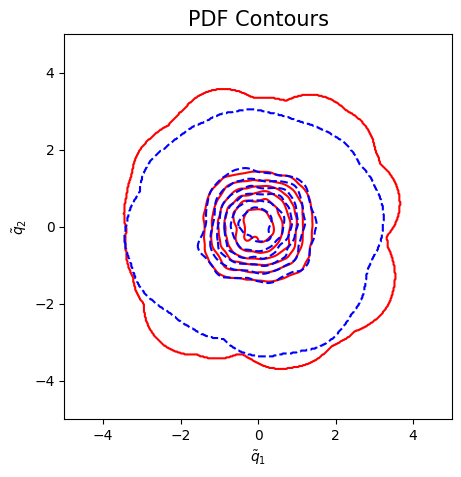

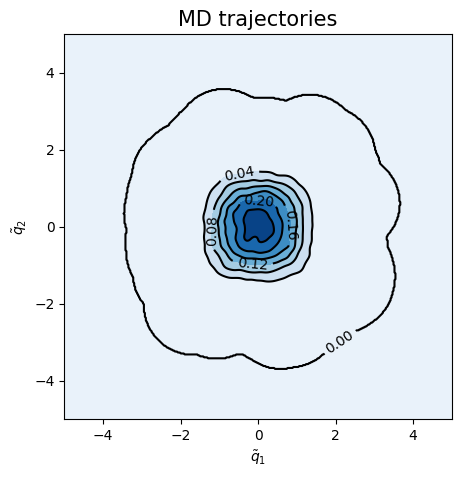

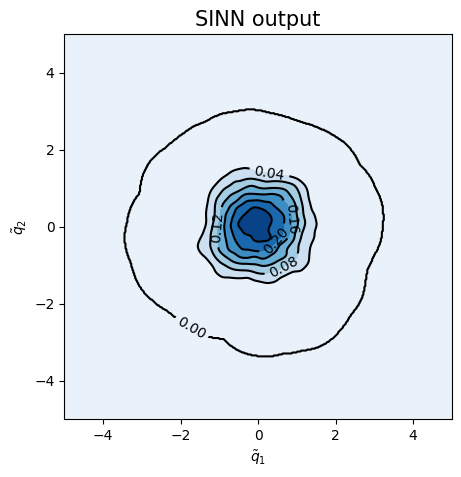

<Figure size 500x500 with 0 Axes>

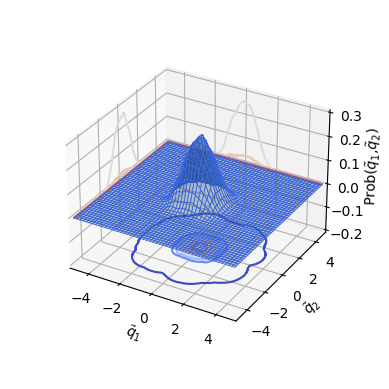

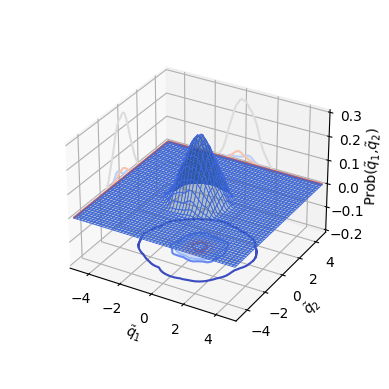

In [112]:
test7(model6)

In [113]:
### Defining SINN model
net7 = SINN(2, 10, 2, 2).to(device)

In [114]:
model7 = Model(net=net7)

In [115]:
model7.train()

[0]-th step loss: 0.5343, 0.5328, acf: 0.01041, ccf: 0.00181, pdf: 0.24817, pdf2: 0.27018, acf2: 0.00225
[50]-th step loss: 0.2482, 0.2399, acf: 0.00682, ccf: 0.00030, pdf: 0.15632, pdf2: 0.07444, acf2: 0.00206
[100]-th step loss: 0.0816, 0.0786, acf: 0.00926, ccf: 0.00066, pdf: 0.04740, pdf2: 0.01719, acf2: 0.00413
[150]-th step loss: 0.0278, 0.0275, acf: 0.00541, ccf: 0.00068, pdf: 0.01128, pdf2: 0.00805, acf2: 0.00210
[200]-th step loss: 0.0128, 0.0127, acf: 0.00416, ccf: 0.00161, pdf: 0.00258, pdf2: 0.00288, acf2: 0.00143
[250]-th step loss: 0.0087, 0.0086, acf: 0.00300, ccf: 0.00158, pdf: 0.00122, pdf2: 0.00164, acf2: 0.00112
[300]-th step loss: 0.0056, 0.0056, acf: 0.00177, ccf: 0.00090, pdf: 0.00094, pdf2: 0.00112, acf2: 0.00091
[350]-th step loss: 0.0038, 0.0038, acf: 0.00124, ccf: 0.00032, pdf: 0.00061, pdf2: 0.00092, acf2: 0.00076
[400]-th step loss: 0.0026, 0.0029, acf: 0.00084, ccf: 0.00021, pdf: 0.00044, pdf2: 0.00075, acf2: 0.00063
[450]-th step loss: 0.0019, 0.0019, acf:

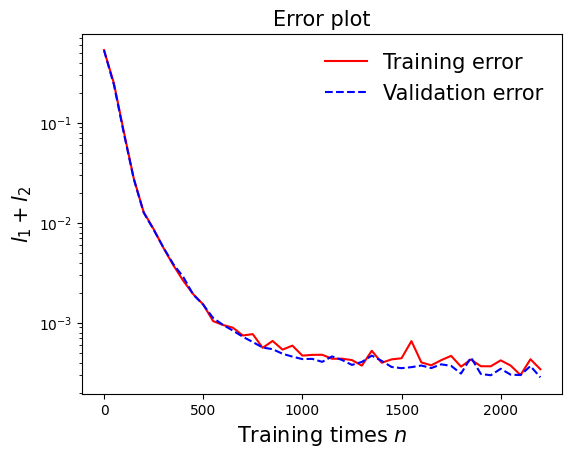

In [116]:
draw_loss(model7)

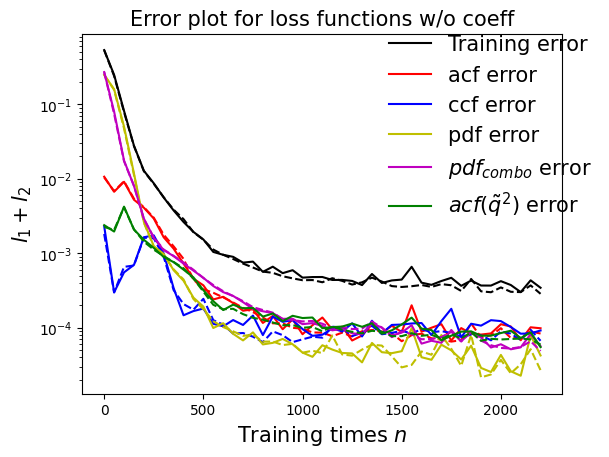

In [117]:
draw_errors(model7)

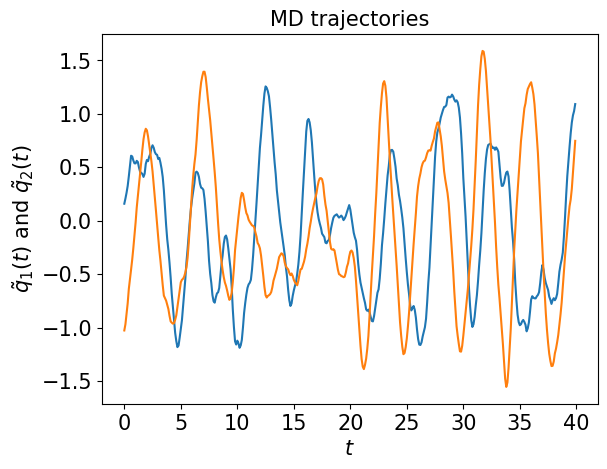

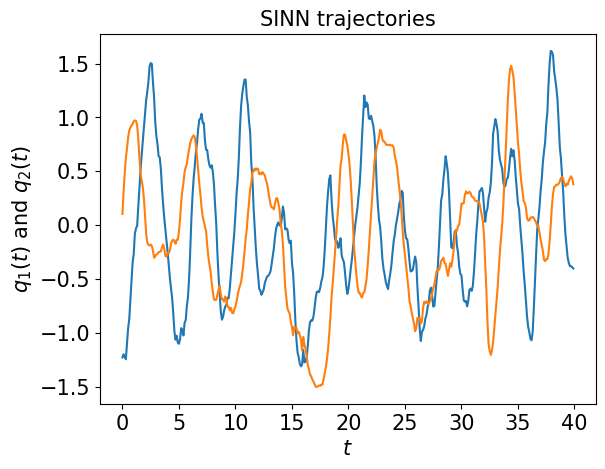

In [118]:
test1(model7)

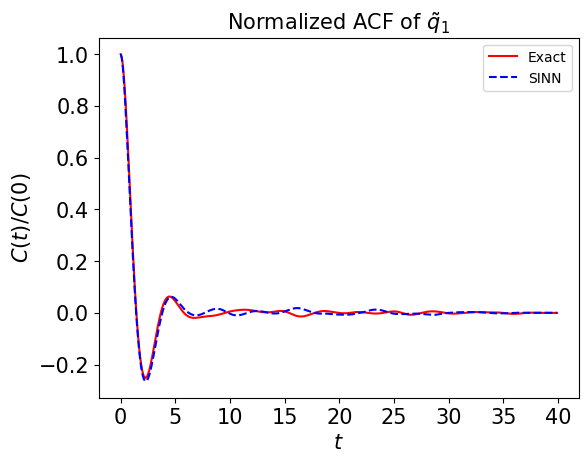

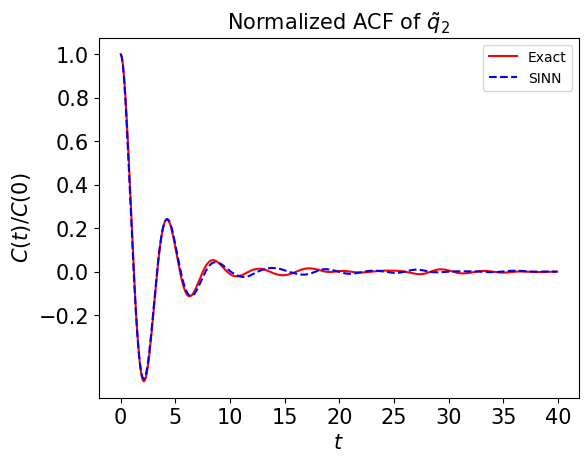

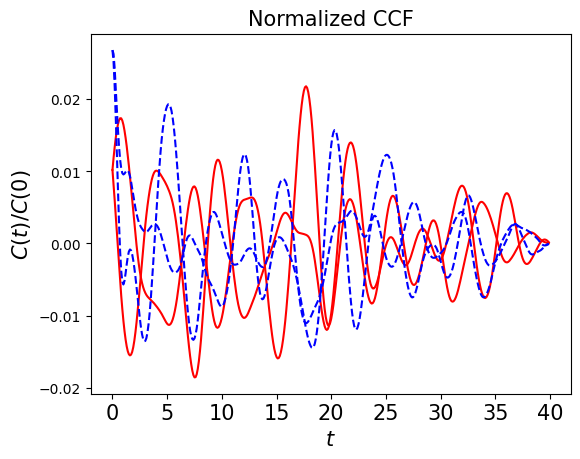

In [119]:
test2(model7)

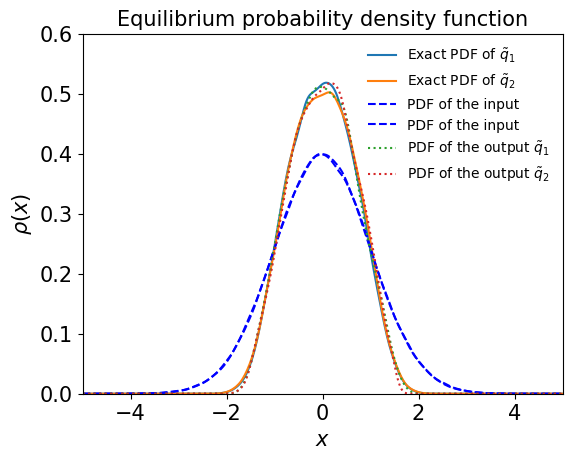

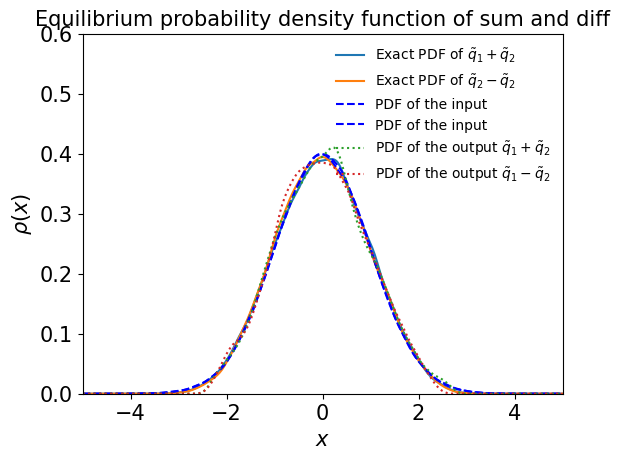

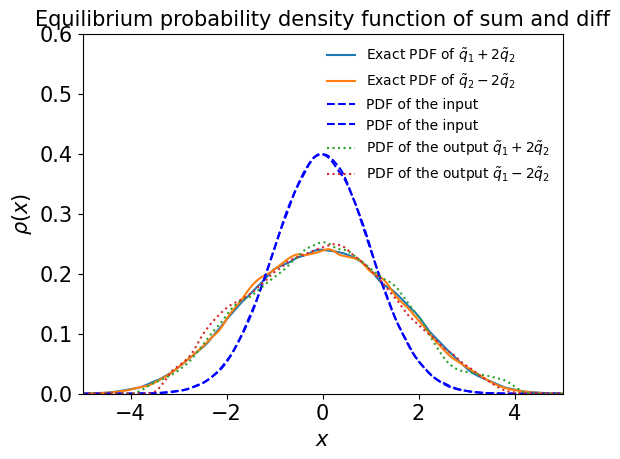

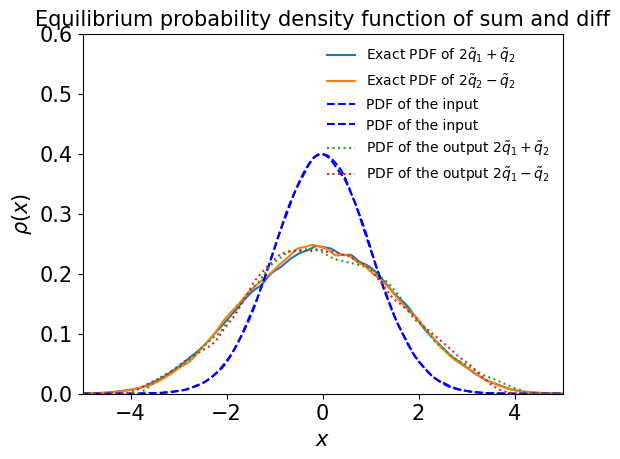

In [120]:
test3(model7)

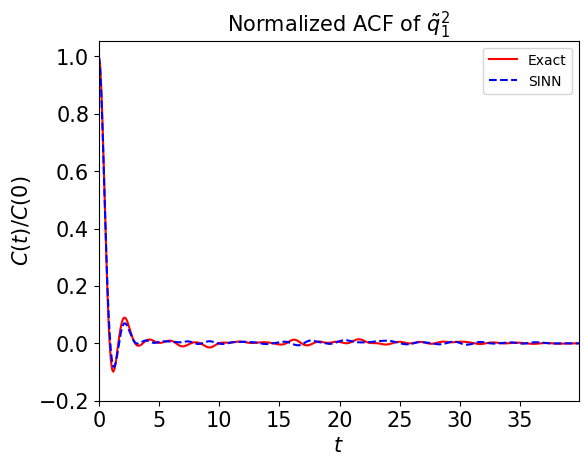

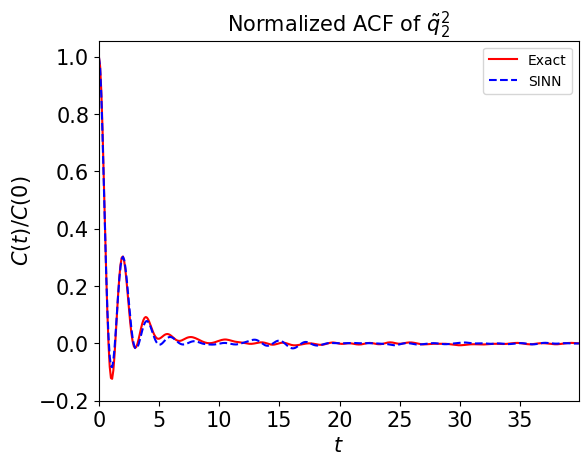

In [121]:
test4(model7)

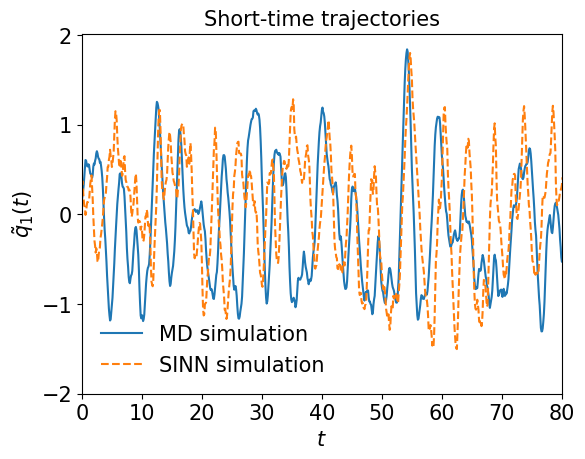

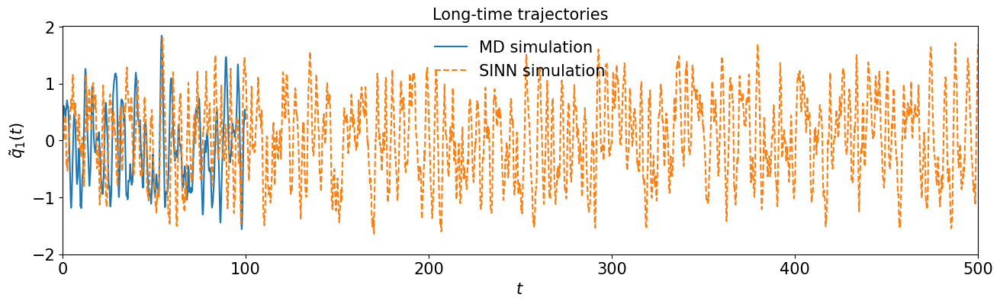

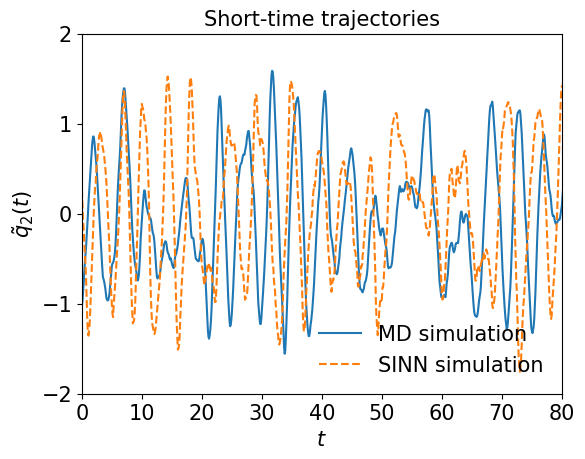

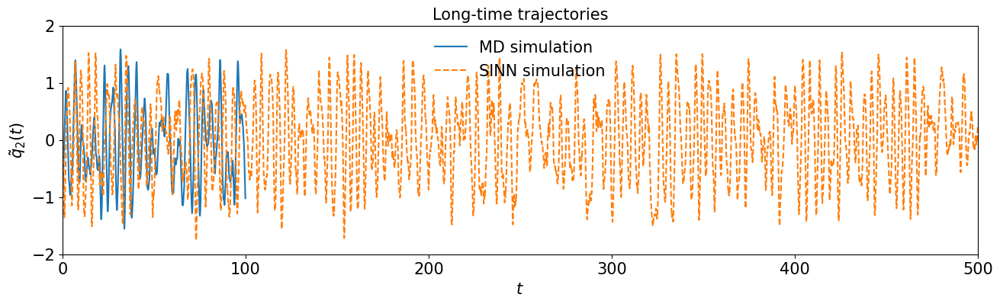

In [122]:
test5(model7)

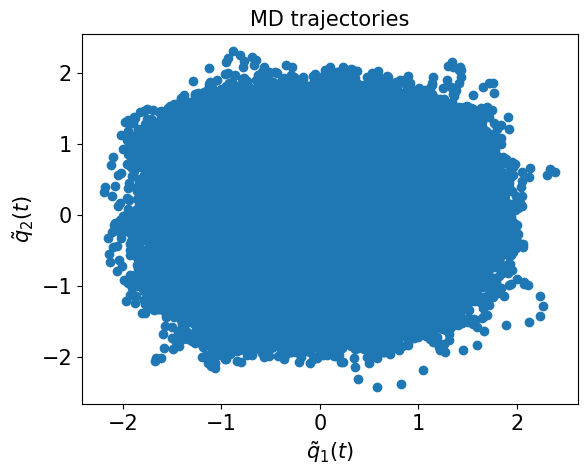

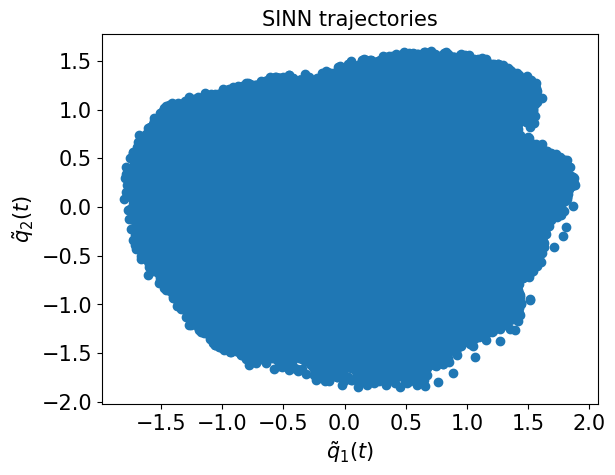

In [123]:
test6(model7)

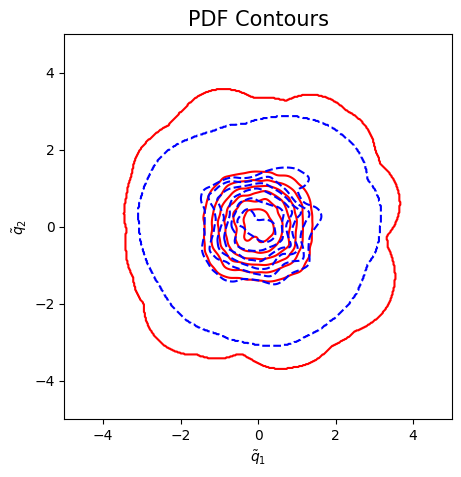

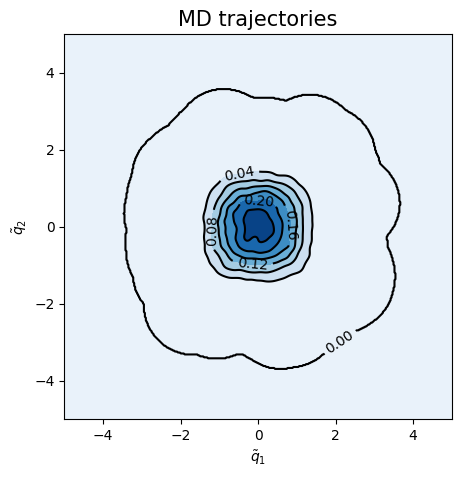

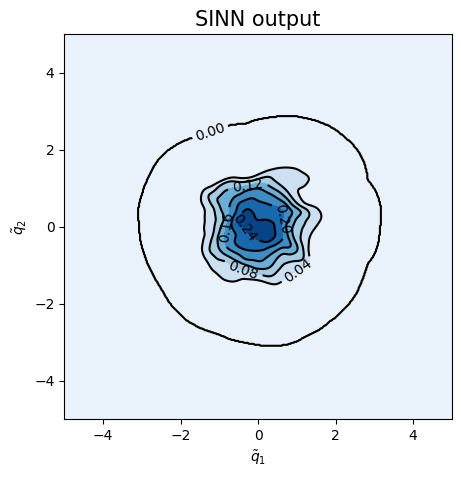

<Figure size 500x500 with 0 Axes>

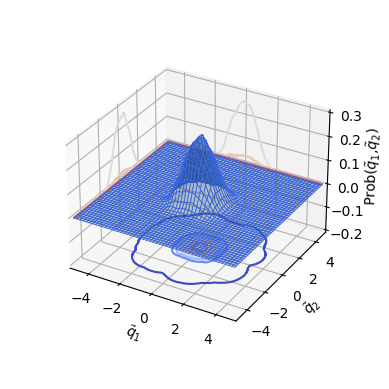

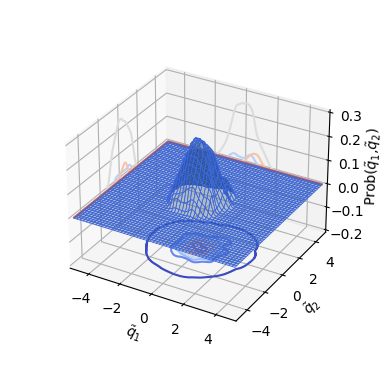

In [124]:
test7(model7)

In [125]:
### Defining SINN model
net8 = SINN(2, 10, 2, 2).to(device)

In [126]:
model8 = Model(net=net8)

In [127]:
model8.train()

[0]-th step loss: 0.5425, 0.5413, acf: 0.01533, ccf: 0.00068, pdf: 0.24796, pdf2: 0.27200, acf2: 0.00529
[50]-th step loss: 0.3857, 0.3734, acf: 0.00730, ccf: 0.00044, pdf: 0.20248, pdf2: 0.16168, acf2: 0.00149
[100]-th step loss: 0.0414, 0.0400, acf: 0.00525, ccf: 0.00734, pdf: 0.01680, pdf2: 0.00789, acf2: 0.00275
[150]-th step loss: 0.0226, 0.0222, acf: 0.00252, ccf: 0.00721, pdf: 0.00710, pdf2: 0.00374, acf2: 0.00160
[200]-th step loss: 0.0166, 0.0165, acf: 0.00336, ccf: 0.00510, pdf: 0.00421, pdf2: 0.00260, acf2: 0.00124
[250]-th step loss: 0.0125, 0.0128, acf: 0.00376, ccf: 0.00348, pdf: 0.00257, pdf2: 0.00202, acf2: 0.00101
[300]-th step loss: 0.0089, 0.0090, acf: 0.00282, ccf: 0.00232, pdf: 0.00155, pdf2: 0.00136, acf2: 0.00099
[350]-th step loss: 0.0054, 0.0053, acf: 0.00135, ccf: 0.00098, pdf: 0.00105, pdf2: 0.00106, acf2: 0.00089
[400]-th step loss: 0.0031, 0.0031, acf: 0.00048, ccf: 0.00045, pdf: 0.00063, pdf2: 0.00083, acf2: 0.00069
[450]-th step loss: 0.0022, 0.0022, acf:

[3850]-th step loss: 0.0006, 0.0006, acf: 0.00018, ccf: 0.00012, pdf: 0.00004, pdf2: 0.00010, acf2: 0.00014
[3900]-th step loss: 0.0005, 0.0005, acf: 0.00017, ccf: 0.00011, pdf: 0.00003, pdf2: 0.00009, acf2: 0.00013
[3950]-th step loss: 0.0005, 0.0005, acf: 0.00016, ccf: 0.00010, pdf: 0.00004, pdf2: 0.00008, acf2: 0.00011
[4000]-th step loss: 0.0005, 0.0005, acf: 0.00015, ccf: 0.00010, pdf: 0.00003, pdf2: 0.00008, acf2: 0.00012
[4050]-th step loss: 0.0004, 0.0005, acf: 0.00014, ccf: 0.00011, pdf: 0.00003, pdf2: 0.00008, acf2: 0.00011
[4100]-th step loss: 0.0004, 0.0005, acf: 0.00014, ccf: 0.00010, pdf: 0.00003, pdf2: 0.00007, acf2: 0.00012
[4150]-th step loss: 0.0004, 0.0004, acf: 0.00013, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00006, acf2: 0.00012
[4200]-th step loss: 0.0004, 0.0004, acf: 0.00013, ccf: 0.00009, pdf: 0.00003, pdf2: 0.00006, acf2: 0.00011
[4250]-th step loss: 0.0004, 0.0004, acf: 0.00013, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00005, acf2: 0.00012
[4300]-th step loss: 0.0004,

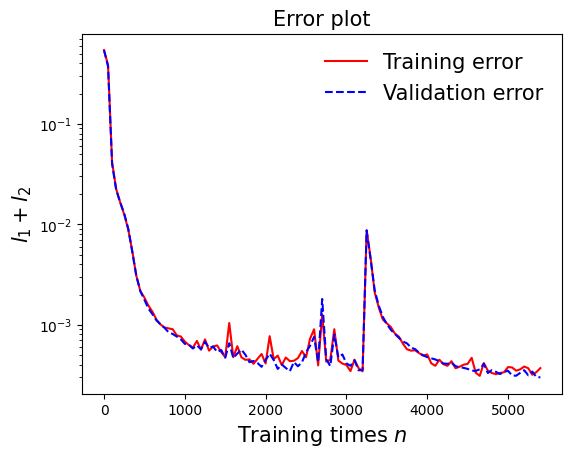

In [128]:
draw_loss(model8)

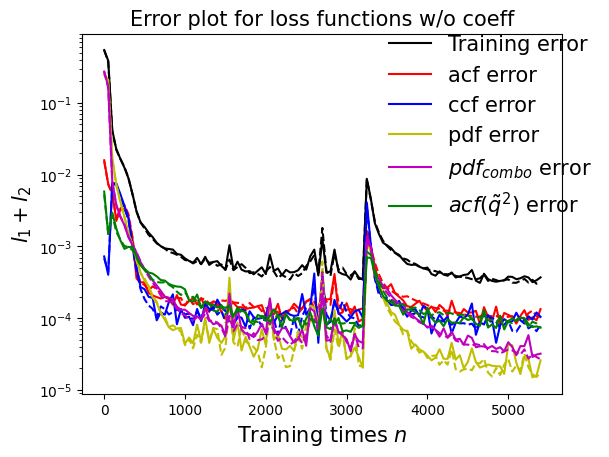

In [129]:
draw_errors(model8)

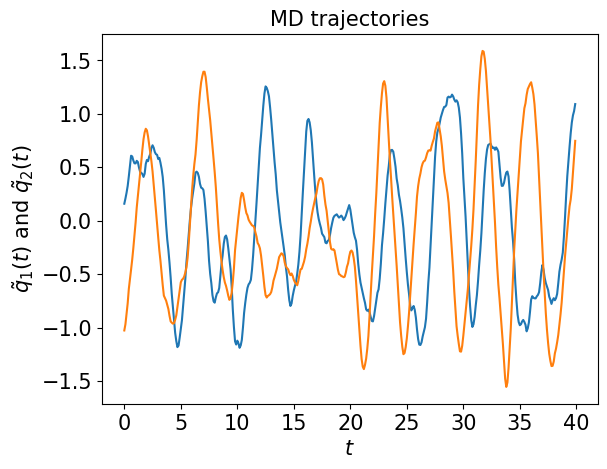

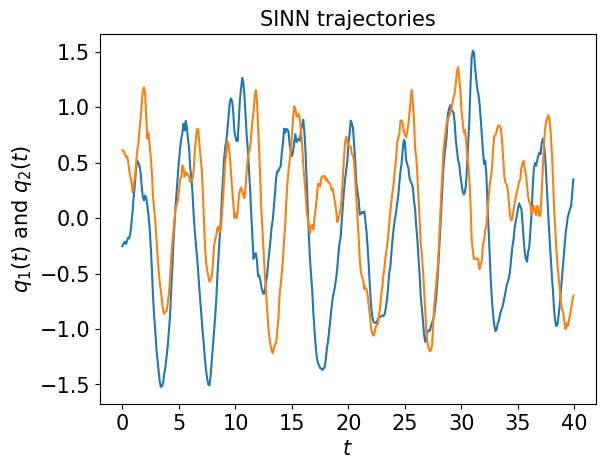

In [130]:
test1(model8)

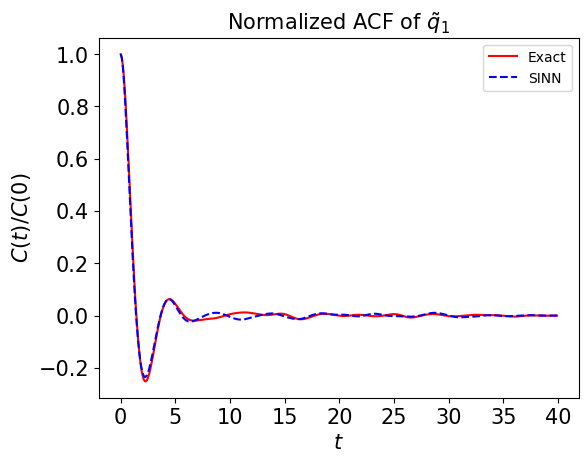

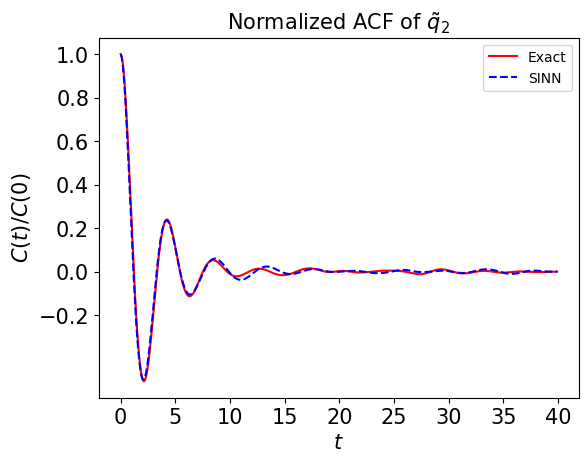

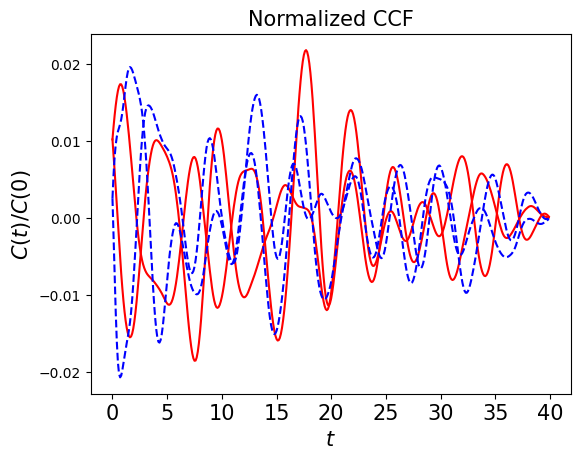

In [131]:
test2(model8)

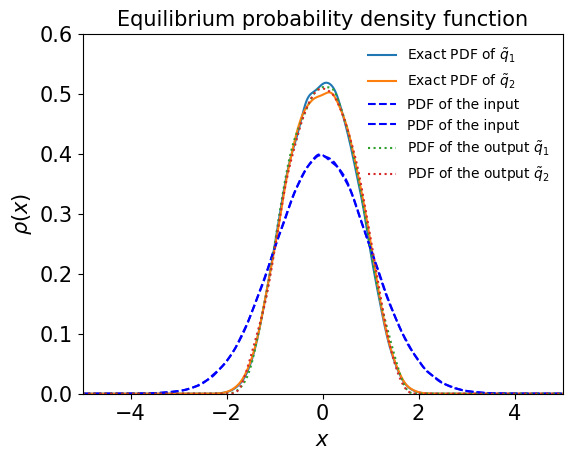

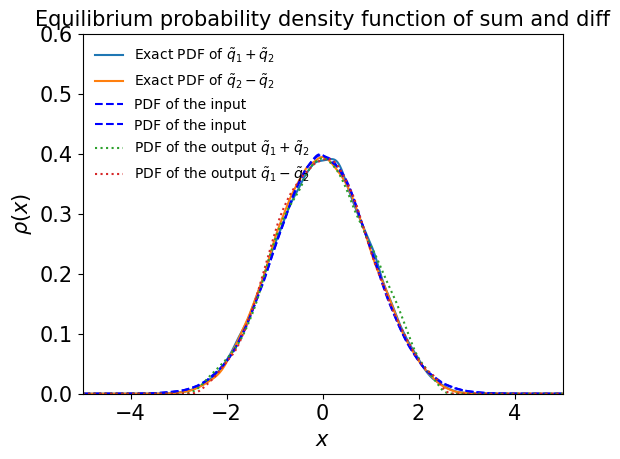

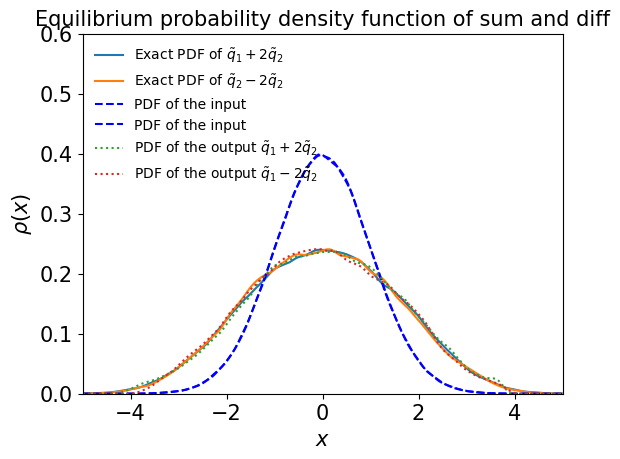

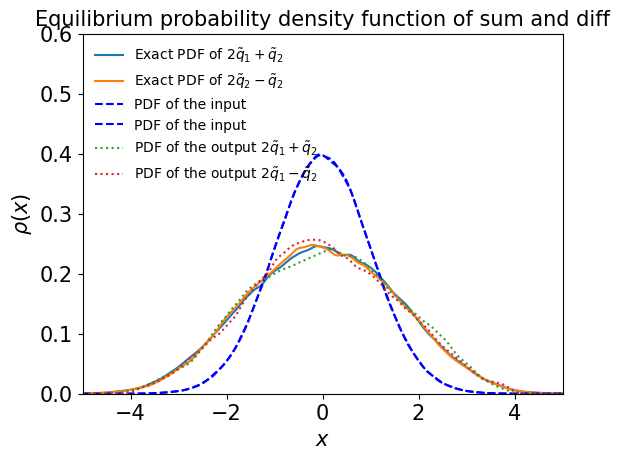

In [132]:
test3(model8)

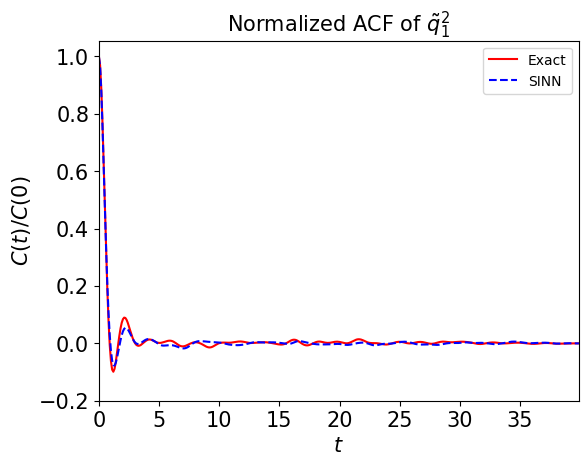

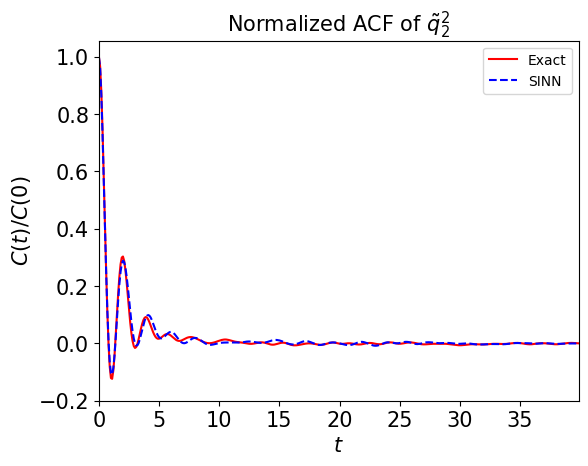

In [133]:
test4(model8)

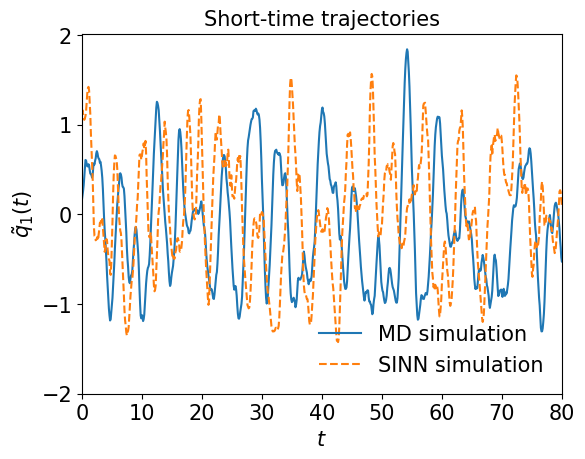

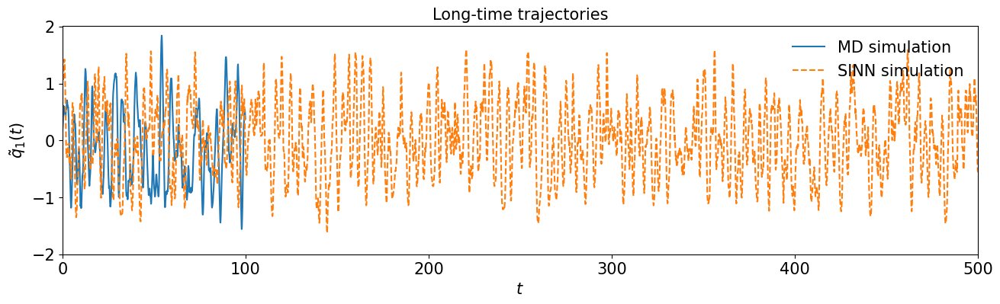

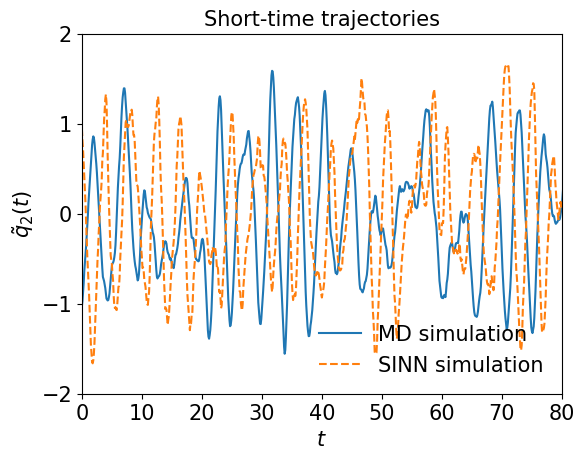

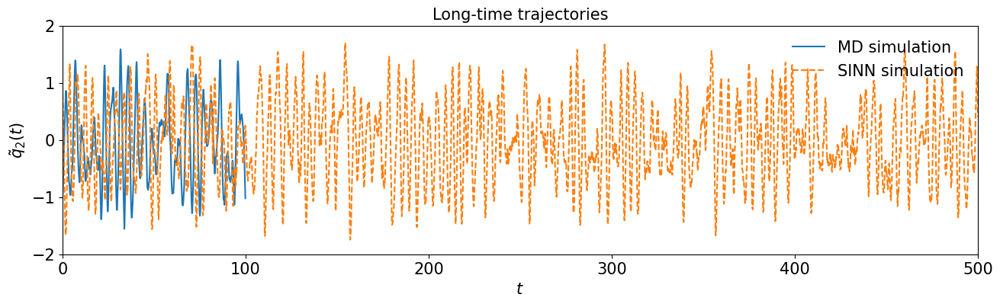

In [134]:
test5(model8)

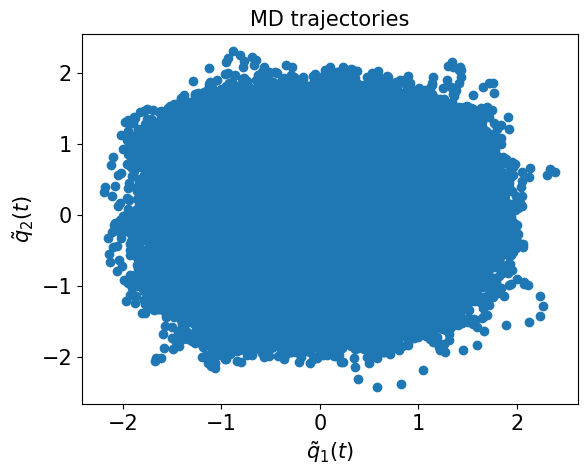

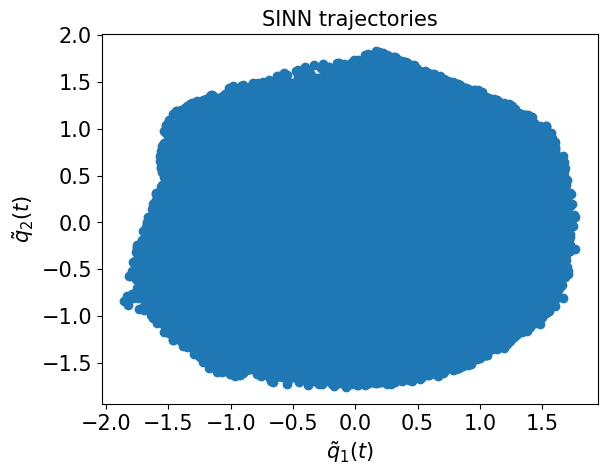

In [135]:
test6(model8)

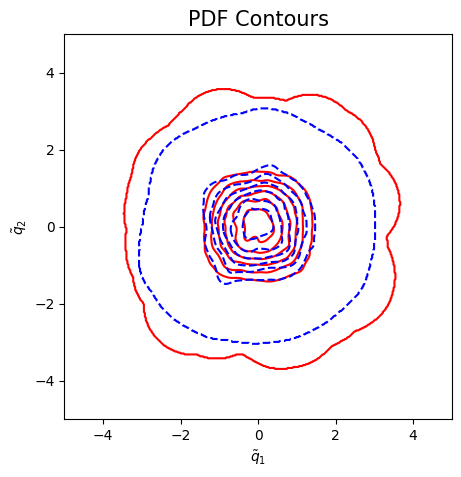

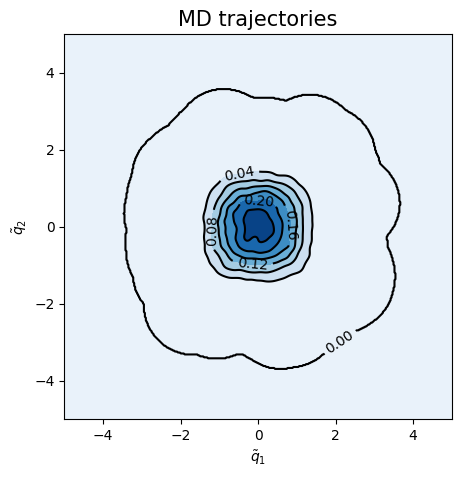

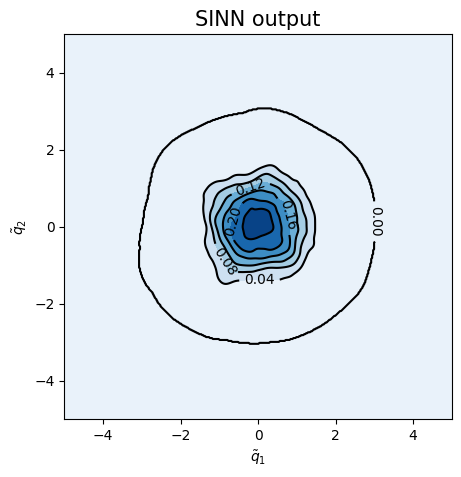

<Figure size 500x500 with 0 Axes>

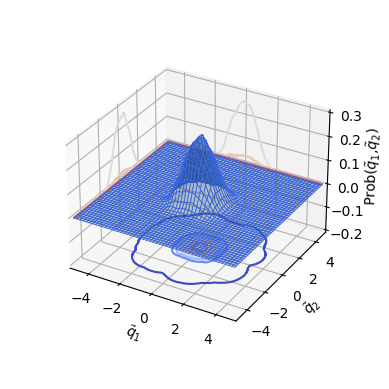

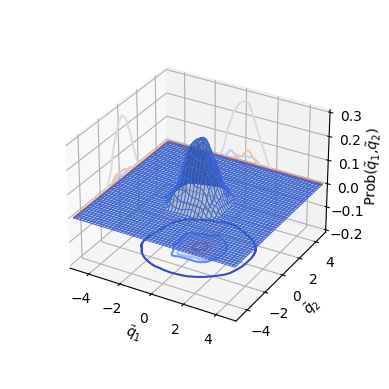

In [136]:
test7(model8)

In [137]:
### Defining SINN model
net9 = SINN(2, 10, 2, 2).to(device)

In [138]:
model9 = Model(net=net9)

In [139]:
model9.train()

[0]-th step loss: 0.5346, 0.5335, acf: 0.01176, ccf: 0.00341, pdf: 0.24714, pdf2: 0.26827, acf2: 0.00289
[50]-th step loss: 0.2997, 0.2903, acf: 0.00789, ccf: 0.00469, pdf: 0.15850, pdf2: 0.11784, acf2: 0.00137
[100]-th step loss: 0.0304, 0.0294, acf: 0.00691, ccf: 0.00578, pdf: 0.00764, pdf2: 0.00714, acf2: 0.00192
[150]-th step loss: 0.0126, 0.0125, acf: 0.00593, ccf: 0.00161, pdf: 0.00117, pdf2: 0.00243, acf2: 0.00136
[200]-th step loss: 0.0107, 0.0107, acf: 0.00557, ccf: 0.00132, pdf: 0.00074, pdf2: 0.00187, acf2: 0.00124
[250]-th step loss: 0.0094, 0.0096, acf: 0.00541, ccf: 0.00086, pdf: 0.00054, pdf2: 0.00152, acf2: 0.00122
[300]-th step loss: 0.0084, 0.0085, acf: 0.00511, ccf: 0.00051, pdf: 0.00042, pdf2: 0.00122, acf2: 0.00120
[350]-th step loss: 0.0069, 0.0071, acf: 0.00442, ccf: 0.00034, pdf: 0.00032, pdf2: 0.00088, acf2: 0.00118
[400]-th step loss: 0.0050, 0.0049, acf: 0.00252, ccf: 0.00051, pdf: 0.00024, pdf2: 0.00055, acf2: 0.00105
[450]-th step loss: 0.0017, 0.0018, acf:

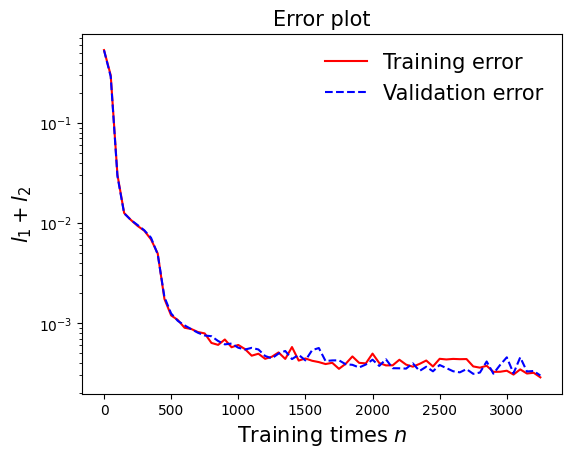

In [140]:
draw_loss(model9)

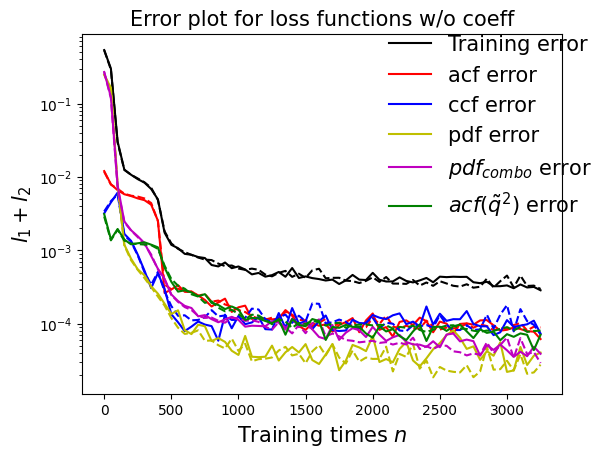

In [141]:
draw_errors(model9)

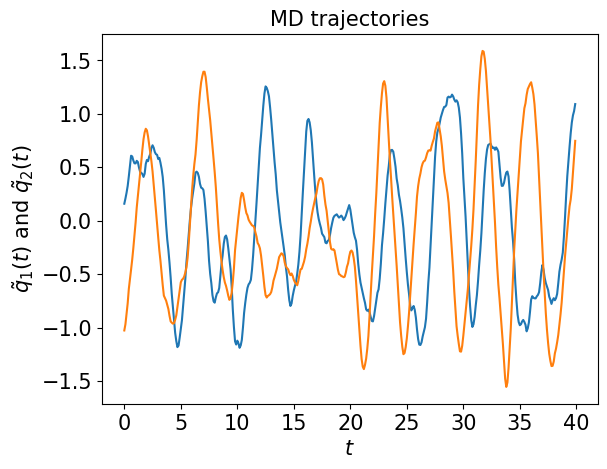

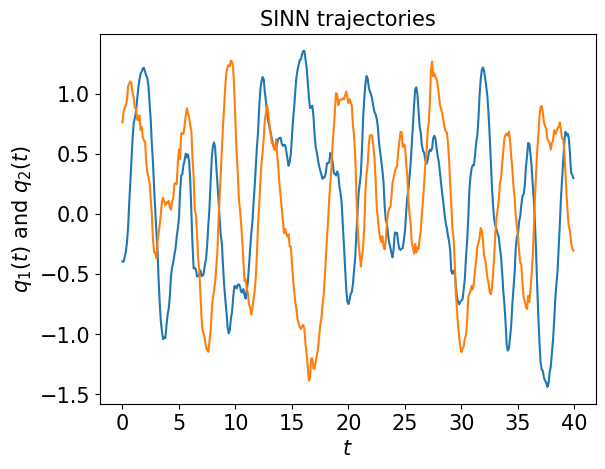

In [142]:
test1(model9)

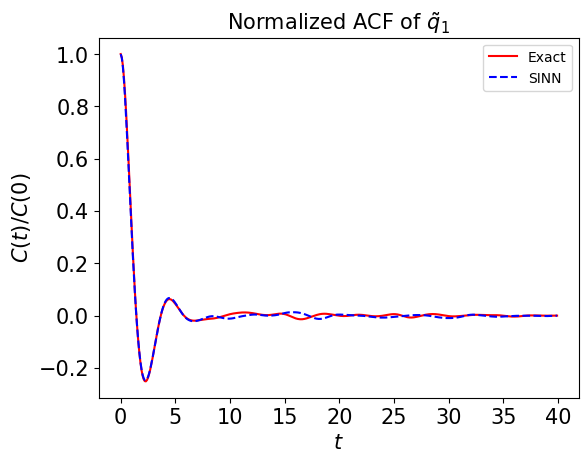

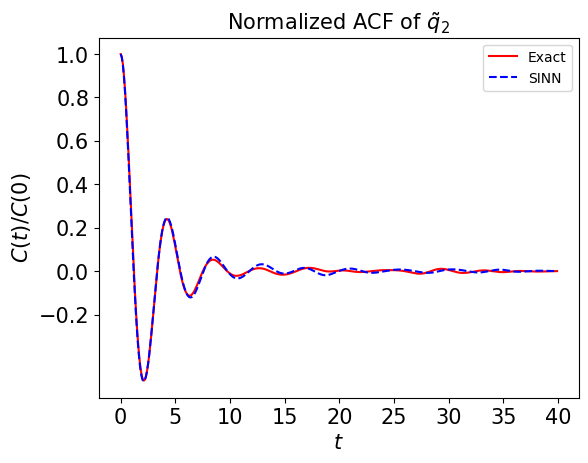

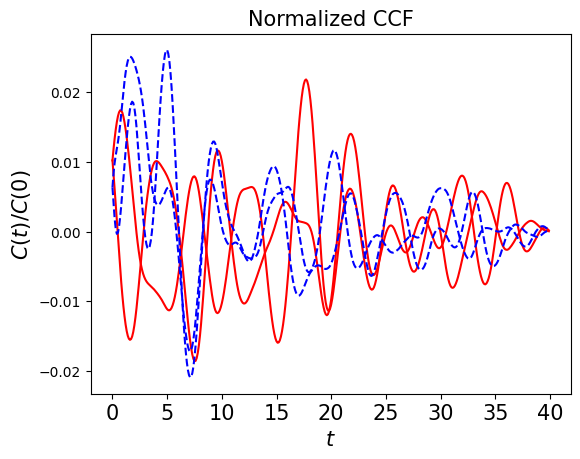

In [143]:
test2(model9)

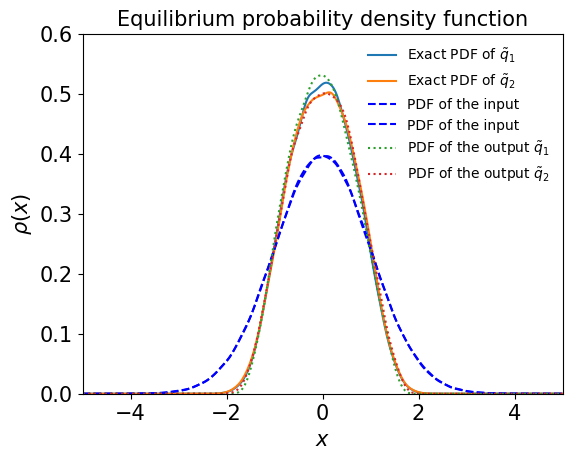

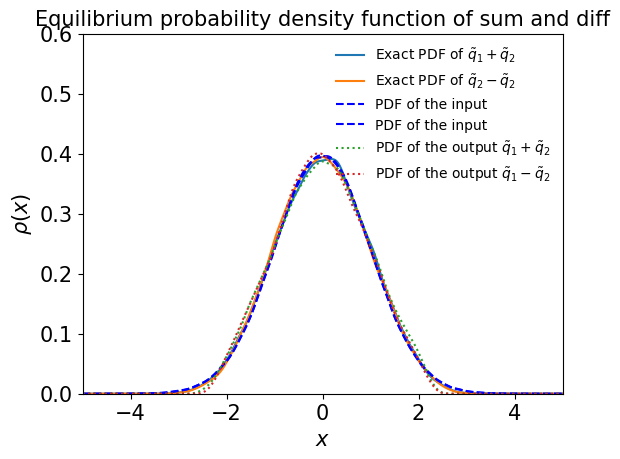

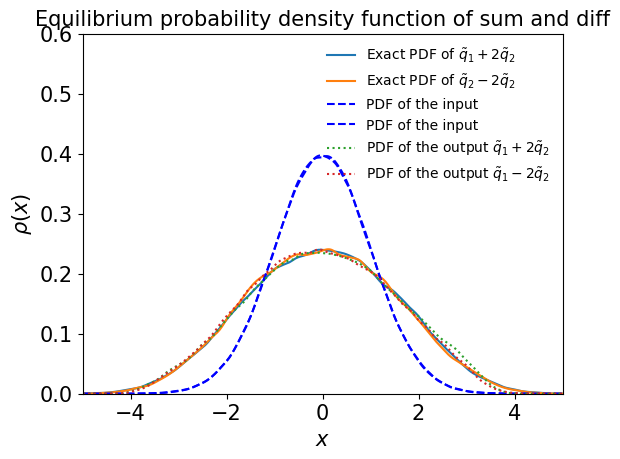

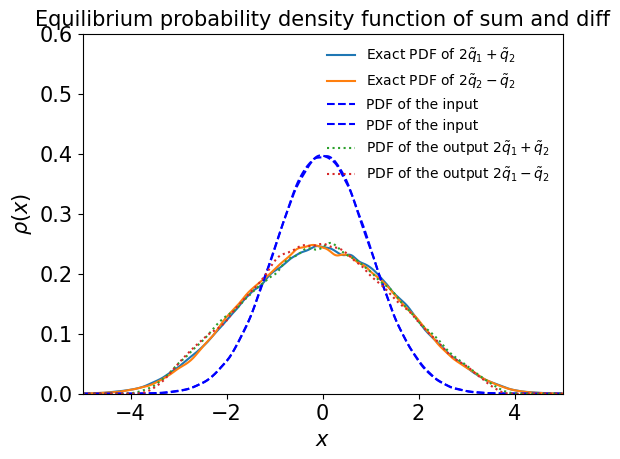

In [144]:
test3(model9)

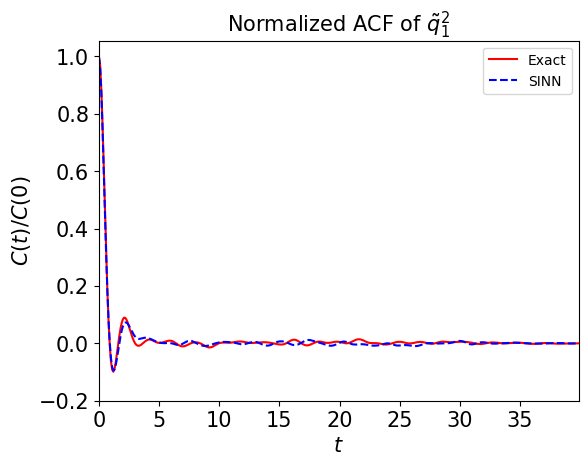

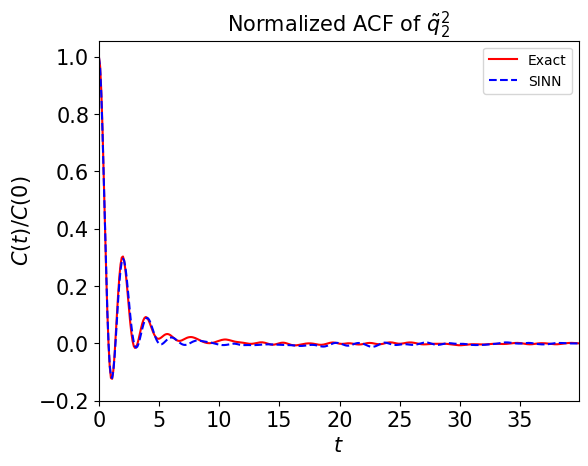

In [145]:
test4(model9)

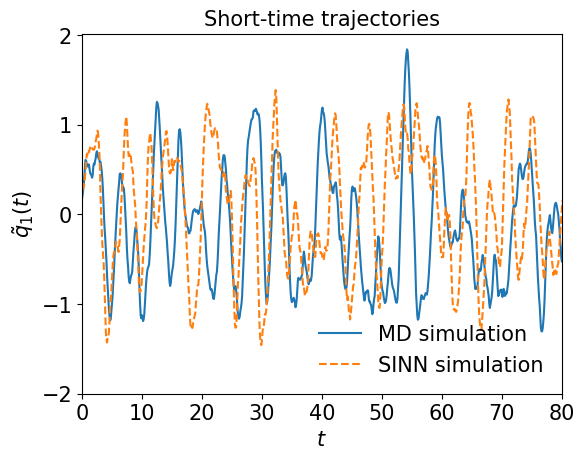

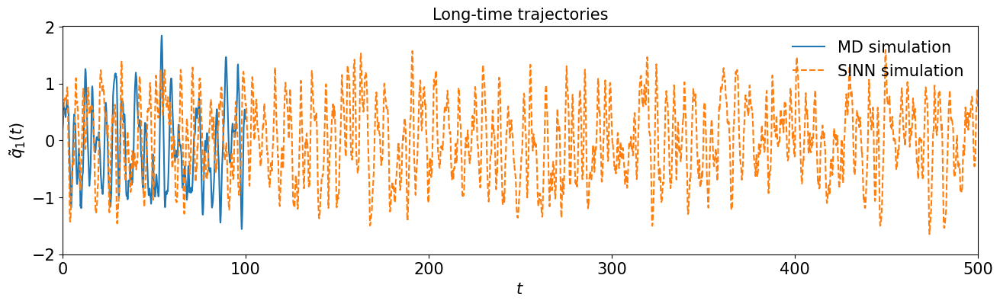

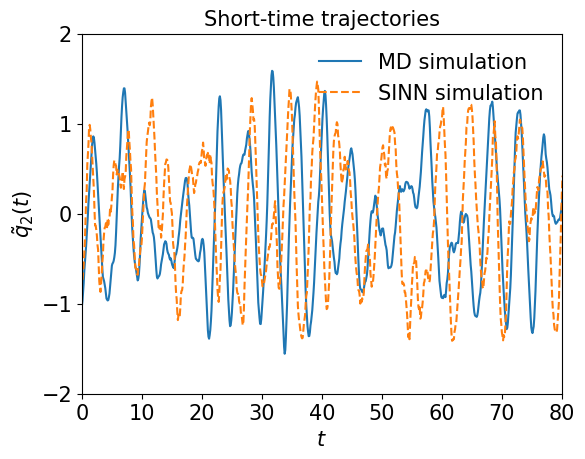

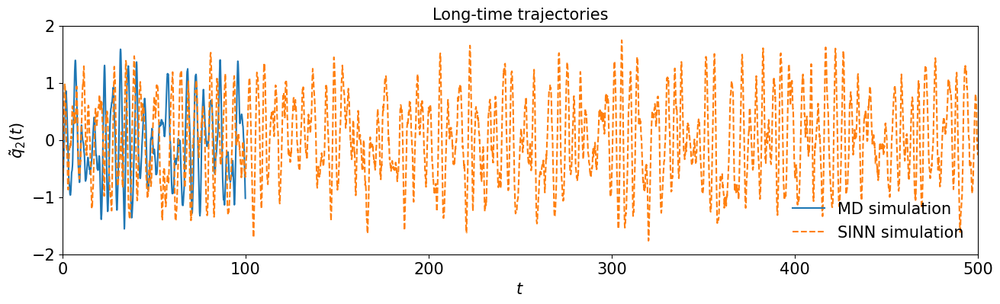

In [146]:
test5(model9)

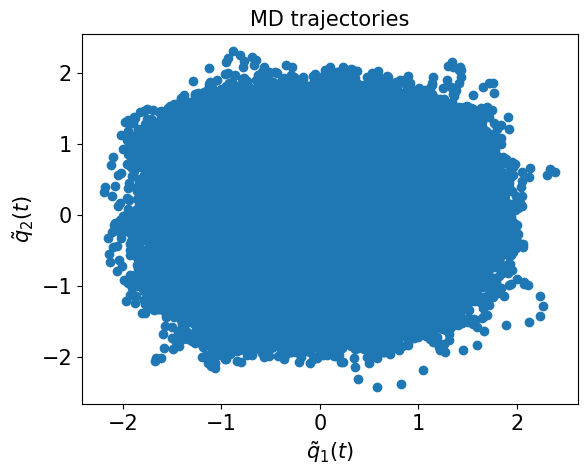

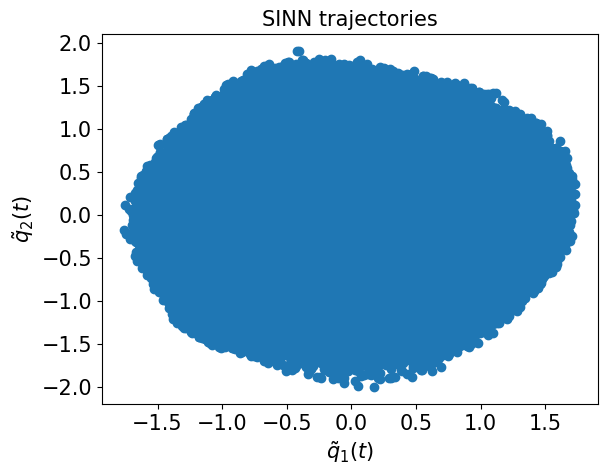

In [147]:
test6(model9)

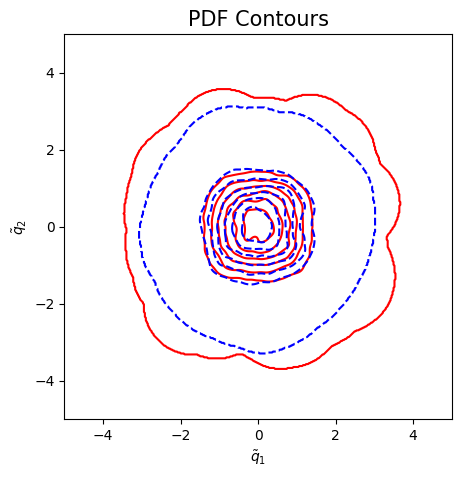

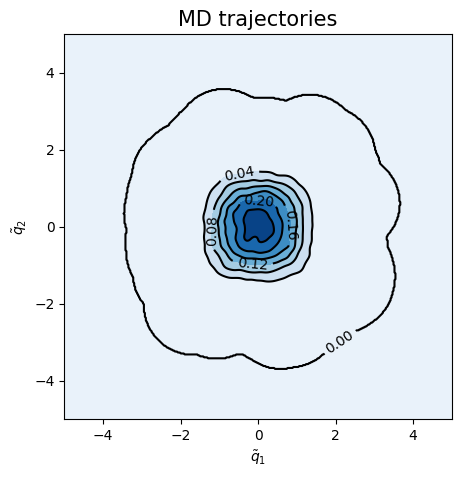

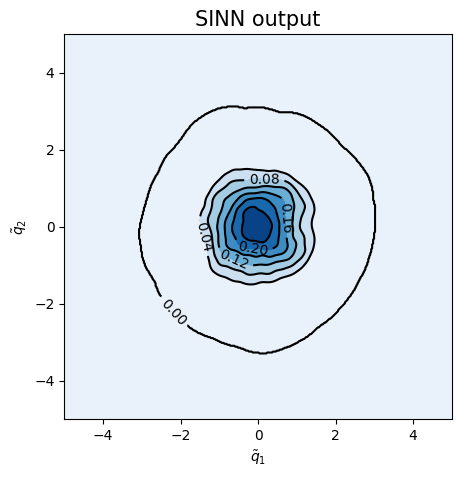

<Figure size 500x500 with 0 Axes>

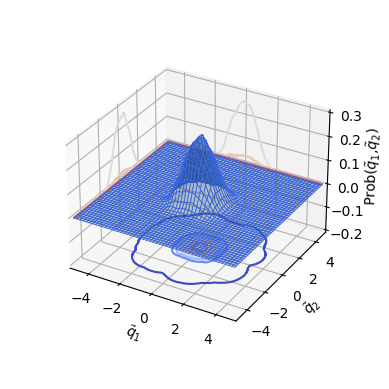

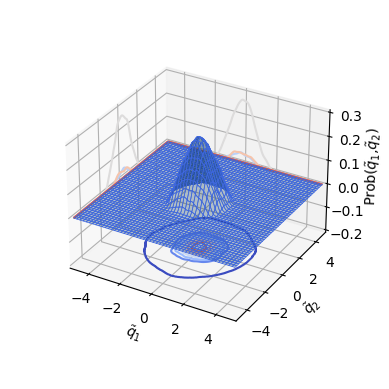

In [148]:
test7(model9)

In [149]:
### Defining SINN model
net10 = SINN(2, 10, 2, 2).to(device)

In [150]:
model10 = Model(net=net10)

In [151]:
model10.train()

[0]-th step loss: 0.5374, 0.5360, acf: 0.01379, ccf: 0.00127, pdf: 0.24804, pdf2: 0.26866, acf2: 0.00422
[50]-th step loss: 0.2369, 0.2260, acf: 0.00710, ccf: 0.00878, pdf: 0.12105, pdf2: 0.08744, acf2: 0.00162
[100]-th step loss: 0.0603, 0.0594, acf: 0.00826, ccf: 0.01584, pdf: 0.00906, pdf2: 0.02484, acf2: 0.00145
[150]-th step loss: 0.0363, 0.0356, acf: 0.00596, ccf: 0.01061, pdf: 0.00498, pdf2: 0.01269, acf2: 0.00133
[200]-th step loss: 0.0141, 0.0141, acf: 0.00714, ccf: 0.00152, pdf: 0.00190, pdf2: 0.00233, acf2: 0.00121
[250]-th step loss: 0.0105, 0.0107, acf: 0.00574, ccf: 0.00128, pdf: 0.00093, pdf2: 0.00156, acf2: 0.00118
[300]-th step loss: 0.0089, 0.0088, acf: 0.00498, ccf: 0.00087, pdf: 0.00055, pdf2: 0.00122, acf2: 0.00119
[350]-th step loss: 0.0070, 0.0072, acf: 0.00362, ccf: 0.00101, pdf: 0.00044, pdf2: 0.00097, acf2: 0.00115
[400]-th step loss: 0.0058, 0.0058, acf: 0.00235, ccf: 0.00121, pdf: 0.00039, pdf2: 0.00078, acf2: 0.00105
[450]-th step loss: 0.0047, 0.0047, acf:

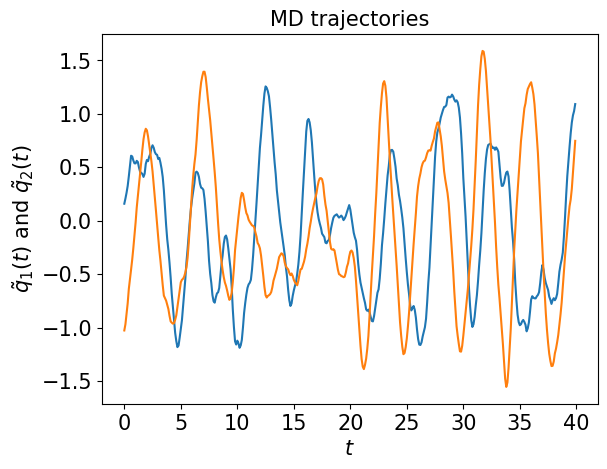

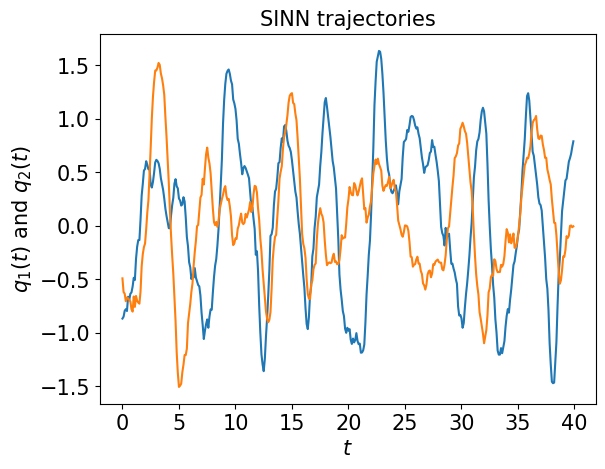

In [152]:
test1(model10)

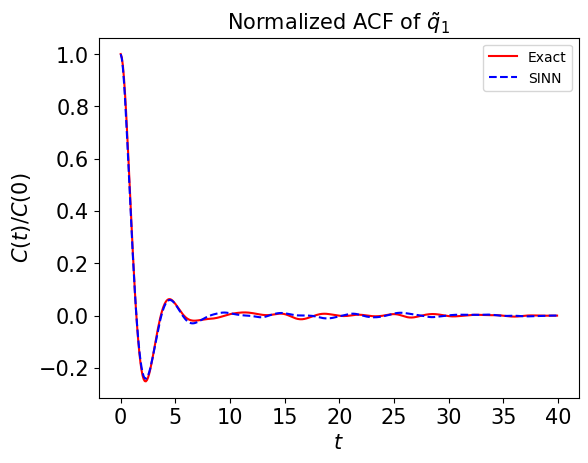

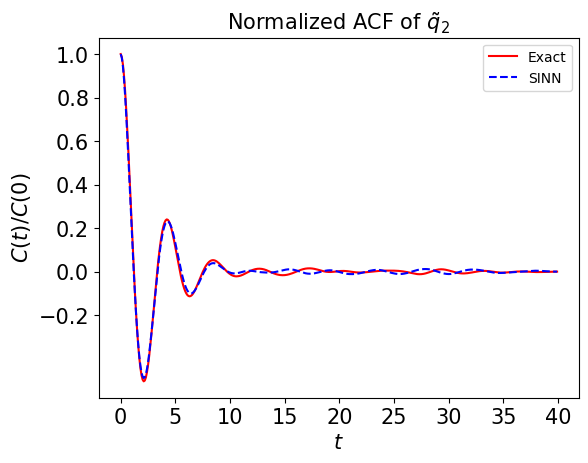

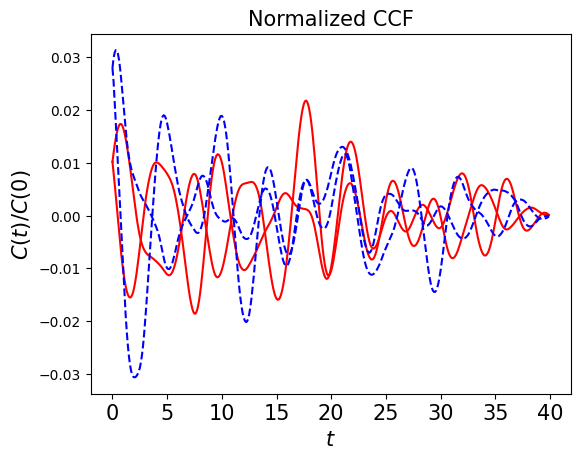

In [153]:
test2(model10)

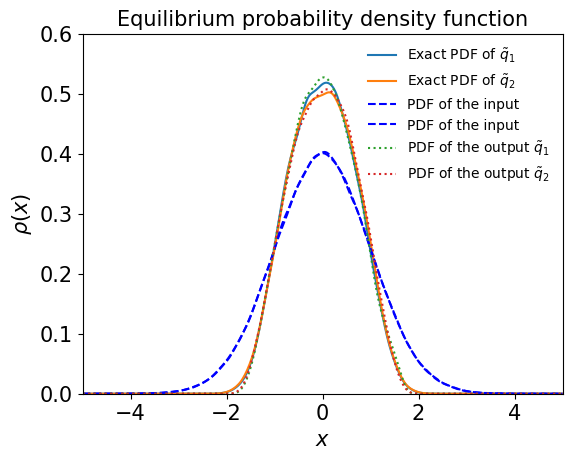

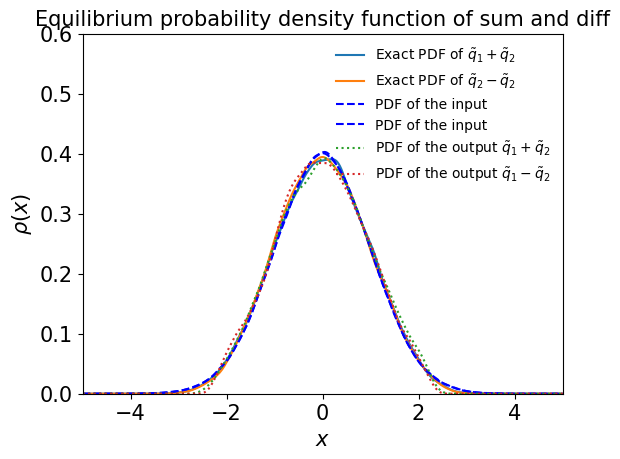

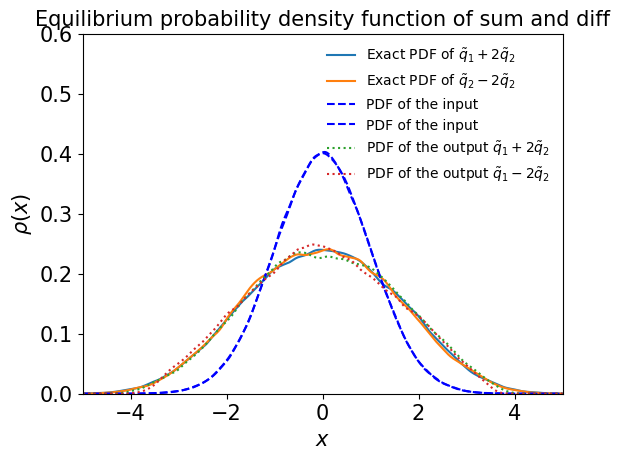

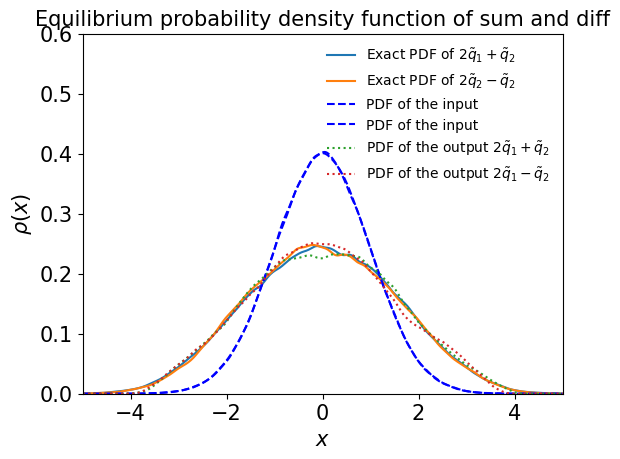

In [154]:
test3(model10)

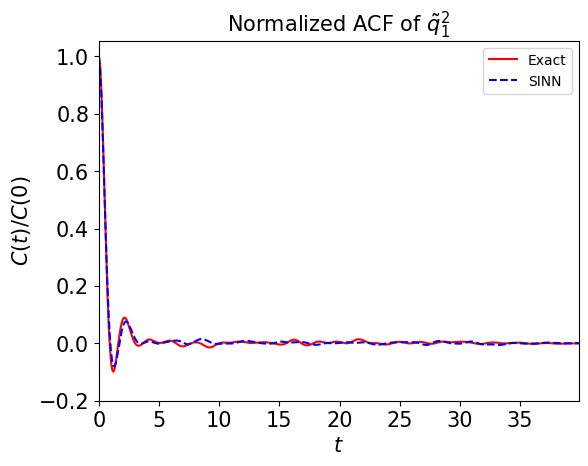

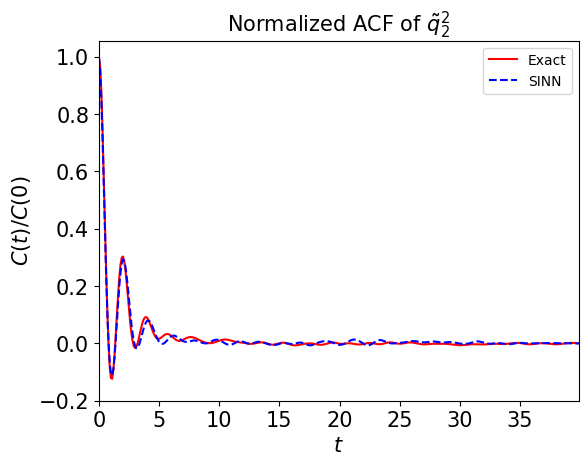

In [155]:
test4(model10)

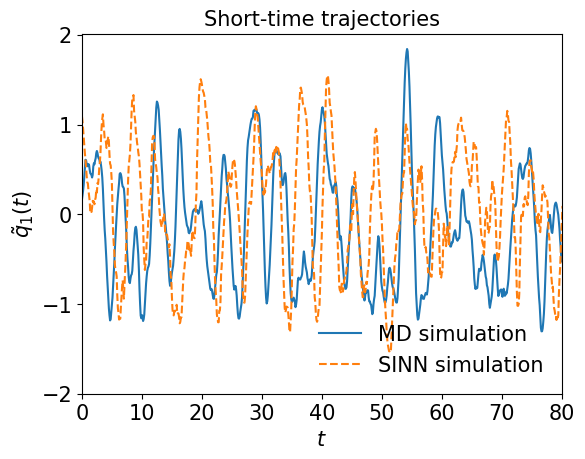

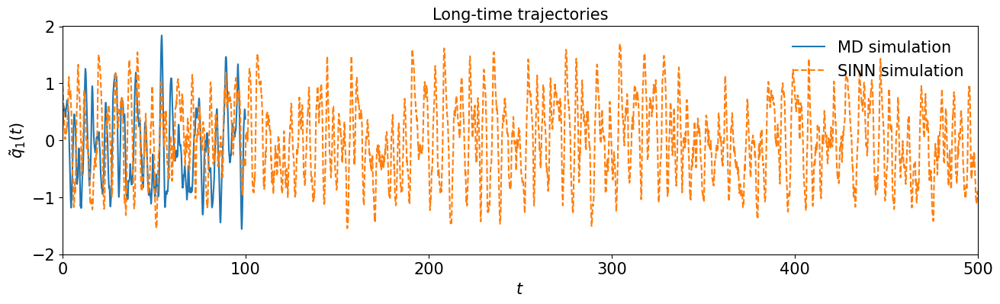

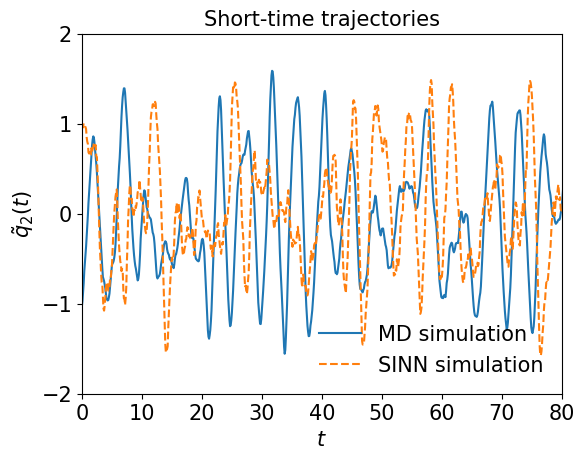

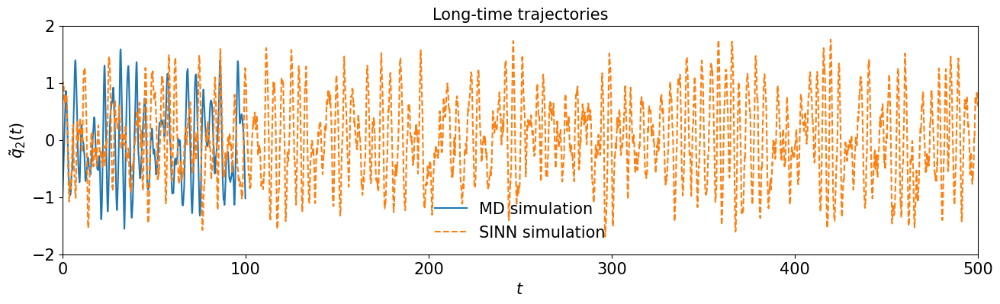

In [156]:
test5(model10)

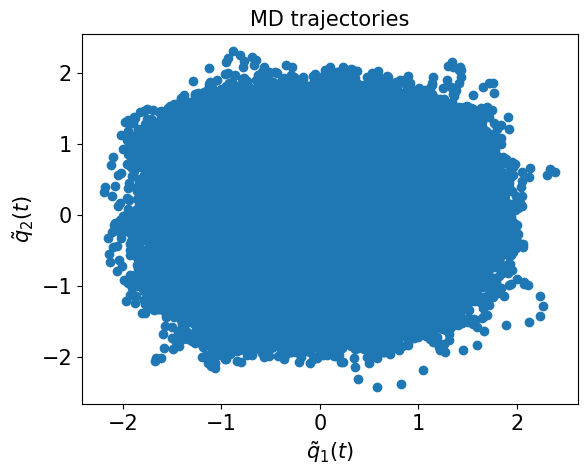

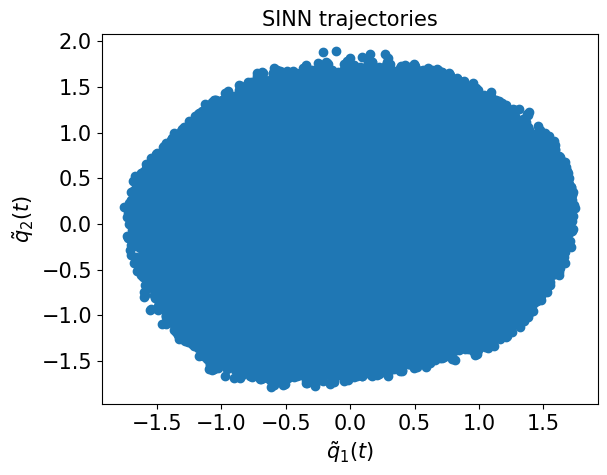

In [157]:
test6(model10)

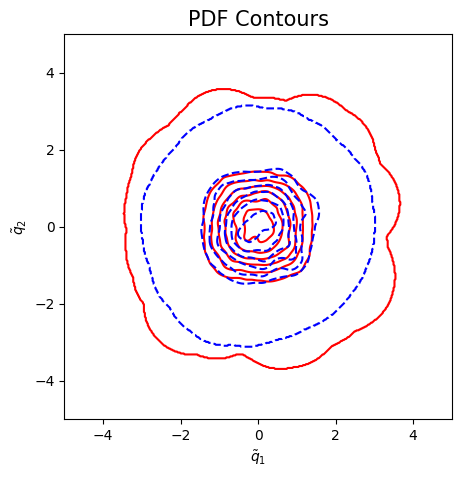

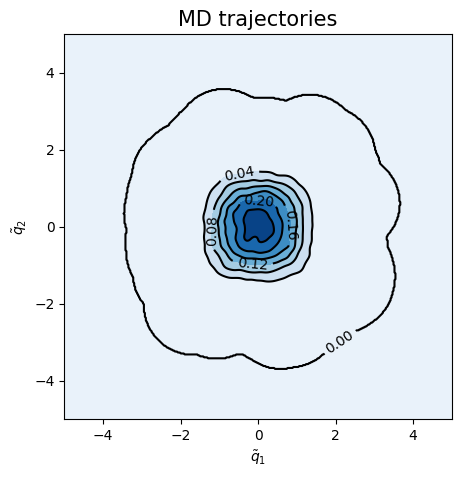

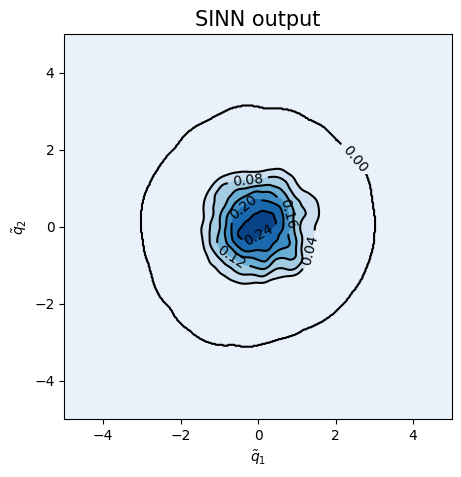

<Figure size 500x500 with 0 Axes>

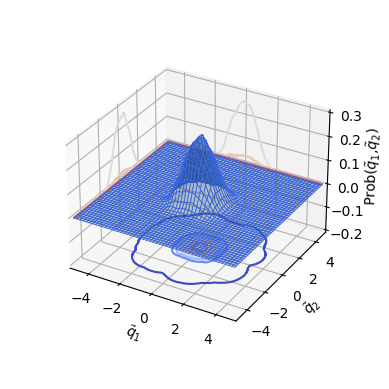

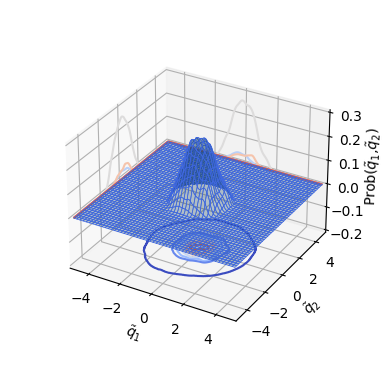

In [158]:
test7(model10)

In [159]:
### Defining SINN model
net11 = SINN(2, 10, 2, 2).to(device)
model11 = Model(net=net11)

In [160]:
model11.train()

[0]-th step loss: 0.5244, 0.5232, acf: 0.00877, ccf: 0.00260, pdf: 0.24510, pdf2: 0.26517, acf2: 0.00154
[50]-th step loss: 0.1930, 0.1847, acf: 0.00704, ccf: 0.00537, pdf: 0.10567, pdf2: 0.06510, acf2: 0.00157
[100]-th step loss: 0.0280, 0.0277, acf: 0.01006, ccf: 0.00155, pdf: 0.00894, pdf2: 0.00487, acf2: 0.00228
[150]-th step loss: 0.0154, 0.0152, acf: 0.00809, ccf: 0.00039, pdf: 0.00300, pdf2: 0.00234, acf2: 0.00139
[200]-th step loss: 0.0113, 0.0117, acf: 0.00676, ccf: 0.00037, pdf: 0.00157, pdf2: 0.00180, acf2: 0.00123
[250]-th step loss: 0.0099, 0.0102, acf: 0.00620, ccf: 0.00030, pdf: 0.00097, pdf2: 0.00152, acf2: 0.00121
[300]-th step loss: 0.0092, 0.0093, acf: 0.00583, ccf: 0.00024, pdf: 0.00069, pdf2: 0.00134, acf2: 0.00122
[350]-th step loss: 0.0084, 0.0086, acf: 0.00541, ccf: 0.00027, pdf: 0.00055, pdf2: 0.00119, acf2: 0.00121
[400]-th step loss: 0.0077, 0.0079, acf: 0.00486, ccf: 0.00036, pdf: 0.00046, pdf2: 0.00104, acf2: 0.00119
[450]-th step loss: 0.0065, 0.0067, acf:

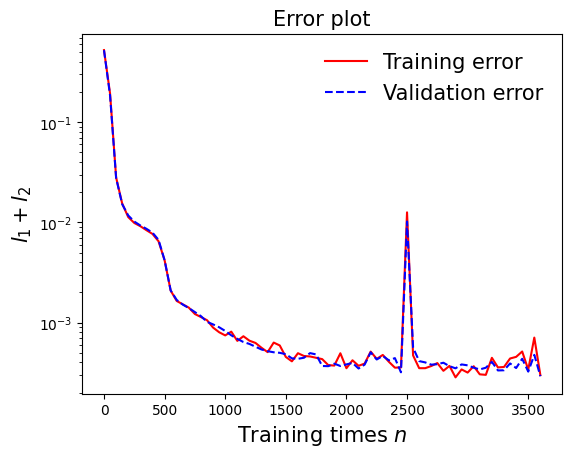

In [161]:
draw_loss(model11)

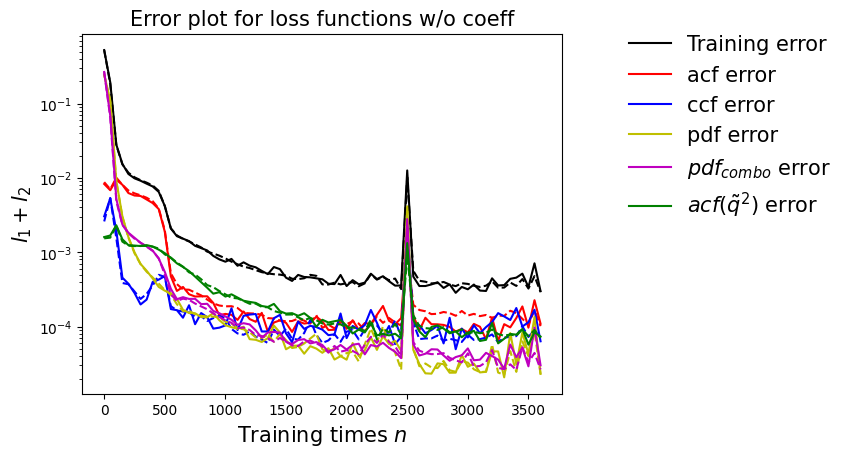

In [162]:
draw_errors(model11)

In [163]:
### Defining SINN model
net12 = SINN(2, 10, 2, 2).to(device)
model12 = Model(net=net12)
model12.train()

[0]-th step loss: 0.5409, 0.5397, acf: 0.01329, ccf: 0.00188, pdf: 0.24827, pdf2: 0.27235, acf2: 0.00391
[50]-th step loss: 0.2939, 0.2823, acf: 0.00692, ccf: 0.00793, pdf: 0.15129, pdf2: 0.11455, acf2: 0.00164
[100]-th step loss: 0.0595, 0.0584, acf: 0.00852, ccf: 0.01503, pdf: 0.01114, pdf2: 0.02225, acf2: 0.00145
[150]-th step loss: 0.0157, 0.0156, acf: 0.00544, ccf: 0.00268, pdf: 0.00259, pdf2: 0.00345, acf2: 0.00144
[200]-th step loss: 0.0100, 0.0103, acf: 0.00374, ccf: 0.00229, pdf: 0.00103, pdf2: 0.00217, acf2: 0.00106
[250]-th step loss: 0.0074, 0.0073, acf: 0.00275, ccf: 0.00155, pdf: 0.00060, pdf2: 0.00150, acf2: 0.00092
[300]-th step loss: 0.0041, 0.0041, acf: 0.00131, ccf: 0.00075, pdf: 0.00040, pdf2: 0.00092, acf2: 0.00071
[350]-th step loss: 0.0021, 0.0021, acf: 0.00041, ccf: 0.00027, pdf: 0.00024, pdf2: 0.00066, acf2: 0.00048
[400]-th step loss: 0.0017, 0.0017, acf: 0.00032, ccf: 0.00021, pdf: 0.00020, pdf2: 0.00055, acf2: 0.00037
[450]-th step loss: 0.0016, 0.0015, acf:

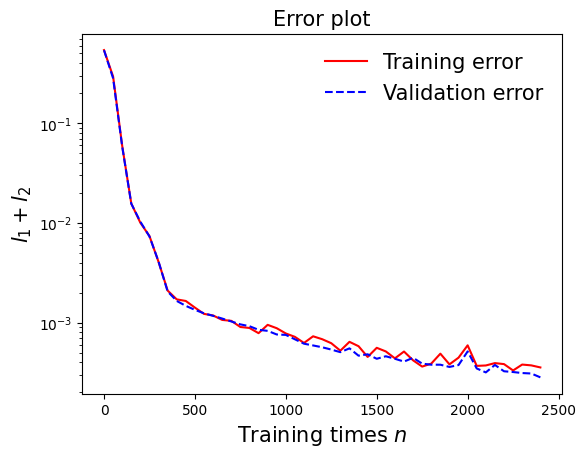

In [164]:
draw_loss(model12)

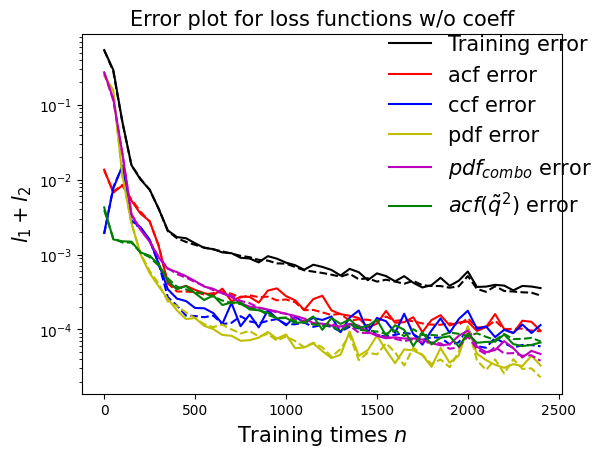

In [165]:
draw_errors(model12)

In [166]:
### Defining SINN model
net13 = SINN(2, 10, 2, 2).to(device)
model13 = Model(net=net13)
model13.train()

[0]-th step loss: 0.5332, 0.5320, acf: 0.01342, ccf: 0.00418, pdf: 0.24641, pdf2: 0.26419, acf2: 0.00382
[50]-th step loss: 0.2341, 0.2234, acf: 0.00806, ccf: 0.00654, pdf: 0.12937, pdf2: 0.07693, acf2: 0.00253
[100]-th step loss: 0.0556, 0.0545, acf: 0.00635, ccf: 0.01013, pdf: 0.01877, pdf2: 0.01718, acf2: 0.00209
[150]-th step loss: 0.0248, 0.0245, acf: 0.00431, ccf: 0.00761, pdf: 0.00394, pdf2: 0.00718, acf2: 0.00141
[200]-th step loss: 0.0184, 0.0183, acf: 0.00296, ccf: 0.00979, pdf: 0.00161, pdf2: 0.00301, acf2: 0.00097
[250]-th step loss: 0.0164, 0.0165, acf: 0.00327, ccf: 0.00927, pdf: 0.00091, pdf2: 0.00210, acf2: 0.00094
[300]-th step loss: 0.0153, 0.0155, acf: 0.00338, ccf: 0.00890, pdf: 0.00067, pdf2: 0.00159, acf2: 0.00092
[350]-th step loss: 0.0145, 0.0144, acf: 0.00331, ccf: 0.00835, pdf: 0.00045, pdf2: 0.00140, acf2: 0.00091
[400]-th step loss: 0.0132, 0.0131, acf: 0.00320, ccf: 0.00748, pdf: 0.00032, pdf2: 0.00123, acf2: 0.00092
[450]-th step loss: 0.0125, 0.0124, acf:

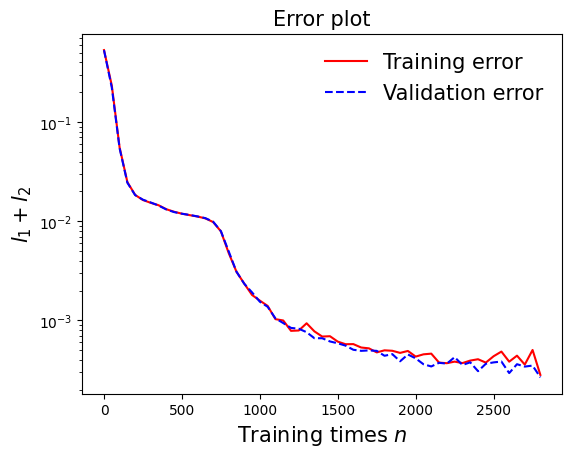

In [167]:
draw_loss(model13)

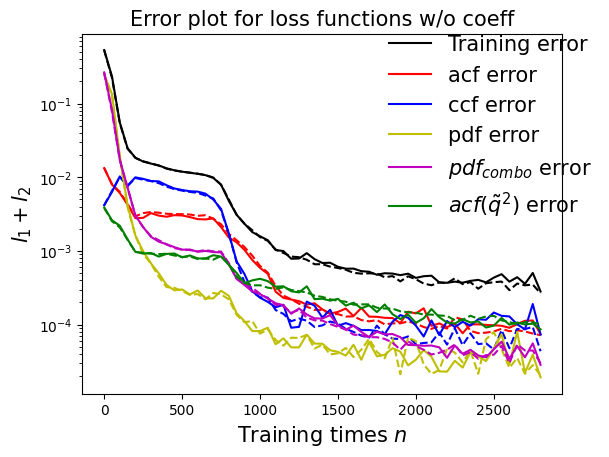

In [168]:
draw_errors(model13)

In [169]:
### Defining SINN model
net14 = SINN(2, 10, 2, 2).to(device)
model14 = Model(net=net14)
model14.train()

[0]-th step loss: 0.5330, 0.5311, acf: 0.01171, ccf: 0.00474, pdf: 0.24546, pdf2: 0.26625, acf2: 0.00294
[50]-th step loss: 0.1781, 0.1708, acf: 0.00692, ccf: 0.01307, pdf: 0.06532, pdf2: 0.08404, acf2: 0.00150
[100]-th step loss: 0.0619, 0.0618, acf: 0.00693, ccf: 0.01518, pdf: 0.00886, pdf2: 0.02952, acf2: 0.00128
[150]-th step loss: 0.0378, 0.0374, acf: 0.00402, ccf: 0.01208, pdf: 0.00358, pdf2: 0.01635, acf2: 0.00142
[200]-th step loss: 0.0271, 0.0272, acf: 0.00223, ccf: 0.01240, pdf: 0.00235, pdf2: 0.00910, acf2: 0.00110
[250]-th step loss: 0.0236, 0.0234, acf: 0.00251, ccf: 0.01136, pdf: 0.00186, pdf2: 0.00663, acf2: 0.00108
[300]-th step loss: 0.0200, 0.0201, acf: 0.00275, ccf: 0.01059, pdf: 0.00145, pdf2: 0.00429, acf2: 0.00101
[350]-th step loss: 0.0166, 0.0167, acf: 0.00296, ccf: 0.00921, pdf: 0.00115, pdf2: 0.00240, acf2: 0.00097
[400]-th step loss: 0.0115, 0.0114, acf: 0.00208, ccf: 0.00610, pdf: 0.00099, pdf2: 0.00125, acf2: 0.00093
[450]-th step loss: 0.0064, 0.0063, acf:

[3850]-th step loss: 0.0017, 0.0019, acf: 0.00109, ccf: 0.00029, pdf: 0.00007, pdf2: 0.00013, acf2: 0.00032
[3900]-th step loss: 0.0017, 0.0019, acf: 0.00108, ccf: 0.00027, pdf: 0.00007, pdf2: 0.00012, acf2: 0.00031
[3950]-th step loss: 0.0018, 0.0018, acf: 0.00107, ccf: 0.00025, pdf: 0.00007, pdf2: 0.00012, acf2: 0.00031
[4000]-th step loss: 0.0016, 0.0018, acf: 0.00105, ccf: 0.00024, pdf: 0.00007, pdf2: 0.00011, acf2: 0.00030
[4050]-th step loss: 0.0016, 0.0017, acf: 0.00104, ccf: 0.00022, pdf: 0.00006, pdf2: 0.00011, acf2: 0.00030
[4100]-th step loss: 0.0016, 0.0017, acf: 0.00102, ccf: 0.00023, pdf: 0.00007, pdf2: 0.00010, acf2: 0.00030
[4150]-th step loss: 0.0016, 0.0017, acf: 0.00102, ccf: 0.00020, pdf: 0.00006, pdf2: 0.00010, acf2: 0.00030
[4200]-th step loss: 0.0016, 0.0016, acf: 0.00100, ccf: 0.00019, pdf: 0.00006, pdf2: 0.00009, acf2: 0.00029
[4250]-th step loss: 0.0016, 0.0016, acf: 0.00098, ccf: 0.00018, pdf: 0.00006, pdf2: 0.00009, acf2: 0.00029
[4300]-th step loss: 0.0015,

[7650]-th step loss: 0.0004, 0.0004, acf: 0.00012, ccf: 0.00009, pdf: 0.00004, pdf2: 0.00003, acf2: 0.00013
[7700]-th step loss: 0.0004, 0.0004, acf: 0.00010, ccf: 0.00009, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00013
[7750]-th step loss: 0.0003, 0.0004, acf: 0.00010, ccf: 0.00009, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00013
[7800]-th step loss: 0.0003, 0.0003, acf: 0.00009, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00012
[7850]-th step loss: 0.0003, 0.0004, acf: 0.00011, ccf: 0.00009, pdf: 0.00004, pdf2: 0.00003, acf2: 0.00013
[7900]-th step loss: 0.0005, 0.0003, acf: 0.00009, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00011
[7950]-th step loss: 0.0004, 0.0004, acf: 0.00010, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00011
[8000]-th step loss: 0.0004, 0.0004, acf: 0.00010, ccf: 0.00009, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00011
[8050]-th step loss: 0.0003, 0.0003, acf: 0.00010, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00003, acf2: 0.00011
[8100]-th step loss: 0.0003,

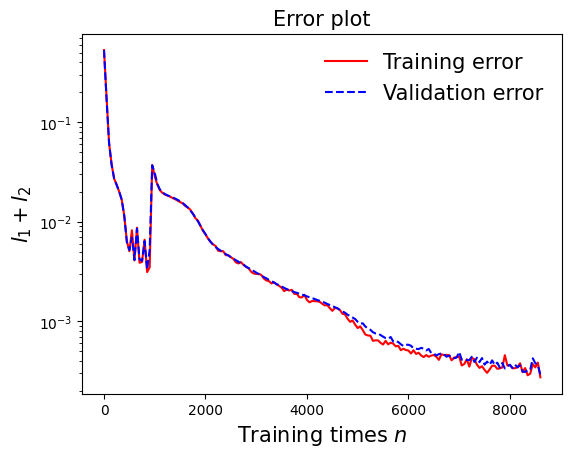

In [170]:
draw_loss(model14)

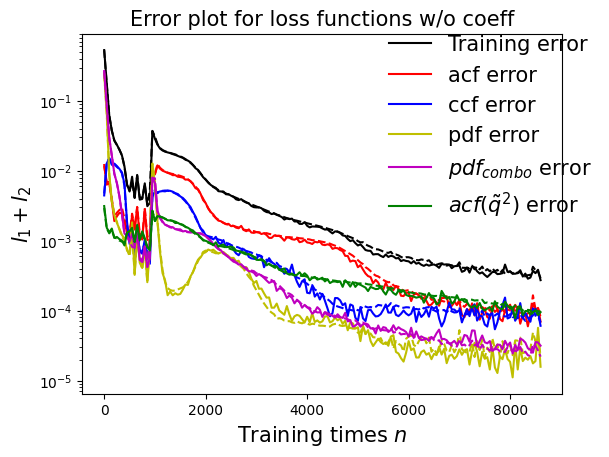

In [171]:
draw_errors(model14)

In [172]:
### Defining SINN model
net15 = SINN(2, 10, 2, 2).to(device)
model15 = Model(net=net15)
model15.train()

[0]-th step loss: 0.5398, 0.5387, acf: 0.01121, ccf: 0.00099, pdf: 0.24969, pdf2: 0.27428, acf2: 0.00257
[50]-th step loss: 0.4193, 0.4081, acf: 0.00713, ccf: 0.00008, pdf: 0.21588, pdf2: 0.18364, acf2: 0.00141
[100]-th step loss: 0.0662, 0.0644, acf: 0.00906, ccf: 0.00541, pdf: 0.03445, pdf2: 0.01265, acf2: 0.00284
[150]-th step loss: 0.0232, 0.0223, acf: 0.00567, ccf: 0.00433, pdf: 0.00584, pdf2: 0.00498, acf2: 0.00146
[200]-th step loss: 0.0157, 0.0160, acf: 0.00430, ccf: 0.00426, pdf: 0.00292, pdf2: 0.00344, acf2: 0.00111
[250]-th step loss: 0.0126, 0.0127, acf: 0.00432, ccf: 0.00313, pdf: 0.00175, pdf2: 0.00246, acf2: 0.00107
[300]-th step loss: 0.0092, 0.0094, acf: 0.00377, ccf: 0.00190, pdf: 0.00112, pdf2: 0.00159, acf2: 0.00106
[350]-th step loss: 0.0052, 0.0054, acf: 0.00193, ccf: 0.00087, pdf: 0.00065, pdf2: 0.00104, acf2: 0.00087
[400]-th step loss: 0.0033, 0.0034, acf: 0.00141, ccf: 0.00027, pdf: 0.00038, pdf2: 0.00069, acf2: 0.00066
[450]-th step loss: 0.0025, 0.0026, acf:

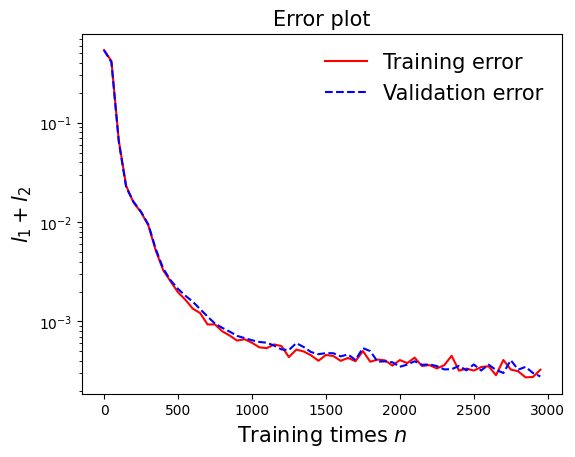

In [173]:
draw_loss(model15)

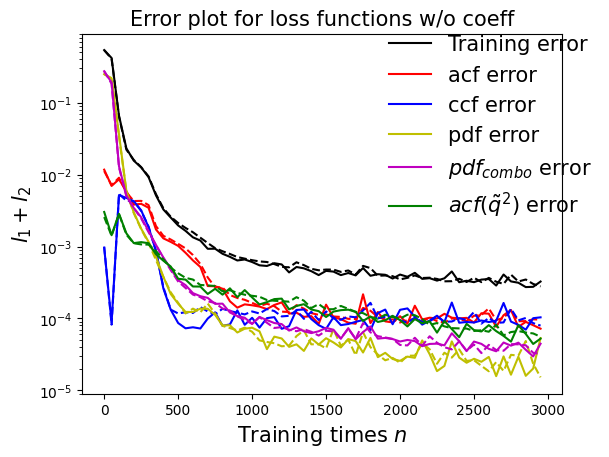

In [174]:
draw_errors(model15)


In [175]:
### Defining SINN model
net16 = SINN(2, 10, 2, 2).to(device)
model16 = Model(net=net16)
model16.train()

[0]-th step loss: 0.5304, 0.5300, acf: 0.00953, ccf: 0.00040, pdf: 0.24661, pdf2: 0.27170, acf2: 0.00176
[50]-th step loss: 0.3414, 0.3304, acf: 0.00715, ccf: 0.00023, pdf: 0.18425, pdf2: 0.13738, acf2: 0.00140
[100]-th step loss: 0.0320, 0.0316, acf: 0.01407, ccf: 0.00011, pdf: 0.00933, pdf2: 0.00517, acf2: 0.00291
[150]-th step loss: 0.0153, 0.0150, acf: 0.00803, ccf: 0.00011, pdf: 0.00297, pdf2: 0.00241, acf2: 0.00143
[200]-th step loss: 0.0091, 0.0093, acf: 0.00523, ccf: 0.00017, pdf: 0.00120, pdf2: 0.00152, acf2: 0.00113
[250]-th step loss: 0.0070, 0.0069, acf: 0.00362, ccf: 0.00046, pdf: 0.00057, pdf2: 0.00121, acf2: 0.00102
[300]-th step loss: 0.0045, 0.0047, acf: 0.00150, ccf: 0.00116, pdf: 0.00033, pdf2: 0.00079, acf2: 0.00087
[350]-th step loss: 0.0031, 0.0032, acf: 0.00089, ccf: 0.00075, pdf: 0.00028, pdf2: 0.00055, acf2: 0.00069
[400]-th step loss: 0.0019, 0.0022, acf: 0.00060, ccf: 0.00039, pdf: 0.00026, pdf2: 0.00039, acf2: 0.00052
[450]-th step loss: 0.0013, 0.0015, acf:

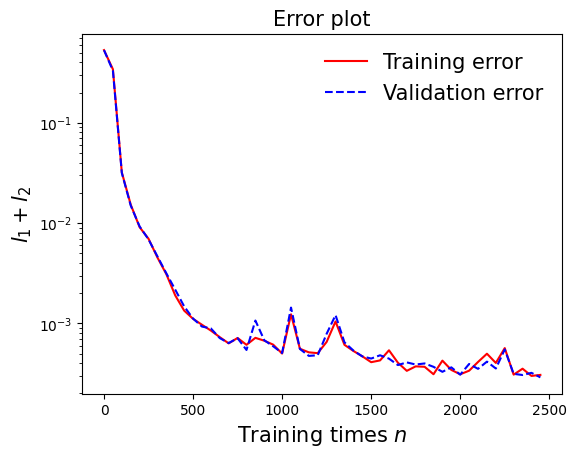

In [176]:
draw_loss(model16)


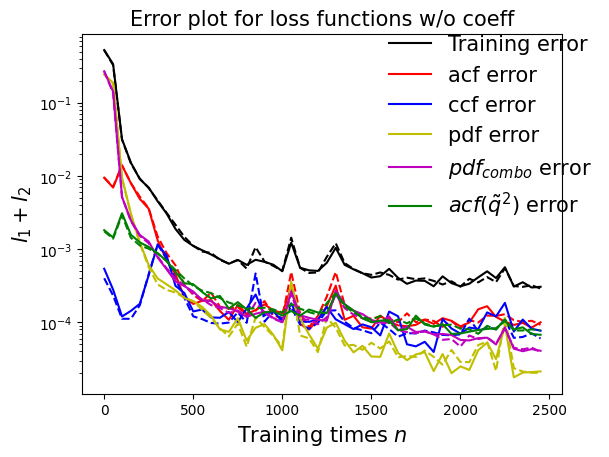

In [177]:
draw_errors(model16)

In [178]:
### Defining SINN model
net17 = SINN(2, 10, 2, 2).to(device)
model17 = Model(net=net17)
model17.train()

[0]-th step loss: 0.5283, 0.5274, acf: 0.00942, ccf: 0.00479, pdf: 0.24594, pdf2: 0.26542, acf2: 0.00184
[50]-th step loss: 0.1824, 0.1740, acf: 0.01098, ccf: 0.01980, pdf: 0.06276, pdf2: 0.07777, acf2: 0.00272
[100]-th step loss: 0.0855, 0.0852, acf: 0.01051, ccf: 0.01980, pdf: 0.01539, pdf2: 0.03809, acf2: 0.00147
[150]-th step loss: 0.0628, 0.0626, acf: 0.00758, ccf: 0.01630, pdf: 0.00766, pdf2: 0.02979, acf2: 0.00125
[200]-th step loss: 0.0482, 0.0479, acf: 0.00577, ccf: 0.01362, pdf: 0.00378, pdf2: 0.02353, acf2: 0.00125
[250]-th step loss: 0.0374, 0.0375, acf: 0.00444, ccf: 0.01236, pdf: 0.00241, pdf2: 0.01694, acf2: 0.00134
[300]-th step loss: 0.0278, 0.0274, acf: 0.00334, ccf: 0.01286, pdf: 0.00190, pdf2: 0.00817, acf2: 0.00108
[350]-th step loss: 0.0209, 0.0208, acf: 0.00312, ccf: 0.01128, pdf: 0.00090, pdf2: 0.00438, acf2: 0.00112
[400]-th step loss: 0.0175, 0.0176, acf: 0.00344, ccf: 0.00973, pdf: 0.00046, pdf2: 0.00272, acf2: 0.00123
[450]-th step loss: 0.0153, 0.0152, acf:

[3850]-th step loss: 0.0003, 0.0004, acf: 0.00011, ccf: 0.00014, pdf: 0.00004, pdf2: 0.00006, acf2: 0.00007
[3900]-th step loss: 0.0004, 0.0004, acf: 0.00010, ccf: 0.00012, pdf: 0.00003, pdf2: 0.00005, acf2: 0.00008
[3950]-th step loss: 0.0004, 0.0004, acf: 0.00011, ccf: 0.00013, pdf: 0.00003, pdf2: 0.00006, acf2: 0.00008
[4000]-th step loss: 0.0004, 0.0004, acf: 0.00010, ccf: 0.00011, pdf: 0.00003, pdf2: 0.00005, acf2: 0.00007
[4050]-th step loss: 0.0004, 0.0004, acf: 0.00009, ccf: 0.00011, pdf: 0.00003, pdf2: 0.00005, acf2: 0.00008
[4100]-th step loss: 0.0003, 0.0004, acf: 0.00010, ccf: 0.00013, pdf: 0.00001, pdf2: 0.00005, acf2: 0.00008
[4150]-th step loss: 0.0005, 0.0004, acf: 0.00013, ccf: 0.00011, pdf: 0.00002, pdf2: 0.00004, acf2: 0.00006
[4200]-th step loss: 0.0004, 0.0003, acf: 0.00009, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00004, acf2: 0.00006
[4250]-th step loss: 0.0003, 0.0003, acf: 0.00009, ccf: 0.00011, pdf: 0.00002, pdf2: 0.00004, acf2: 0.00006
[4300]-th step loss: 0.0004,

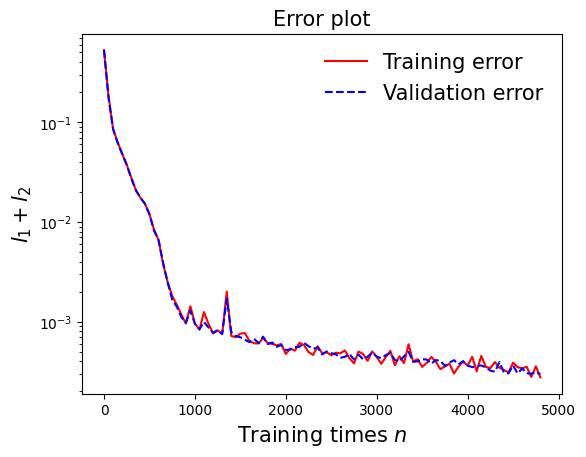

In [179]:
draw_loss(model17)

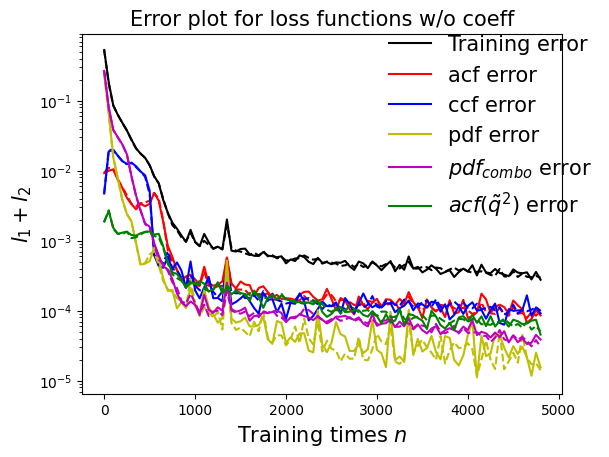

In [180]:
draw_errors(model17)

In [181]:
### Defining SINN model
net18 = SINN(2, 10, 2, 2).to(device)
model18 = Model(net=net18)
model18.train()

[0]-th step loss: 0.5261, 0.5246, acf: 0.00913, ccf: 0.00341, pdf: 0.24571, pdf2: 0.26467, acf2: 0.00171
[50]-th step loss: 0.2266, 0.2149, acf: 0.00678, ccf: 0.00155, pdf: 0.13036, pdf2: 0.07470, acf2: 0.00151
[100]-th step loss: 0.0321, 0.0311, acf: 0.00402, ccf: 0.00710, pdf: 0.01224, pdf2: 0.00609, acf2: 0.00165
[150]-th step loss: 0.0181, 0.0179, acf: 0.00300, ccf: 0.00673, pdf: 0.00379, pdf2: 0.00312, acf2: 0.00126
[200]-th step loss: 0.0147, 0.0147, acf: 0.00354, ccf: 0.00528, pdf: 0.00230, pdf2: 0.00249, acf2: 0.00109
[250]-th step loss: 0.0122, 0.0123, acf: 0.00401, ccf: 0.00378, pdf: 0.00147, pdf2: 0.00201, acf2: 0.00108
[300]-th step loss: 0.0097, 0.0101, acf: 0.00412, ccf: 0.00230, pdf: 0.00090, pdf2: 0.00159, acf2: 0.00115
[350]-th step loss: 0.0073, 0.0074, acf: 0.00340, ccf: 0.00107, pdf: 0.00054, pdf2: 0.00118, acf2: 0.00118
[400]-th step loss: 0.0048, 0.0050, acf: 0.00215, ccf: 0.00039, pdf: 0.00041, pdf2: 0.00092, acf2: 0.00112
[450]-th step loss: 0.0034, 0.0034, acf:

[3850]-th step loss: 0.0003, 0.0003, acf: 0.00008, ccf: 0.00010, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00007
Training finished
Training time: 231.02
Training time per iteration: 0.06
Number of Iterations:3851


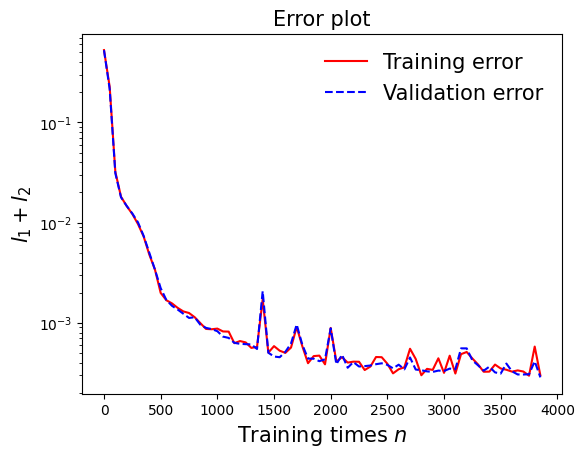

In [182]:
draw_loss(model18)

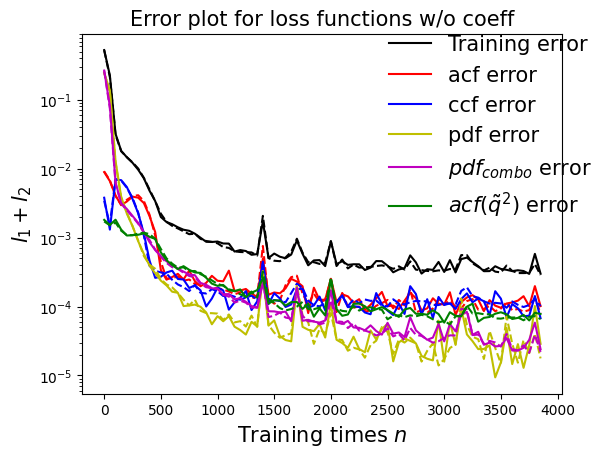

In [183]:
draw_errors(model18)

In [184]:
### Defining SINN model
net19 = SINN(2, 10, 2, 2).to(device)
model19 = Model(net=net19)
model19.train()

[0]-th step loss: 0.5376, 0.5368, acf: 0.01096, ccf: 0.00373, pdf: 0.24801, pdf2: 0.27174, acf2: 0.00236
[50]-th step loss: 0.2386, 0.2316, acf: 0.00692, ccf: 0.01296, pdf: 0.13561, pdf2: 0.07375, acf2: 0.00232
[100]-th step loss: 0.0798, 0.0803, acf: 0.00929, ccf: 0.01802, pdf: 0.02895, pdf2: 0.02129, acf2: 0.00280
[150]-th step loss: 0.0594, 0.0587, acf: 0.00660, ccf: 0.01427, pdf: 0.02006, pdf2: 0.01648, acf2: 0.00131
[200]-th step loss: 0.0443, 0.0441, acf: 0.00427, ccf: 0.01269, pdf: 0.01339, pdf2: 0.01242, acf2: 0.00131
[250]-th step loss: 0.0266, 0.0264, acf: 0.00370, ccf: 0.01288, pdf: 0.00303, pdf2: 0.00542, acf2: 0.00133
[300]-th step loss: 0.0210, 0.0211, acf: 0.00478, ccf: 0.01107, pdf: 0.00092, pdf2: 0.00291, acf2: 0.00141
[350]-th step loss: 0.0185, 0.0186, acf: 0.00526, ccf: 0.01005, pdf: 0.00048, pdf2: 0.00158, acf2: 0.00123
[400]-th step loss: 0.0166, 0.0167, acf: 0.00570, ccf: 0.00897, pdf: 0.00045, pdf2: 0.00069, acf2: 0.00090
[450]-th step loss: 0.0140, 0.0142, acf:

[3850]-th step loss: 0.0151, 0.0151, acf: 0.00388, ccf: 0.00839, pdf: 0.00059, pdf2: 0.00099, acf2: 0.00128
[3900]-th step loss: 0.0150, 0.0150, acf: 0.00385, ccf: 0.00836, pdf: 0.00059, pdf2: 0.00097, acf2: 0.00128
[3950]-th step loss: 0.0147, 0.0150, acf: 0.00384, ccf: 0.00830, pdf: 0.00057, pdf2: 0.00098, acf2: 0.00128
[4000]-th step loss: 0.0147, 0.0149, acf: 0.00382, ccf: 0.00826, pdf: 0.00056, pdf2: 0.00097, acf2: 0.00128
[4050]-th step loss: 0.0147, 0.0148, acf: 0.00382, ccf: 0.00819, pdf: 0.00055, pdf2: 0.00096, acf2: 0.00128
[4100]-th step loss: 0.0146, 0.0147, acf: 0.00380, ccf: 0.00817, pdf: 0.00054, pdf2: 0.00094, acf2: 0.00127
[4150]-th step loss: 0.0147, 0.0147, acf: 0.00380, ccf: 0.00809, pdf: 0.00052, pdf2: 0.00097, acf2: 0.00128
[4200]-th step loss: 0.0144, 0.0146, acf: 0.00377, ccf: 0.00807, pdf: 0.00052, pdf2: 0.00094, acf2: 0.00127
[4250]-th step loss: 0.0144, 0.0145, acf: 0.00376, ccf: 0.00800, pdf: 0.00050, pdf2: 0.00095, acf2: 0.00128
[4300]-th step loss: 0.0142,

[7650]-th step loss: 0.0036, 0.0039, acf: 0.00155, ccf: 0.00103, pdf: 0.00042, pdf2: 0.00041, acf2: 0.00048
[7700]-th step loss: 0.0036, 0.0037, acf: 0.00137, ccf: 0.00107, pdf: 0.00041, pdf2: 0.00038, acf2: 0.00044
[7750]-th step loss: 0.0032, 0.0035, acf: 0.00128, ccf: 0.00097, pdf: 0.00036, pdf2: 0.00039, acf2: 0.00045
[7800]-th step loss: 0.0031, 0.0032, acf: 0.00116, ccf: 0.00094, pdf: 0.00033, pdf2: 0.00037, acf2: 0.00044
[7850]-th step loss: 0.0030, 0.0030, acf: 0.00106, ccf: 0.00089, pdf: 0.00028, pdf2: 0.00037, acf2: 0.00043
[7900]-th step loss: 0.0029, 0.0029, acf: 0.00089, ccf: 0.00098, pdf: 0.00033, pdf2: 0.00031, acf2: 0.00040
[7950]-th step loss: 0.0026, 0.0027, acf: 0.00087, ccf: 0.00080, pdf: 0.00026, pdf2: 0.00031, acf2: 0.00041
[8000]-th step loss: 0.0026, 0.0025, acf: 0.00080, ccf: 0.00075, pdf: 0.00026, pdf2: 0.00028, acf2: 0.00041
[8050]-th step loss: 0.0023, 0.0023, acf: 0.00073, ccf: 0.00069, pdf: 0.00027, pdf2: 0.00025, acf2: 0.00040
[8100]-th step loss: 0.0022,

[11450]-th step loss: 0.0004, 0.0005, acf: 0.00011, ccf: 0.00013, pdf: 0.00004, pdf2: 0.00006, acf2: 0.00016
[11500]-th step loss: 0.0005, 0.0005, acf: 0.00010, ccf: 0.00013, pdf: 0.00002, pdf2: 0.00007, acf2: 0.00015
[11550]-th step loss: 0.0004, 0.0005, acf: 0.00010, ccf: 0.00011, pdf: 0.00003, pdf2: 0.00006, acf2: 0.00017
[11600]-th step loss: 0.0006, 0.0005, acf: 0.00010, ccf: 0.00012, pdf: 0.00004, pdf2: 0.00006, acf2: 0.00015
[11650]-th step loss: 0.0005, 0.0004, acf: 0.00010, ccf: 0.00011, pdf: 0.00002, pdf2: 0.00005, acf2: 0.00015
[11700]-th step loss: 0.0005, 0.0005, acf: 0.00011, ccf: 0.00012, pdf: 0.00003, pdf2: 0.00006, acf2: 0.00017
[11750]-th step loss: 0.0005, 0.0005, acf: 0.00010, ccf: 0.00013, pdf: 0.00002, pdf2: 0.00006, acf2: 0.00016
[11800]-th step loss: 0.0005, 0.0005, acf: 0.00011, ccf: 0.00011, pdf: 0.00004, pdf2: 0.00006, acf2: 0.00016
[11850]-th step loss: 0.0004, 0.0005, acf: 0.00010, ccf: 0.00013, pdf: 0.00003, pdf2: 0.00006, acf2: 0.00014
[11900]-th step los

[15250]-th step loss: 0.0004, 0.0004, acf: 0.00009, ccf: 0.00010, pdf: 0.00003, pdf2: 0.00004, acf2: 0.00010
[15300]-th step loss: 0.0004, 0.0004, acf: 0.00010, ccf: 0.00011, pdf: 0.00002, pdf2: 0.00004, acf2: 0.00010
[15350]-th step loss: 0.0004, 0.0004, acf: 0.00009, ccf: 0.00009, pdf: 0.00004, pdf2: 0.00006, acf2: 0.00010
[15400]-th step loss: 0.0004, 0.0003, acf: 0.00009, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00004, acf2: 0.00009
[15450]-th step loss: 0.0003, 0.0003, acf: 0.00010, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00004, acf2: 0.00008
[15500]-th step loss: 0.0004, 0.0004, acf: 0.00010, ccf: 0.00011, pdf: 0.00005, pdf2: 0.00006, acf2: 0.00011
[15550]-th step loss: 0.0003, 0.0004, acf: 0.00011, ccf: 0.00009, pdf: 0.00006, pdf2: 0.00006, acf2: 0.00011
[15600]-th step loss: 0.0003, 0.0004, acf: 0.00010, ccf: 0.00009, pdf: 0.00007, pdf2: 0.00006, acf2: 0.00009
[15650]-th step loss: 0.0005, 0.0004, acf: 0.00010, ccf: 0.00009, pdf: 0.00004, pdf2: 0.00005, acf2: 0.00009
[15700]-th step los

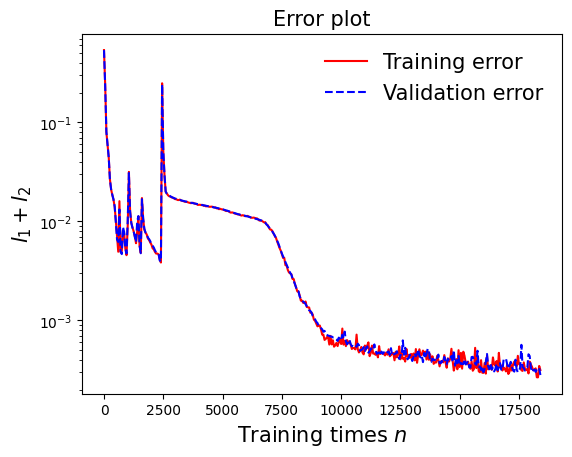

In [185]:
draw_loss(model19)

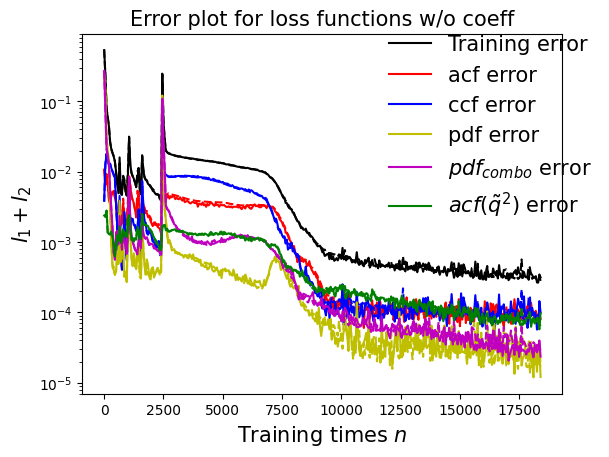

In [186]:
draw_errors(model19)